___


# Image Super Resolution using Super Resolution Neural Network

___ 
## Objective
Implement a Super Resolution Neural Network (SRNN) to enhance the resolution of the various types of images. 

___
## Dataset
We used the DIV2K dataset, which contains a total of 900 high-resolution RGB images (originally separated into 800 training and 100 validation images) with a variety of sizes and contents.

For more details, visit: https://data.vision.ee.ethz.ch/cvl/DIV2K/

___
# Libraries Import

In [1]:
# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

# System characteristics
import psutil
import humanize
import GPUtil as GPU
import torch.backends.cudnn as cudnn

# Computation time monitoring
from time import time

# Data visualization
import matplotlib.pyplot as plt
from IPython.display import clear_output

# Data processing
import os
import math
import shutil
import pandas as pd
import numpy as np
import pydicom
import cv2
from skimage import io
from scipy import ndimage
from torchvision import datasets, transforms
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision.utils import make_grid

# Deep learning
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision.models.vgg import vgg16
from torch.autograd import Variable

___
# System Characteristics

## Check system informations and GPU

In [2]:
# Display local virtual memory (RAM)
print(f'\033[1mRAM Memory:\t\033[0m{humanize.naturalsize(psutil.virtual_memory().available)} (Available)\n')

# Check if GPU is enabled
print(f'\033[1mGPU enabled:\t\033[0m{torch.cuda.is_available()}\n')

# Setting device on GPU ('cuda') if available, if not, the device will be set to CPU ('cpu')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# If device set to GPU ('cuda'), display device information
if device.type == 'cuda':
    # Collect GPU information
    GPUs = GPU.getGPUs()
    gpu = GPUs[0]
    process = psutil.Process(os.getpid())
    print(f'\033[1mDevice Name:\t\033[0m{torch.cuda.get_device_name(0)}')
    print(f'\033[1mMemory Usage:\t\033[0m{torch.cuda.memory_allocated(0)/1024**3:3.1f} GB (Allocated)'
          f'\t{torch.cuda.memory_cached(0)/1024**3:3.1f} GB (Cached)')
    print(f'\033[1mMemory Details:\t\033[0m{gpu.memoryTotal/1000:3.1f} GB '
          f'(Total)\t\t{gpu.memoryUsed/1000:3.1f} GB ({gpu.memoryUtil*100:.0f}% Used) '
          f'\t{gpu.memoryFree/1000:4.1f} GB ({100-gpu.memoryUtil*100:.0f}% Free)')

RAM Memory:	25.8 GB (Available)

GPU enabled:	True

Device Name:	GeForce RTX 2080 Super with Max-Q Design
Memory Usage:	0.0 GB (Allocated)	0.0 GB (Cached)
Memory Details:	8.2 GB (Total)		0.7 GB (8% Used) 	 7.5 GB (92% Free)


___
# Exploratory Data Analysis

## Count total number of images

In [3]:
# Define import path (i.e. where the original HR images are located)
import_path = 'data/complete_dataset/HR'

# Generate list of items contained in import path
file_list = os.listdir(import_path)
        
print(f'\033[1mTotal number of images found:\033[0m {len(file_list)}')

Total number of images found: 900


## Display 5 random images

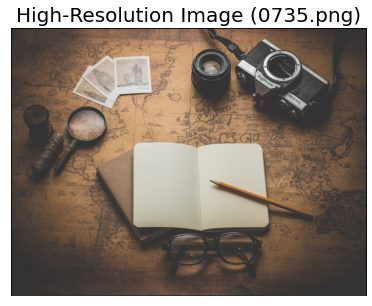

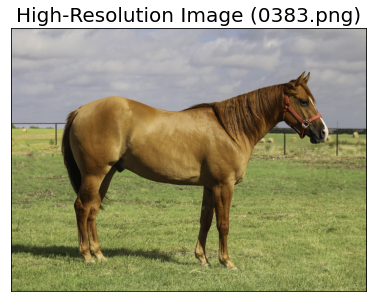

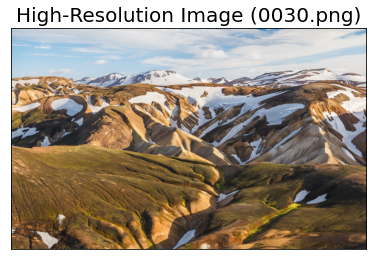

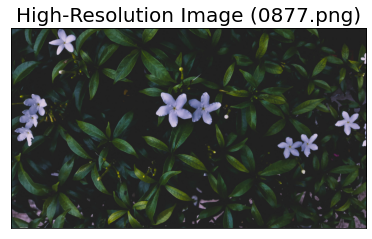

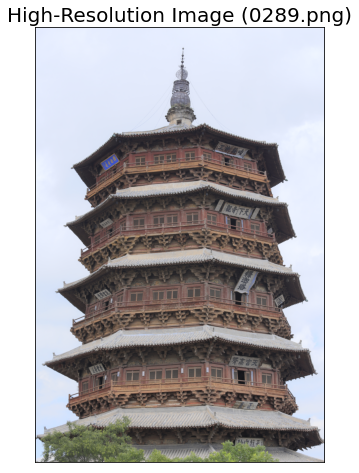

In [11]:
# Define import path (i.e. where the original HR images are located)
import_path = 'data/complete_dataset/HR'

# Generate list of items contained in import path
file_list = os.listdir(import_path)

# Generate random list of indices
rand_ind = np.random.randint(0, len(file_list), 5)

for idx in rand_ind:

    # Define filename
    filename = os.path.join(import_path, file_list[idx])

    # Read image
    img = io.imread(filename)
    
    # Generate figure
    plt.figure(figsize=(14,8))

    # Display high-resolution image
    plt.subplot(121)
    plt.imshow(img)
    plt.title(f'High-Resolution Image ({file_list[idx]})', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)   

___
# Image Processing

In this section, we will:
1. Visualize the effect of adding Gaussian noise to the original images
2. Visualize the effect of downsampling the original images for different downsampling formats (128x128, 64x64, 32x32)
3. Visualize the combined effects of adding Gaussian noise and downsampling the original images for different downsampling formats (128x128, 64x64, 32x32)
4. Export a series of datasets containing noisy, downsampled and downsampled-noisy images with different downsampling formats (128x128, 64x64, 32x32), which will constitute the input data used to train the SRNN

## Noise generation
The cell below shows the impact of adding a Gaussian noise matrix to the first image in the dataset.

**NOTE:** The amount of noise can be changed by editing the noise factor parameter (the higher the more noise).

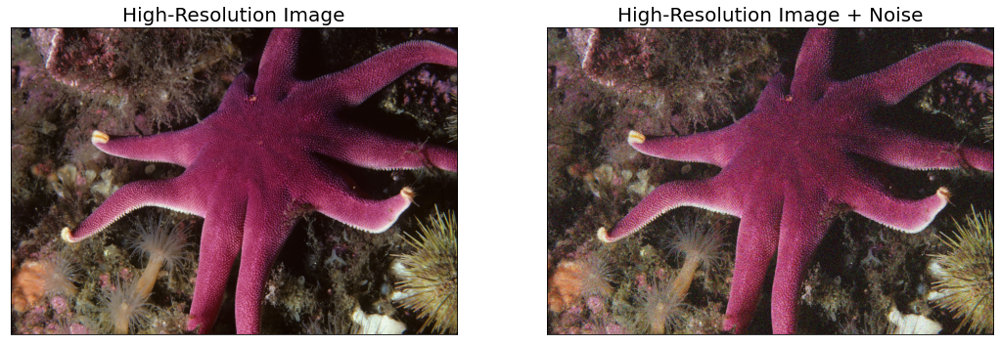

In [64]:
# Define import path (i.e. where the raw dataset is stored)
import_path = 'data/complete_dataset/HR'

# Define Gaussian noise parameters
noise_factor = 0.2

# Define list of files in import path
file_list = os.listdir(import_path)

# Define filename
filename = os.path.join(import_path, file_list[0])

# Read image
img = io.imread(filename)/255.0

# Generate and add Gaussian noise to original image
#   Generate Gaussian noise and reshape to image size
noise = np.random.normal(loc=0, scale=1, size=img.shape)
#   Add noise to image
noisy = np.clip((img + noise*noise_factor), 0, 1)

# Generate figure
plt.figure(figsize=(18,8))

# Display high-resolution image
plt.subplot(121)
plt.imshow(img)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display noisy image
plt.subplot(122)
plt.imshow(noisy)
plt.title('High-Resolution Image + Noise', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

## Downsampling
The cell below shows the impact of downsampling on the first image in the dataset.

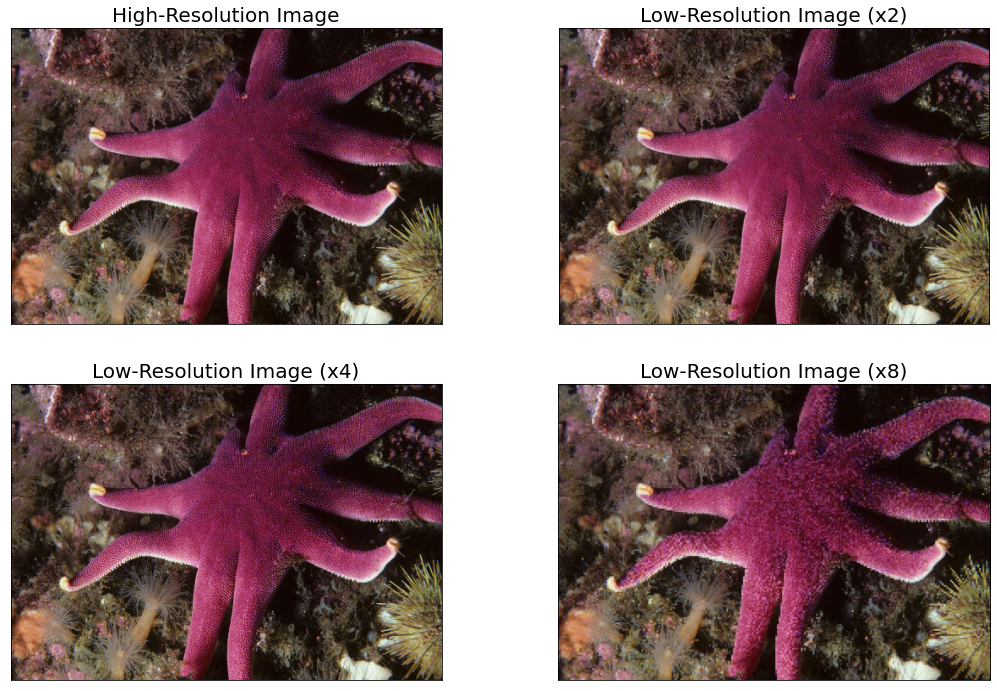

In [8]:
# Define import path (i.e. where the raw dataset is stored)
import_path = 'data/complete_dataset/HR'

# Define list of files in import path
file_list = os.listdir(import_path)

# Define filename
filename = os.path.join(import_path, file_list[0])

# Read image
img = io.imread(filename)/255.0

# Save original image shape
w = img.shape[0]
h = img.shape[1]

# Downsample original image using OpenCV and different downsampling formats (in number of pixels)
down_img_2 = cv2.resize(img, dsize=(int(h/2), int(w/2)), interpolation=cv2.INTER_CUBIC)
down_img_4 = cv2.resize(img, dsize=(int(h/4), int(w/4)), interpolation=cv2.INTER_CUBIC)
down_img_8 = cv2.resize(img, dsize=(int(h/8), int(w/8)), interpolation=cv2.INTER_CUBIC)

# Ensure all pixel values are between 0 and 1
img = np.clip(img, 0, 1)
down_img_2 = np.clip(down_img_2, 0, 1)
down_img_4 = np.clip(down_img_4, 0, 1)
down_img_8 = np.clip(down_img_8, 0, 1)

# Generate figure
plt.figure(figsize=(18,12))

# Display high-resolution image
plt.subplot(221)
plt.imshow(img)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled images
plt.subplot(222)
plt.imshow(down_img_2)
plt.title('Low-Resolution Image (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(223)
plt.imshow(down_img_4)
plt.title('Low-Resolution Image (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(224)
plt.imshow(down_img_8)
plt.title('Low-Resolution Image (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

## Downsampling and noise addition
The cell below shows the combined impact of downsampling and adding Gaussian noise to the first image in the dataset.

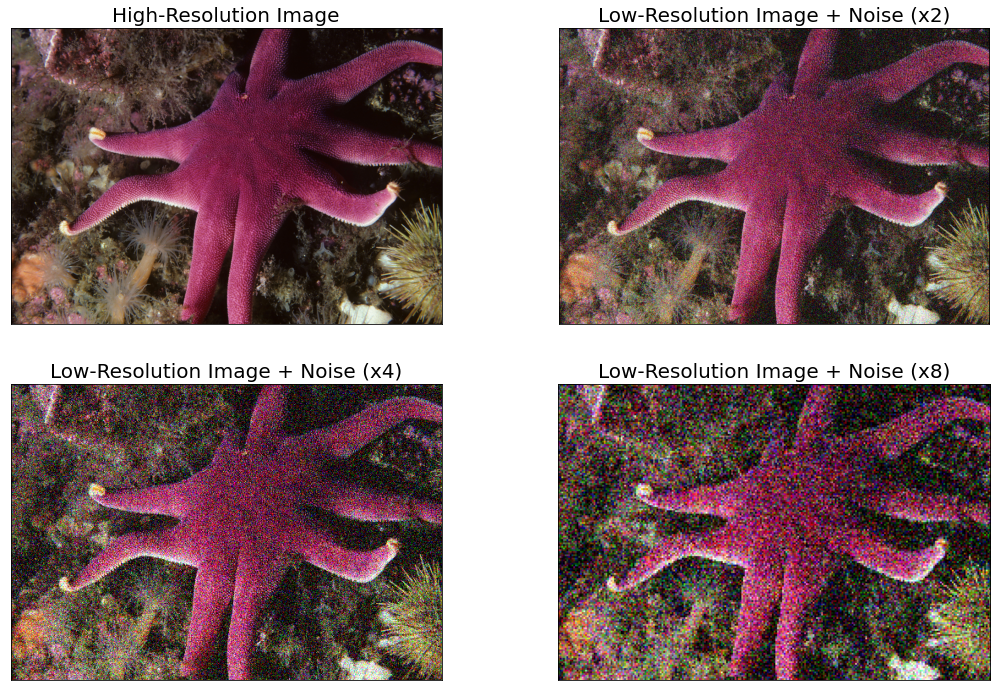

In [9]:
# Define import path (i.e. where the raw dataset is stored)
import_path = 'data/complete_dataset/HR'

# Define Gaussian noise parameters
noise_factor = 0.2

# Define list of files in import path
file_list = os.listdir(import_path)

# Define filename
filename = os.path.join(import_path, file_list[0])

# Read image
img = io.imread(filename)/255.0

# Save original image shape
w = img.shape[0]
h = img.shape[1]

# Downsample original image using OpenCV and different downsampling formats (in number of pixels)
down_img_2 = cv2.resize(img, dsize=(int(h/2), int(w/2)), interpolation=cv2.INTER_CUBIC)
down_img_4 = cv2.resize(img, dsize=(int(h/4), int(w/4)), interpolation=cv2.INTER_CUBIC)
down_img_8 = cv2.resize(img, dsize=(int(h/8), int(w/8)), interpolation=cv2.INTER_CUBIC)

# Generate and add Gaussian noise to downsampled images
#   Downsampled x2
#      Generate Gaussian noise and reshape to image size
noise = np.random.normal(loc=0, scale=1, size=down_img_2.shape)
#      Add noise to image
down_img_2 = np.clip((down_img_2 + noise*noise_factor), 0, 1)
#   Downsampled x4
#      Generate Gaussian noise and reshape to image size
noise = np.random.normal(loc=0, scale=1, size=down_img_4.shape)
#      Add noise to image
down_img_4 = np.clip((down_img_4 + noise*noise_factor), 0, 1)
#   Downsampled x8
#      Generate Gaussian noise and reshape to image size
noise = np.random.normal(loc=0, scale=1, size=down_img_8.shape)
#      Add noise to image
down_img_8 = np.clip((down_img_8 + noise*noise_factor), 0, 1)

# Generate figure
plt.figure(figsize=(18,12))

# Display high-resolution image
plt.subplot(221)
plt.imshow(img)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled images
plt.subplot(222)
plt.imshow(down_img_2)
plt.title('Low-Resolution Image + Noise (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(223)
plt.imshow(down_img_4)
plt.title('Low-Resolution Image + Noise (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(224)
plt.imshow(down_img_8)
plt.title('Low-Resolution Image + Noise (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

## Define save function
The function below was written to enable the export of a defined image (in array format) towards a defined path, which will be automatically generated in case any element of that path (i.e. folder or subfolder) is missing.

In [3]:
def save_img(export_path, img, img_name):
    '''
    save_img(export_path, img, img_name, cmap='gray')
        Function enabling the export of an image file towards a defined export path.
        Includes the automated generation of each missing element(i.e. folder/subfolder)
        contained in the defined path.
    Parameters:
        export_path: full path to target folder
            (type: string)
        img: source image
            (type: array)
        img_name: name of the exported image (e.g. example.jpg)
            (type: string)
        cmap: specifies the kind of color map to use for the plt.imsave function
            (type: string)
    '''
    
    # Initialize previous fold
    previous_fold = ''
    
    # Loop through all folders and subfolders of the export path
    for fold in export_path.split('/'):
        
        # If any folder/subfolder of the export path does not exist, it will be automatically generated
        if not os.path.exists(os.path.abspath(os.path.join(previous_fold, fold))):
            os.mkdir(os.path.abspath(os.path.join(previous_fold, fold)))
            
        # Update previous fold to current fold until full export path has been checked/generated
        previous_fold = os.path.abspath(os.path.join(previous_fold, fold))
        
    # Save image at export path with defined filename and color map
    plt.imsave(os.path.join(export_path, img_name), img)

## Export processed images
In order to have different input options for the training of the SRNN, we will export the following pre-processed images:
1. Downsampled images with different downsampling factors (x2, x4, x8, x16, x32)
2. Downsampled and noisy images with different downsampling factors (x2, x4, x8, x16, x32)

In [4]:
# Define import path (i.e. where the raw dataset is stored)
import_path = 'data/complete_dataset/HR'

# Define list of downsampling factors
lr_down_list = [2, 4, 8, 16, 32]

# Define Gaussian noise parameters
noise_factor = 0.2

# Initialize time tracker
start_time = time()

for lr_down in lr_down_list:
    
    print(f'\033[1mDOWNSAMPLING FACTOR (x{lr_down})\033[0m')

    # Define export paths (i.e. where processed JPG images will be saved)
    lr_export_path = 'data/complete_dataset/LR/down_factor_x' + str(lr_down)
    lr_n_export_path = 'data/complete_dataset/LR_Noise/down_factor_x' + str(lr_down)

    # Define list of files in import path
    file_list = os.listdir(import_path)

    # Loop through all files in the import path
    for file in file_list:

        # Define filename
        filename = os.path.join(import_path, file)

        # Read image
        img = io.imread(filename)/255.0
        
        # Save original image shape
        w = img.shape[0]
        h = img.shape[1]

        # DOWNSAMPLING
        #   Downsample original image using OpenCV
        lr = cv2.resize(img, dsize=(int(h/lr_down), int(w/lr_down)), interpolation=cv2.INTER_CUBIC)
        #   Ensure all pixel values are between 0 and 1
        lr = np.clip(lr, 0, 1)
        #   Save image of the downsampled image in JPG format
        save_img(lr_export_path, lr, 'lr_x' + str(lr_down) + '_' + file)

        # DOWNSAMPLING + NOISE ADDITION
        
        #      Calculate image dimensions
        #   Generate and add Gaussian noise to downsampled image
        #      Generate Gaussian noise and reshape to image size
        noise = np.random.normal(loc=0, scale=1, size=lr.shape)
        #      Add noise to image
        lr_n = np.clip((lr + noise*noise_factor), 0, 1)
        
        #   Save image of the downsampled noisy image in JPG format
        save_img(lr_n_export_path, lr_n, 'lr_n_x' + str(lr_down) + '_' + file)    
    
    print(f'\tTotal number of exported processed images: {len(os.listdir(lr_n_export_path))}\n')
          
# Print total computing time
total_time = time() - start_time
print(f'\033[1mTotal computing time:\033[0m {total_time//3600:2.0f} hrs '
      f'{(total_time - total_time//3600*3600)//60:2.0f} mins '
      f'{total_time%60:2.0f} secs')

DOWNSAMPLING FACTOR (x2)
	Total number of exported processed images: 900

DOWNSAMPLING FACTOR (x4)
	Total number of exported processed images: 900

DOWNSAMPLING FACTOR (x8)
	Total number of exported processed images: 900

DOWNSAMPLING FACTOR (x16)
	Total number of exported processed images: 900

DOWNSAMPLING FACTOR (x32)
	Total number of exported processed images: 900

Total computing time:  0 hrs 18 mins 30 secs


## Check exported images
To ensure that the downsampled and downsampled-noisy images have been successfully exported, the two cells below will import the exported/processed images and display the first sample for visual verification.
### Downsampled images

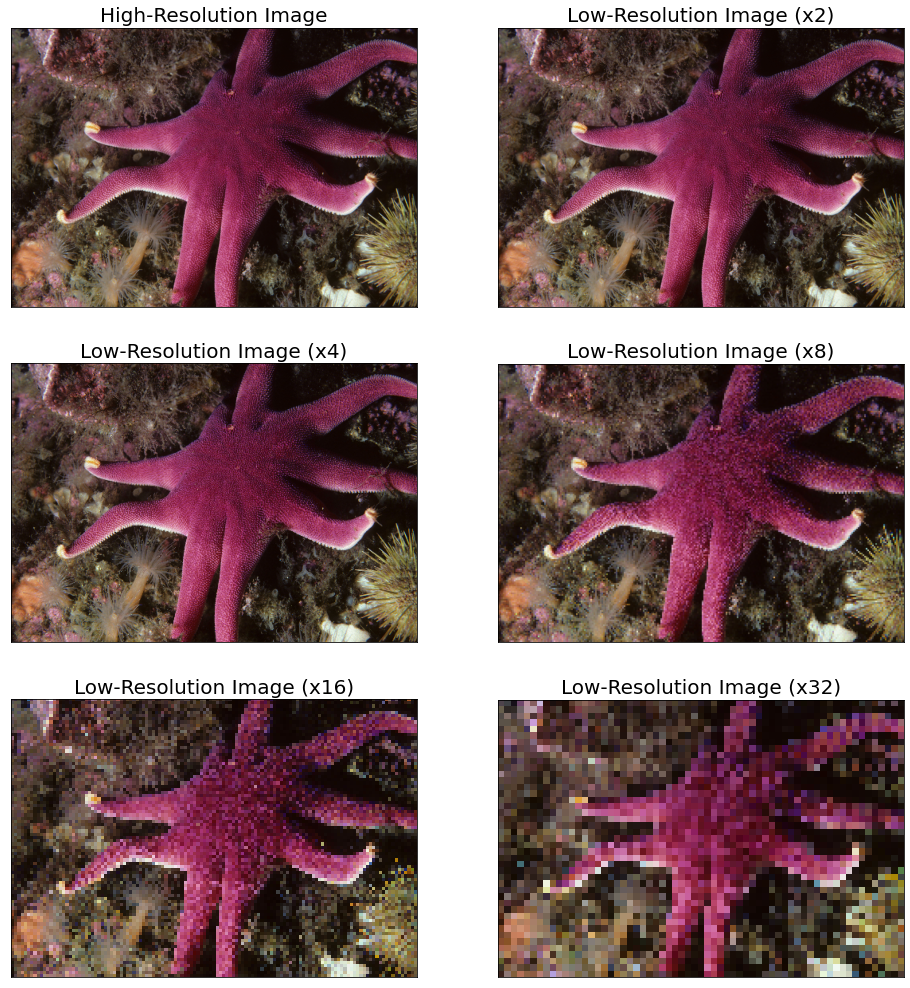

In [11]:
# Define import paths
import_path_hr = 'data/complete_dataset/HR'
import_path_lr_x2 = 'data/complete_dataset/LR/down_factor_x2'
import_path_lr_x4 = 'data/complete_dataset/LR/down_factor_x4'
import_path_lr_x8 = 'data/complete_dataset/LR/down_factor_x8'
import_path_lr_x16 = 'data/complete_dataset/LR/down_factor_x16'
import_path_lr_x32 = 'data/complete_dataset/LR/down_factor_x32'

# Define list of files in every import path
file_list_hr = os.listdir(import_path_hr)
file_list_lr_x2 = os.listdir(import_path_lr_x2)
file_list_lr_x4 = os.listdir(import_path_lr_x4)
file_list_lr_x8 = os.listdir(import_path_lr_x8)
file_list_lr_x16 = os.listdir(import_path_lr_x16)
file_list_lr_x32 = os.listdir(import_path_lr_x32)

# Define filename
filename_hr = os.path.join(import_path_hr, file_list_hr[0])
filename_lr_x2 = os.path.join(import_path_lr_x2, file_list_lr_x2[0])
filename_lr_x4 = os.path.join(import_path_lr_x4, file_list_lr_x4[0])
filename_lr_x8 = os.path.join(import_path_lr_x8, file_list_lr_x8[0])
filename_lr_x16 = os.path.join(import_path_lr_x16, file_list_lr_x16[0])
filename_lr_x32 = os.path.join(import_path_lr_x32, file_list_lr_x32[0])

# Read image
hr = io.imread(filename_hr)
lr_x2 = io.imread(filename_lr_x2)
lr_x4 = io.imread(filename_lr_x4)
lr_x8 = io.imread(filename_lr_x8)
lr_x16 = io.imread(filename_lr_x16)
lr_x32 = io.imread(filename_lr_x32)

# Generate figure
plt.figure(figsize=(16,36))

# Display high-resolution image
plt.subplot(621)
plt.imshow(hr)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled images
plt.subplot(622)
plt.imshow(lr_x2)
plt.title('Low-Resolution Image (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(623)
plt.imshow(lr_x4)
plt.title('Low-Resolution Image (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(624)
plt.imshow(lr_x8)
plt.title('Low-Resolution Image (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(625)
plt.imshow(lr_x16)
plt.title('Low-Resolution Image (x16)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(626)
plt.imshow(lr_x32)
plt.title('Low-Resolution Image (x32)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

### Downsampled + Noisy images

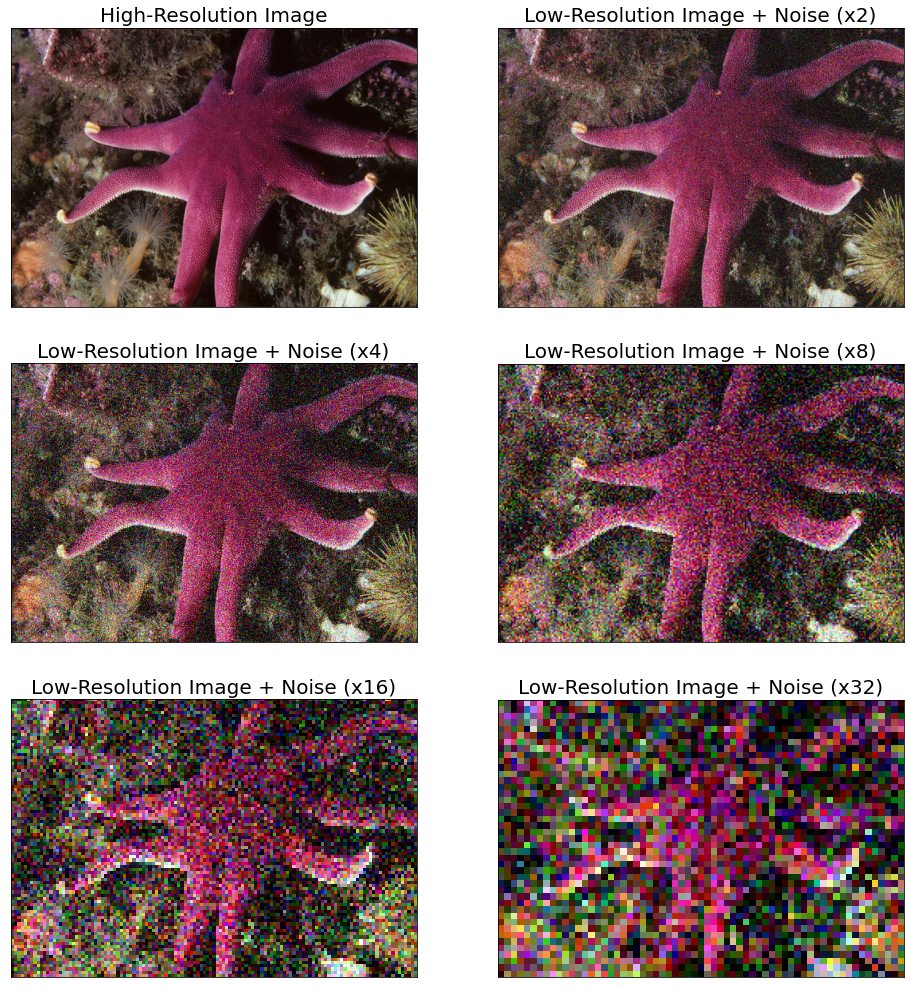

In [12]:
# Define import paths
import_path_hr = 'data/complete_dataset/HR'
import_path_lr_n_x2 = 'data/complete_dataset/LR_Noise/down_factor_x2'
import_path_lr_n_x4 = 'data/complete_dataset/LR_Noise/down_factor_x4'
import_path_lr_n_x8 = 'data/complete_dataset/LR_Noise/down_factor_x8'
import_path_lr_n_x16 = 'data/complete_dataset/LR_Noise/down_factor_x16'
import_path_lr_n_x32 = 'data/complete_dataset/LR_Noise/down_factor_x32'

# Define list of files in every import path
file_list_hr = os.listdir(import_path_hr)
file_list_lr_n_x2 = os.listdir(import_path_lr_n_x2)
file_list_lr_n_x4 = os.listdir(import_path_lr_n_x4)
file_list_lr_n_x8 = os.listdir(import_path_lr_n_x8)
file_list_lr_n_x16 = os.listdir(import_path_lr_n_x16)
file_list_lr_n_x32 = os.listdir(import_path_lr_n_x32)

# Define filename
filename_hr = os.path.join(import_path_hr, file_list_hr[0])
filename_lr_n_x2 = os.path.join(import_path_lr_n_x2, file_list_lr_n_x2[0])
filename_lr_n_x4 = os.path.join(import_path_lr_n_x4, file_list_lr_n_x4[0])
filename_lr_n_x8 = os.path.join(import_path_lr_n_x8, file_list_lr_n_x8[0])
filename_lr_n_x16 = os.path.join(import_path_lr_n_x16, file_list_lr_n_x16[0])
filename_lr_n_x32 = os.path.join(import_path_lr_n_x32, file_list_lr_n_x32[0])

# Read image
hr = io.imread(filename_hr)
lr_n_x2 = io.imread(filename_lr_n_x2)
lr_n_x4 = io.imread(filename_lr_n_x4)
lr_n_x8 = io.imread(filename_lr_n_x8)
lr_n_x16 = io.imread(filename_lr_n_x16)
lr_n_x32 = io.imread(filename_lr_n_x32)

# Generate figure
plt.figure(figsize=(16,36))

# Display high-resolution image
plt.subplot(621)
plt.imshow(hr)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled images
plt.subplot(622)
plt.imshow(lr_n_x2)
plt.title('Low-Resolution Image + Noise (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(623)
plt.imshow(lr_n_x4)
plt.title('Low-Resolution Image + Noise (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(624)
plt.imshow(lr_n_x8)
plt.title('Low-Resolution Image + Noise (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(625)
plt.imshow(lr_n_x16)
plt.title('Low-Resolution Image + Noise (x16)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(626)
plt.imshow(lr_n_x32)
plt.title('Low-Resolution Image + Noise (x32)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

___
# Train-Test Split

Before defining the Dataset class, we will split the data into training and test sets. For that, we will:

1. Define the train-test ratio
2. Shuffle and export the data into the corresponding 'train' and 'test' folders

In [14]:
# Define train-test ratio (e.g. if train_ratio = 0.8, then 80% of the data will be used for training)
train_ratio = 0.8

# Initialize time tracker
start_time = time()

# Define import path
import_path = 'data/complete_dataset'

# Define export paths
export_path_train = 'data/train'
export_path_test = 'data/test'

# Check if export part already exists, if yes, delete them
# (as each time this cell is ran a new selection of training and testing images should be selected and exported)
if os.path.exists(export_path_train) and os.path.isdir(export_path_train):
    shutil.rmtree(export_path_train)
if os.path.exists(export_path_test) and os.path.isdir(export_path_test):
    shutil.rmtree(export_path_test)

# Define list of files in every import path
file_list_hr = os.listdir(os.path.join(import_path, 'HR'))
file_list_lr_x2 = os.listdir(os.path.join(import_path, 'LR/down_factor_x2'))
file_list_lr_x4 = os.listdir(os.path.join(import_path, 'LR/down_factor_x4'))
file_list_lr_x8 = os.listdir(os.path.join(import_path, 'LR/down_factor_x8'))
file_list_lr_x16 = os.listdir(os.path.join(import_path, 'LR/down_factor_x16'))
file_list_lr_x32 = os.listdir(os.path.join(import_path, 'LR/down_factor_x32'))
file_list_lr_n_x2 = os.listdir(os.path.join(import_path, 'LR_Noise/down_factor_x2'))
file_list_lr_n_x4 = os.listdir(os.path.join(import_path, 'LR_Noise/down_factor_x4'))
file_list_lr_n_x8 = os.listdir(os.path.join(import_path, 'LR_Noise/down_factor_x8'))
file_list_lr_n_x16 = os.listdir(os.path.join(import_path, 'LR_Noise/down_factor_x16'))
file_list_lr_n_x32 = os.listdir(os.path.join(import_path, 'LR_Noise/down_factor_x32'))

# Combine all list of files
files = np.transpose((file_list_hr, file_list_lr_x2, file_list_lr_x4, file_list_lr_x8, file_list_lr_x16, file_list_lr_x32,
         file_list_lr_n_x2, file_list_lr_n_x4, file_list_lr_n_x8, file_list_lr_n_x16, file_list_lr_n_x32))

# Count total number of samples
samples_length = len(file_list_hr)

# Define number of training samples
train_length = int(samples_length*train_ratio)

# Generate list of indices based on total number of samples
ind_list = np.arange(samples_length)

# Shuffle list of indices
np.random.shuffle(ind_list)

# Define lists of training and testing indices
train_ind = ind_list[:train_length]
test_ind = ind_list[train_length:]

for idx, (hr, lr_x2, lr_x4, lr_x8, lr_x16, lr_x32, lr_n_x2, lr_n_x4, lr_n_x8, lr_n_x16, lr_n_x32) in enumerate(files):
    
    # Read images
    img_hr = io.imread(os.path.join(import_path, 'HR/' + hr))
    img_lr_x2 = io.imread(os.path.join(import_path, 'LR/down_factor_x2/' + lr_x2))
    img_lr_x4 = io.imread(os.path.join(import_path, 'LR/down_factor_x4/' + lr_x4))
    img_lr_x8 = io.imread(os.path.join(import_path, 'LR/down_factor_x8/' + lr_x8))
    img_lr_x16 = io.imread(os.path.join(import_path, 'LR/down_factor_x16/' + lr_x16))
    img_lr_x32 = io.imread(os.path.join(import_path, 'LR/down_factor_x32/' + lr_x32))
    img_lr_n_x2 = io.imread(os.path.join(import_path, 'LR_Noise/down_factor_x2/' + lr_n_x2))
    img_lr_n_x4 = io.imread(os.path.join(import_path, 'LR_Noise/down_factor_x4/' + lr_n_x4))
    img_lr_n_x8 = io.imread(os.path.join(import_path, 'LR_Noise/down_factor_x8/' + lr_n_x8))
    img_lr_n_x16 = io.imread(os.path.join(import_path, 'LR_Noise/down_factor_x16/' + lr_n_x16))
    img_lr_n_x32 = io.imread(os.path.join(import_path, 'LR_Noise/down_factor_x32/' + lr_n_x32))
    
    # Export training images
    if idx in train_ind:        
        save_img(export_path_train + '/HR', img_hr, hr)        
        save_img(export_path_train + '/LR/down_factor_x2', img_lr_x2, lr_x2)        
        save_img(export_path_train + '/LR/down_factor_x4', img_lr_x4, lr_x4)        
        save_img(export_path_train + '/LR/down_factor_x8', img_lr_x8, lr_x8)   
        save_img(export_path_train + '/LR/down_factor_x16', img_lr_x16, lr_x16)        
        save_img(export_path_train + '/LR/down_factor_x32', img_lr_x32, lr_x32)   
        save_img(export_path_train + '/LR_Noise/down_factor_x2', img_lr_n_x2, lr_n_x2)        
        save_img(export_path_train + '/LR_Noise/down_factor_x4', img_lr_n_x4, lr_n_x4)        
        save_img(export_path_train + '/LR_Noise/down_factor_x8', img_lr_n_x8, lr_n_x8)
        save_img(export_path_train + '/LR_Noise/down_factor_x16', img_lr_n_x16, lr_n_x16)        
        save_img(export_path_train + '/LR_Noise/down_factor_x32', img_lr_n_x32, lr_n_x32)

    # Export testing images
    elif idx in test_ind:        
        save_img(export_path_test + '/HR', img_hr, hr)        
        save_img(export_path_test + '/LR/down_factor_x2', img_lr_x2, lr_x2)        
        save_img(export_path_test + '/LR/down_factor_x4', img_lr_x4, lr_x4)        
        save_img(export_path_test + '/LR/down_factor_x8', img_lr_x8, lr_x8)  
        save_img(export_path_test + '/LR/down_factor_x16', img_lr_x16, lr_x16)        
        save_img(export_path_test + '/LR/down_factor_x32', img_lr_x32, lr_x32)  
        save_img(export_path_test + '/LR_Noise/down_factor_x2', img_lr_n_x2, lr_n_x2)        
        save_img(export_path_test + '/LR_Noise/down_factor_x4', img_lr_n_x4, lr_n_x4)        
        save_img(export_path_test + '/LR_Noise/down_factor_x8', img_lr_n_x8, lr_n_x8)
        save_img(export_path_test + '/LR_Noise/down_factor_x16', img_lr_n_x16, lr_n_x16)        
        save_img(export_path_test + '/LR_Noise/down_factor_x32', img_lr_n_x32, lr_n_x32)

# Check and display number of training and testing samples
train_length = len(list(os.listdir(export_path_train + '/LR/down_factor_x2')))
test_length = len(list(os.listdir(export_path_test + '/LR/down_factor_x2')))
print(f'\033[1mTotal number of samples:\033[0m\t{samples_length:4.0f}   ->   {100:3.0f}%')
print(f'\033[1mNumber of training samples:\033[0m\t{train_length:4.0f}   ->   {train_length*100/samples_length:3.0f}%')
print(f'\033[1mNumber of testing samples:\033[0m\t{test_length:4.0f}   ->   {test_length*100/samples_length:3.0f}%')
print('\n')

# Print total computing time
total_time = time() - start_time
print(f'\033[1mTotal computing time:\033[0m {total_time//3600:2.0f} hrs '
      f'{(total_time - total_time//3600*3600)//60:2.0f} mins '
      f'{total_time%60:2.0f} secs')

Total number of samples:	 900   ->   100%
Number of training samples:	 720   ->    80%
Number of testing samples:	 180   ->    20%


Total computing time:  0 hrs 28 mins 52 secs


___
# Data Augmentation

In this section, we will explore different data augmentation strategies.

Data augmentation is a technique that can be used to artificially expand the size and diversity of a dataset by creating variations of the samples that can improve the ability of the model to generalize to new unseen images.

In **image processing**, common data augmentation strategies include rotating, cropping, flipping, resizing, etc.

## Augmentation strategies
In the script below, we will illustrate the two augmentation strategies implemented in this dataset:

- **Random rotation**

    This operation will allow each sample to be rotated by a random angle comprised between a defined range.  
    
    
- **Random warping**

    This operation will allow each sample to be randomly warped along the x- and y-axes, resulting in an altered image ratio (e.g. slightly elongated image along a random direction, accounting for potential differences in patient morphology).
    
    
- **Random cropping**

    This operation will allow each sample to be randomly cropped.

**NOTE:** To facilitate visualization, the rotation and warping ranges will be dramatically enlarged in the script below. When defining the final dataset used for training, these ranges will remain minimal as medical images are acquired using a standardized protocol and patient orientation.

## Augmentation parameters

In [15]:
# Define rotation angle range for data augmentation
#   e.g. if set to 5, each transformed image is randomly rotated by an angle comprised between -5 and +5 degrees
rotation_range = 60

# Define warping range for data augmentation
#   e.g. if set to 0.6, each transformed image is randomly resized along the x- and y-axes by a factor
#   comprised between 60% and 100% of the original image shape (with different factors for each direction).
#   The resize image is then re-resize to the original image shape by filling the cropped pixels with black pixels
#   (giving the impression of warping)
warping_range = 0.4

# Define cropping ratio range for data augmentation
#   e.g. if crop_lower_range = 0.5 and crop_upper_range = 0.8, each transformed image is randomly cropped
#   along the x- and y-axes by a factor comprised between 50% and 80% of the original image dimensions
crop_lower_range = 0.5
crop_upper_range = 0.6
cropping_ratio = np.random.uniform(crop_lower_range, crop_upper_range)

## Augmentation pre-visualization
### Strategy #1: Random rotation

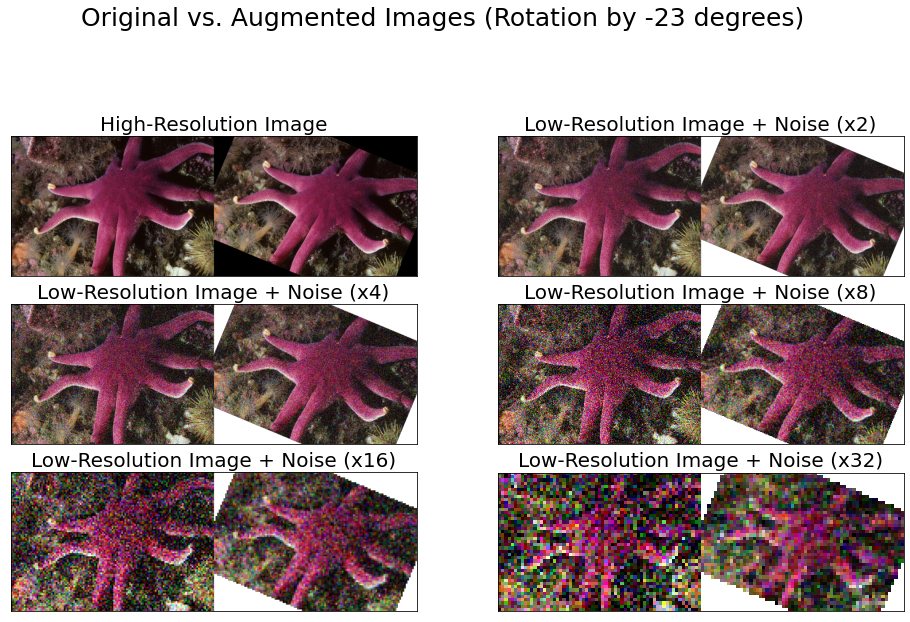

In [23]:
# Define import paths
import_path_hr = 'data/complete_dataset/HR'
import_path_lr_x2 = 'data/complete_dataset/LR/down_factor_x2'
import_path_lr_x4 = 'data/complete_dataset/LR/down_factor_x4'
import_path_lr_x8 = 'data/complete_dataset/LR/down_factor_x8'
import_path_lr_x16 = 'data/complete_dataset/LR/down_factor_x16'
import_path_lr_x32 = 'data/complete_dataset/LR/down_factor_x32'

# Define list of files in every import path
file_list_hr = os.listdir(import_path_hr)
file_list_lr_n_x2 = os.listdir(import_path_lr_n_x2)
file_list_lr_n_x4 = os.listdir(import_path_lr_n_x4)
file_list_lr_n_x8 = os.listdir(import_path_lr_n_x8)
file_list_lr_n_x16 = os.listdir(import_path_lr_n_x16)
file_list_lr_n_x32 = os.listdir(import_path_lr_n_x32)

# Define filename
filename_hr = os.path.join(import_path_hr, file_list_hr[0])
filename_lr_n_x2 = os.path.join(import_path_lr_n_x2, file_list_lr_n_x2[0])
filename_lr_n_x4 = os.path.join(import_path_lr_n_x4, file_list_lr_n_x4[0])
filename_lr_n_x8 = os.path.join(import_path_lr_n_x8, file_list_lr_n_x8[0])
filename_lr_n_x16 = os.path.join(import_path_lr_n_x16, file_list_lr_n_x16[0])
filename_lr_n_x32 = os.path.join(import_path_lr_n_x32, file_list_lr_n_x32[0])

# Read images
hr = io.imread(filename_hr)
lr_n_x2 = io.imread(filename_lr_n_x2)
lr_n_x4 = io.imread(filename_lr_n_x4)
lr_n_x8 = io.imread(filename_lr_n_x8)
lr_n_x16 = io.imread(filename_lr_n_x16)
lr_n_x32 = io.imread(filename_lr_n_x32)

# Data augmentation 1: apply random rotation to images (based on defined rotation range)
angle = np.random.uniform(-rotation_range,rotation_range)
hr_aug1 = ndimage.rotate(hr, angle, axes=(0,1), reshape=False, order=1, cval=0)
lr_n_x2_aug1 = ndimage.rotate(lr_n_x2, angle, axes=(0,1), reshape=False, order=1, cval=0)
lr_n_x4_aug1 = ndimage.rotate(lr_n_x4, angle, axes=(0,1), reshape=False, order=1, cval=0)
lr_n_x8_aug1 = ndimage.rotate(lr_n_x8, angle, axes=(0,1), reshape=False, order=1, cval=0)
lr_n_x16_aug1 = ndimage.rotate(lr_n_x16, angle, axes=(0,1), reshape=False, order=1, cval=0)
lr_n_x32_aug1 = ndimage.rotate(lr_n_x32, angle, axes=(0,1), reshape=False, order=1, cval=0)

# Combine original and augmented images into grid
grid_hr = np.hstack([hr, hr_aug1])
grid_x2 = np.hstack([lr_n_x2, lr_n_x2_aug1])
grid_x4 = np.hstack([lr_n_x4, lr_n_x4_aug1])
grid_x8 = np.hstack([lr_n_x8, lr_n_x8_aug1])
grid_x16 = np.hstack([lr_n_x16, lr_n_x16_aug1])
grid_x32 = np.hstack([lr_n_x32, lr_n_x32_aug1])

# Display augmentation results
#   Generate figure
plt.figure(figsize=(16,18))
plt.suptitle(f'Original vs. Augmented Images (Rotation by {angle:0.0f} degrees)', fontsize=25)

# Display high-resolution image
plt.subplot(621)
plt.imshow(grid_hr)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled-noisy images
plt.subplot(622)
plt.imshow(grid_x2)
plt.title('Low-Resolution Image + Noise (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(623)
plt.imshow(grid_x4)
plt.title('Low-Resolution Image + Noise (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(624)
plt.imshow(grid_x8)
plt.title('Low-Resolution Image + Noise (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(625)
plt.imshow(grid_x16)
plt.title('Low-Resolution Image + Noise (x16)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(626)
plt.imshow(grid_x32)
plt.title('Low-Resolution Image + Noise (x32)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

### Strategy #2: Random warping

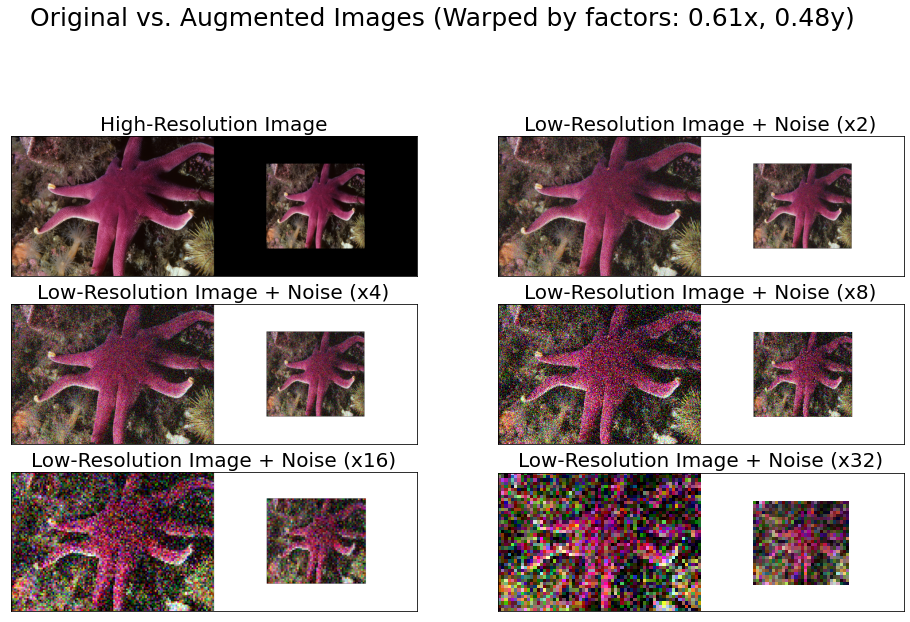

In [24]:
# Define import paths
import_path_hr = 'data/complete_dataset/HR'
import_path_lr_x2 = 'data/complete_dataset/LR/down_factor_x2'
import_path_lr_x4 = 'data/complete_dataset/LR/down_factor_x4'
import_path_lr_x8 = 'data/complete_dataset/LR/down_factor_x8'
import_path_lr_x16 = 'data/complete_dataset/LR/down_factor_x16'
import_path_lr_x32 = 'data/complete_dataset/LR/down_factor_x32'

# Define list of files in every import path
file_list_hr = os.listdir(import_path_hr)
file_list_lr_n_x2 = os.listdir(import_path_lr_n_x2)
file_list_lr_n_x4 = os.listdir(import_path_lr_n_x4)
file_list_lr_n_x8 = os.listdir(import_path_lr_n_x8)
file_list_lr_n_x16 = os.listdir(import_path_lr_n_x16)
file_list_lr_n_x32 = os.listdir(import_path_lr_n_x32)

# Define filename
filename_hr = os.path.join(import_path_hr, file_list_hr[0])
filename_lr_n_x2 = os.path.join(import_path_lr_n_x2, file_list_lr_n_x2[0])
filename_lr_n_x4 = os.path.join(import_path_lr_n_x4, file_list_lr_n_x4[0])
filename_lr_n_x8 = os.path.join(import_path_lr_n_x8, file_list_lr_n_x8[0])
filename_lr_n_x16 = os.path.join(import_path_lr_n_x16, file_list_lr_n_x16[0])
filename_lr_n_x32 = os.path.join(import_path_lr_n_x32, file_list_lr_n_x32[0])

# Read images
hr = io.imread(filename_hr)
lr_n_x2 = io.imread(filename_lr_n_x2)
lr_n_x4 = io.imread(filename_lr_n_x4)
lr_n_x8 = io.imread(filename_lr_n_x8)
lr_n_x16 = io.imread(filename_lr_n_x16)
lr_n_x32 = io.imread(filename_lr_n_x32)

# Data augmentation 2: apply random warping to image (based on defined warping range)
#   Generate random warping factors along x- and y-axes
warping_x = np.random.uniform(warping_range,1)
warping_y = np.random.uniform(warping_range,1)

#   HR
#      Warp images
hr_aug2 = ndimage.zoom(hr, (warping_x,warping_y,1), order=1, cval=0)
#      Calculate number of rows and columns to add shape
n_rows = hr.shape[0] - hr_aug2.shape[0]
n_cols = hr.shape[1] - hr_aug2.shape[1]
#      Calculate padding shape
if n_rows%2 == 0 and n_cols%2 == 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 == 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 == 0 and n_cols%2 != 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 != 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
#      Pad images to match original shape
hr_aug2 = np.pad(hr_aug2, pad_shape, 'constant', constant_values=0)

#   (x2)
#      Warp images
lr_n_x2_aug2 = ndimage.zoom(lr_n_x2, (warping_x,warping_y,1), order=1, cval=0)
#      Calculate number of rows and columns to add shape
n_rows = lr_n_x2.shape[0] - lr_n_x2_aug2.shape[0]
n_cols = lr_n_x2.shape[1] - lr_n_x2_aug2.shape[1]
#      Calculate padding shape
if n_rows%2 == 0 and n_cols%2 == 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 == 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 == 0 and n_cols%2 != 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 != 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
#      Pad images to match original shape
lr_n_x2_aug2 = np.pad(lr_n_x2_aug2, pad_shape, 'constant', constant_values=0)

#   (x4)
#      Warp images
lr_n_x4_aug2 = ndimage.zoom(lr_n_x4, (warping_x,warping_y,1), order=1, cval=0)
#      Calculate number of rows and columns to add shape
n_rows = lr_n_x4.shape[0] - lr_n_x4_aug2.shape[0]
n_cols = lr_n_x4.shape[1] - lr_n_x4_aug2.shape[1]
#      Calculate padding shape
if n_rows%2 == 0 and n_cols%2 == 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 == 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 == 0 and n_cols%2 != 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 != 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
#      Pad images to match original shape
lr_n_x4_aug2 = np.pad(lr_n_x4_aug2, pad_shape, 'constant', constant_values=0)

#   (x8)
#      Warp images
lr_n_x8_aug2 = ndimage.zoom(lr_n_x8, (warping_x,warping_y,1), order=1, cval=0)
#      Calculate number of rows and columns to add shape
n_rows = lr_n_x8.shape[0] - lr_n_x8_aug2.shape[0]
n_cols = lr_n_x8.shape[1] - lr_n_x8_aug2.shape[1]
#      Calculate padding shape
if n_rows%2 == 0 and n_cols%2 == 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 == 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 == 0 and n_cols%2 != 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 != 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
#      Pad images to match original shape
lr_n_x8_aug2 = np.pad(lr_n_x8_aug2, pad_shape, 'constant', constant_values=0)

#   (x16)
#      Warp images
lr_n_x16_aug2 = ndimage.zoom(lr_n_x16, (warping_x,warping_y,1), order=1, cval=0)
#      Calculate number of rows and columns to add shape
n_rows = lr_n_x16.shape[0] - lr_n_x16_aug2.shape[0]
n_cols = lr_n_x16.shape[1] - lr_n_x16_aug2.shape[1]
#      Calculate padding shape
if n_rows%2 == 0 and n_cols%2 == 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 == 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 == 0 and n_cols%2 != 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 != 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
#      Pad images to match original shape
lr_n_x16_aug2 = np.pad(lr_n_x16_aug2, pad_shape, 'constant', constant_values=0)

#   (x32)
#      Warp images
lr_n_x32_aug2 = ndimage.zoom(lr_n_x32, (warping_x,warping_y,1), order=1, cval=0)
#      Calculate number of rows and columns to add shape
n_rows = lr_n_x32.shape[0] - lr_n_x32_aug2.shape[0]
n_cols = lr_n_x32.shape[1] - lr_n_x32_aug2.shape[1]
#      Calculate padding shape
if n_rows%2 == 0 and n_cols%2 == 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 == 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (int(n_cols/2), int(n_cols/2)), (0,0))
elif n_rows%2 == 0 and n_cols%2 != 0:
    pad_shape = ((int(n_rows/2), int(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
elif n_rows%2 != 0 and n_cols%2 != 0:
    pad_shape = ((math.ceil(n_rows/2), math.floor(n_rows/2)), (math.ceil(n_cols/2), math.floor(n_cols/2)), (0,0))
#      Pad images to match original shape
lr_n_x32_aug2 = np.pad(lr_n_x32_aug2, pad_shape, 'constant', constant_values=0)

# Combine original and augmented images into grid
grid_hr = np.hstack([hr, hr_aug2])
grid_x2 = np.hstack([lr_n_x2, lr_n_x2_aug2])
grid_x4 = np.hstack([lr_n_x4, lr_n_x4_aug2])
grid_x8 = np.hstack([lr_n_x8, lr_n_x8_aug2])
grid_x16 = np.hstack([lr_n_x16, lr_n_x16_aug2])
grid_x32 = np.hstack([lr_n_x32, lr_n_x32_aug2])

# Display augmentation results
#   Generate figure
plt.figure(figsize=(16,18))
plt.suptitle(f'Original vs. Augmented Images (Warped by factors: {warping_x:0.2f}x, {warping_y:0.2f}y)', fontsize=25)

# Display high-resolution image
plt.subplot(621)
plt.imshow(grid_hr)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled-noisy images
plt.subplot(622)
plt.imshow(grid_x2)
plt.title('Low-Resolution Image + Noise (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(623)
plt.imshow(grid_x4)
plt.title('Low-Resolution Image + Noise (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(624)
plt.imshow(grid_x8)
plt.title('Low-Resolution Image + Noise (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(625)
plt.imshow(grid_x16)
plt.title('Low-Resolution Image + Noise (x16)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(626)
plt.imshow(grid_x32)
plt.title('Low-Resolution Image + Noise (x32)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

### Strategy #3: Random cropping

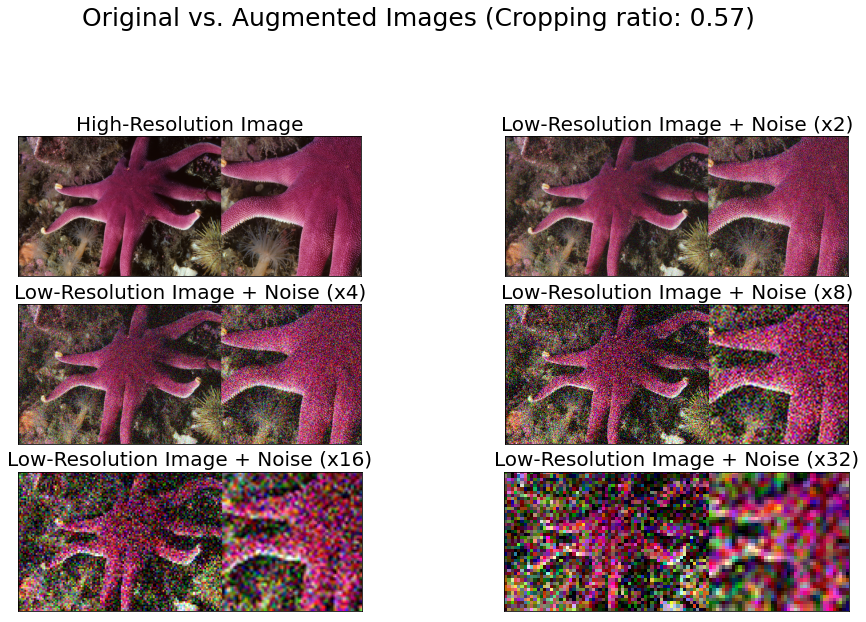

In [25]:
# Define import paths
import_path_hr = 'data/complete_dataset/HR'
import_path_lr_x2 = 'data/complete_dataset/LR/down_factor_x2'
import_path_lr_x4 = 'data/complete_dataset/LR/down_factor_x4'
import_path_lr_x8 = 'data/complete_dataset/LR/down_factor_x8'
import_path_lr_x16 = 'data/complete_dataset/LR/down_factor_x16'
import_path_lr_x32 = 'data/complete_dataset/LR/down_factor_x32'

# Define list of files in every import path
file_list_hr = os.listdir(import_path_hr)
file_list_lr_n_x2 = os.listdir(import_path_lr_n_x2)
file_list_lr_n_x4 = os.listdir(import_path_lr_n_x4)
file_list_lr_n_x8 = os.listdir(import_path_lr_n_x8)
file_list_lr_n_x16 = os.listdir(import_path_lr_n_x16)
file_list_lr_n_x32 = os.listdir(import_path_lr_n_x32)

# Define filename
filename_hr = os.path.join(import_path_hr, file_list_hr[0])
filename_lr_n_x2 = os.path.join(import_path_lr_n_x2, file_list_lr_n_x2[0])
filename_lr_n_x4 = os.path.join(import_path_lr_n_x4, file_list_lr_n_x4[0])
filename_lr_n_x8 = os.path.join(import_path_lr_n_x8, file_list_lr_n_x8[0])
filename_lr_n_x16 = os.path.join(import_path_lr_n_x16, file_list_lr_n_x16[0])
filename_lr_n_x32 = os.path.join(import_path_lr_n_x32, file_list_lr_n_x32[0])

# Read images
hr = io.imread(filename_hr)
lr_n_x2 = io.imread(filename_lr_n_x2)
lr_n_x4 = io.imread(filename_lr_n_x4)
lr_n_x8 = io.imread(filename_lr_n_x8)
lr_n_x16 = io.imread(filename_lr_n_x16)
lr_n_x32 = io.imread(filename_lr_n_x32)

# Data augmentation 3: apply random cropping to image

#   HR
#      Define cropped images length
cropped_length = int(hr.shape[0] * cropping_ratio)
#      Define random coordinates for bottom left corner of the cropping areas
x1 = int(np.random.uniform(0, hr.shape[0]-1 - cropped_length))
y1 = int(np.random.uniform(0, hr.shape[0]-1 - cropped_length))
#      Define x1 and y1 ratios to image shape, so the equivalent x1 and y1 can be defined for the low resolution images
x1_ratio = x1/hr.shape[0]
y1_ratio = y1/hr.shape[1]
#      Redefine x1 and y1 using ratios
x1 = int(hr.shape[0]*x1_ratio)
y1 = int(hr.shape[1]*y1_ratio)
#      Define random coordinates for top right corner of the cropping area
x2 = x1 + cropped_length
y2 = y1 + cropped_length
#      Crop images and labels
hr_aug3 = hr[x1:x2+1, y1:y2+1]
#      Upsample cropped images and labels to match with original image size
hr_aug3 = cv2.resize(hr_aug3, dsize=(hr.shape[0], hr.shape[0]), interpolation=cv2.INTER_CUBIC)    
    
#   (x2)
#      Define cropped images length
cropped_length = int(lr_n_x2.shape[0] * cropping_ratio)
#      Define random coordinates for bottom left corner of the cropping areas
x1 = int(lr_n_x2.shape[0]*x1_ratio)
y1 = int(lr_n_x2.shape[1]*y1_ratio)
#      Define random coordinates for top right corner of the cropping area
x2 = x1 + cropped_length
y2 = y1 + cropped_length
#      Crop images and labels
lr_n_x2_aug3 = lr_n_x2[x1:x2+1, y1:y2+1]
#      Upsample cropped images and labels to match with original image size
lr_n_x2_aug3 = cv2.resize(lr_n_x2_aug3, dsize=(lr_n_x2.shape[0], lr_n_x2.shape[0]), interpolation=cv2.INTER_CUBIC)    

#   (x4)
#      Define cropped images length
cropped_length = int(lr_n_x4.shape[0] * cropping_ratio)
#      Define random coordinates for bottom left corner of the cropping areas
x1 = int(lr_n_x4.shape[0]*x1_ratio)
y1 = int(lr_n_x4.shape[1]*y1_ratio)
#      Define random coordinates for top right corner of the cropping area
x2 = x1 + cropped_length
y2 = y1 + cropped_length
#      Crop images and labels
lr_n_x4_aug3 = lr_n_x4[x1:x2+1, y1:y2+1]
#      Upsample cropped images and labels to match with original image size
lr_n_x4_aug3 = cv2.resize(lr_n_x4_aug3, dsize=(lr_n_x4.shape[0], lr_n_x4.shape[0]), interpolation=cv2.INTER_CUBIC)    

#   (x8)
#      Define cropped images length
cropped_length = int(lr_n_x8.shape[0] * cropping_ratio)
#      Define random coordinates for bottom left corner of the cropping areas
x1 = int(lr_n_x8.shape[0]*x1_ratio)
y1 = int(lr_n_x8.shape[1]*y1_ratio)
#      Define random coordinates for top right corner of the cropping area
x2 = x1 + cropped_length
y2 = y1 + cropped_length
#      Crop images and labels
lr_n_x8_aug3 = lr_n_x8[x1:x2+1, y1:y2+1]
#      Upsample cropped images and labels to match with original image size
lr_n_x8_aug3 = cv2.resize(lr_n_x8_aug3, dsize=(lr_n_x8.shape[0], lr_n_x8.shape[0]), interpolation=cv2.INTER_CUBIC)    

#   (x16)
#      Define cropped images length
cropped_length = int(lr_n_x16.shape[0] * cropping_ratio)
#      Define random coordinates for bottom left corner of the cropping areas
x1 = int(lr_n_x16.shape[0]*x1_ratio)
y1 = int(lr_n_x16.shape[1]*y1_ratio)
#      Define random coordinates for top right corner of the cropping area
x2 = x1 + cropped_length
y2 = y1 + cropped_length
#      Crop images and labels
lr_n_x16_aug3 = lr_n_x16[x1:x2+1, y1:y2+1]
#      Upsample cropped images and labels to match with original image size
lr_n_x16_aug3 = cv2.resize(lr_n_x16_aug3, dsize=(lr_n_x16.shape[0], lr_n_x16.shape[0]), interpolation=cv2.INTER_CUBIC)  

#   (x32)
#      Define cropped images length
cropped_length = int(lr_n_x32.shape[0] * cropping_ratio)
#      Define random coordinates for bottom left corner of the cropping areas
x1 = int(lr_n_x32.shape[0]*x1_ratio)
y1 = int(lr_n_x32.shape[1]*y1_ratio)
#      Define random coordinates for top right corner of the cropping area
x2 = x1 + cropped_length
y2 = y1 + cropped_length
#      Crop images and labels
lr_n_x32_aug3 = lr_n_x32[x1:x2+1, y1:y2+1]
#      Upsample cropped images and labels to match with original image size
lr_n_x32_aug3 = cv2.resize(lr_n_x32_aug3, dsize=(lr_n_x32.shape[0], lr_n_x32.shape[0]), interpolation=cv2.INTER_CUBIC)  

# Combine original and augmented images into grid
grid_hr = np.hstack([hr, hr_aug3])
grid_x2 = np.hstack([lr_n_x2, lr_n_x2_aug3])
grid_x4 = np.hstack([lr_n_x4, lr_n_x4_aug3])
grid_x8 = np.hstack([lr_n_x8, lr_n_x8_aug3])
grid_x16 = np.hstack([lr_n_x16, lr_n_x16_aug3])
grid_x32 = np.hstack([lr_n_x32, lr_n_x32_aug3])

# Display augmentation results
#   Generate figure
plt.figure(figsize=(16,18))
plt.suptitle(f'Original vs. Augmented Images (Cropping ratio: {cropping_ratio:0.2f})', fontsize=25)

# Display high-resolution image
plt.subplot(621)
plt.imshow(grid_hr)
plt.title('High-Resolution Image', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

# Display downsampled-noisy images
plt.subplot(622)
plt.imshow(grid_x2)
plt.title('Low-Resolution Image + Noise (x2)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(623)
plt.imshow(grid_x4)
plt.title('Low-Resolution Image + Noise (x4)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(624)
plt.imshow(grid_x8)
plt.title('Low-Resolution Image + Noise (x8)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(625)
plt.imshow(grid_x16)
plt.title('Low-Resolution Image + Noise (x16)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.subplot(626)
plt.imshow(grid_x32)
plt.title('Low-Resolution Image + Noise (x32)', fontsize=20)
ax = plt.gca()
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

plt.show()

___
# Dataset Definition

To facilitate the import and formatting of the data and enable the use of PyTorch DataLoader, a new class called _ProcessedDataset_ is created.

This _ProcessedDataset_ class will also enable the random application of augmentation transformations (i.e. rotation and warping).

### Check mean image size
To define the resizing parameters, we need to know what is the mean width and height of the images that will be used as target (HR).

In [26]:
# Define import path (i.e. where the original HR images are located)
import_path = 'data/complete_dataset/LR/down_factor_x4'

# Generate list of items contained in import path
file_list = os.listdir(import_path)

# Initialize image shape lists
width_list = []
height_list = []

for file in file_list:

    # Define filename
    filename = os.path.join(import_path, file)

    # Read image
    img = io.imread(filename)
    
    # Append image shape to width and height lists
    width_list.append(img.shape[0])
    height_list.append(img.shape[1])

# Print mean shapes
print(f'\033[1mMean images width:\033[0m\t{np.mean(width_list):0.2f} [SD {np.std(width_list):0.2f}]')
print(f'\033[1mMean images height:\033[0m\t{np.mean(height_list):0.2f} [SD {np.std(height_list):0.2f}]')

Mean images width:	359.23 [SD 62.63]
Mean images height:	493.08 [SD 50.39]


## Dataset parameters

In [2]:
# Define data augmentation probability
#   e.g. if set to 0.5, each image has a 50% chance to be transformed
augmentation_probability = 0.5

# Define rotation angle range for data augmentation
#   e.g. if set to 5, each transformed image is randomly rotated by an angle comprised between -5 and +5 degrees
rotation_range = 5

# Define warping range for data augmentation
#   e.g. if set to 0.6, each transformed image is randomly resized along the x- and y-axes by a factor
#   comprised between 60% and 100% of the original image shape (with different factors for each direction).
#   The resize image is then re-resize to the original image shape by filling the cropped pixels with black pixels
#   (giving the impression of warping)
warping_range = 0.8

# Define cropping ratio range for data augmentation
#   e.g. if crop_lower_range = 0.5 and crop_upper_range = 0.8, each transformed image is randomly cropped
#   along the x- and y-axes by a factor comprised between 50% and 80% of the original image dimensions
crop_lower_range = 0.5
crop_upper_range = 0.8
cropping_ratio = np.random.uniform(crop_lower_range, crop_upper_range)

# Define resizing shapes
#   since not all images have the same shape, we need to define unique width and height that will be used
#   to reshape all images to the same unique size (necessary for the neural network)
#   these values were based on the mean width and height calculated over the entire dataset
resize_width = 360
resize_height = 480

# Define downsampling factor
downsampling_factor = 8

## Dataset class definition (including random data augmentation)

In [4]:
class ProcessedDataset(Dataset):
    
    def __init__(self, input_path, target_path, rotation=True, warping=True, cropping=True):
        '''
        ProcessedDataset(path, rotation=True, warping=True, cropping=True)
            Class enabling the definition of a dataset of 3D images with embedded augmentation strategies 
        Parameters:
            input_path: full path to input data (i.e. low resolution data)
                (type: string)
            target_path: full path to target data (i.e. high resolution data)
                (type: string)
            rotation: specifies whether rotation augmentation should be applied
                (type: boolean - True to apply rotation augmentation, False NOT to apply rotation augmentation)
                (default=True)
            warping: specifies whether warping augmentation should be applied
                (type: boolean - True to apply warping augmentation, False NOT to apply warping augmentation)
                (default=True)
            cropping: specifies whether cropping augmentation should be applied
                (type: boolean - True to apply cropping augmentation, False NOT to apply cropping augmentation)
                (default=True)
        '''
        
        # Generate paths towards low (input) and high (target) resolution images
        self.lr_path = input_path
        self.hr_path = target_path
        
        # Generate lists of filenames for all images and labels contained within corresponding directories (with full path)
        self.lr_files = list(map(lambda lr_file: os.path.join(self.lr_path, lr_file), sorted(os.listdir(self.lr_path))))
        self.hr_files = list(map(lambda hr_file: os.path.join(self.hr_path, hr_file), sorted(os.listdir(self.hr_path))))
        
        # Specify which augmentation strategies to apply
        self.rotation = rotation
        self.warping = warping
        self.cropping = cropping
        
    def __getitem__(self, index):
        
        # Get full paths to selected low (input) and high (target) resolution images
        lr_path = self.lr_files[index]
        hr_path = self.hr_files[index]

        # Read low (input) and high (target) resolution images
        lr_img = io.imread(lr_path)/255.0
        hr_img = io.imread(hr_path)/255.0
        
        # Data augmentation 1: apply random rotation to image (based on defined probability and range)
        if self.rotation:
            if np.random.uniform(0,1) >= augmentation_probability:
                angle = np.random.uniform(-rotation_range,rotation_range)
                lr_img = ndimage.rotate(lr_img, angle, axes=(0,1), reshape=False, order=1, cval=0)
                hr_img = ndimage.rotate(hr_img, angle, axes=(0,1), reshape=False, order=1, cval=0)
        
        # Data augmentation 2: apply random warping to image (based on defined probability and range)
        if self.warping:
            if np.random.uniform(0,1) >= augmentation_probability: 
                #   Generate random warping factors along x- and y-axes
                warping_x = np.random.uniform(warping_range,1)
                warping_y = np.random.uniform(warping_range,1)
                #   Save original shapes
                lr_x_shape, lr_y_shape = lr_img.shape[0], lr_img.shape[1]
                hr_x_shape, hr_y_shape = hr_img.shape[0], hr_img.shape[1]                
                #   Warp images and labels
                lr_img = ndimage.zoom(lr_img, (warping_x,warping_y,1), order=1, cval=0)
                hr_img = ndimage.zoom(hr_img, (warping_x,warping_y,1), order=1, cval=0)
                #   Calculate number of rows and columns to add shape
                lr_n_rows, lr_n_cols = lr_x_shape - lr_img.shape[0], lr_y_shape - lr_img.shape[1]
                hr_n_rows, hr_n_cols = hr_x_shape - hr_img.shape[0], hr_y_shape - hr_img.shape[1]
                #   Calculate padding shape
                #      LR
                if lr_n_rows%2 == 0 and lr_n_cols%2 == 0:
                    lr_pad_shape = ((int(lr_n_rows/2), int(lr_n_rows/2)),
                                    (int(lr_n_cols/2), int(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 != 0 and lr_n_cols%2 == 0:
                    lr_pad_shape = ((math.ceil(lr_n_rows/2), math.floor(lr_n_rows/2)),
                                    (int(lr_n_cols/2), int(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 == 0 and lr_n_cols%2 != 0:
                    lr_pad_shape = ((int(lr_n_rows/2), int(lr_n_rows/2)),
                                    (math.ceil(lr_n_cols/2), math.floor(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 != 0 and lr_n_cols%2 != 0:
                    lr_pad_shape = ((math.ceil(lr_n_rows/2), math.floor(lr_n_rows/2)),
                                    (math.ceil(lr_n_cols/2), math.floor(lr_n_cols/2)),
                                    (0,0))
                #      HR
                if hr_n_rows%2 == 0 and hr_n_cols%2 == 0:
                    hr_pad_shape = ((int(hr_n_rows/2), int(hr_n_rows/2)),
                                    (int(hr_n_cols/2), int(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 != 0 and hr_n_cols%2 == 0:
                    hr_pad_shape = ((math.ceil(hr_n_rows/2), math.floor(hr_n_rows/2)),
                                    (int(hr_n_cols/2), int(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 == 0 and hr_n_cols%2 != 0:
                    hr_pad_shape = ((int(hr_n_rows/2), int(hr_n_rows/2)),
                                    (math.ceil(hr_n_cols/2), math.floor(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 != 0 and hr_n_cols%2 != 0:
                    hr_pad_shape = ((math.ceil(hr_n_rows/2), math.floor(hr_n_rows/2)),
                                    (math.ceil(hr_n_cols/2), math.floor(hr_n_cols/2)),
                                    (0,0))
                #   Pad images and labels to match original shape
                lr_img = np.pad(lr_img, lr_pad_shape, 'constant', constant_values=0)
                hr_img = np.pad(hr_img, hr_pad_shape, 'constant', constant_values=0)
                
        # Data augmentation 3: apply random cropping to image (based on defined probability and range)
        if self.cropping:
            if np.random.uniform(0,1) >= augmentation_probability:
                #   Save original dimensions
                lr_dim = lr_img.shape
                hr_dim = hr_img.shape
                #   Define cropped images length
                cropped_length_lr = int(lr_dim[0] * cropping_ratio)
                cropped_length_hr = int(hr_dim[0] * cropping_ratio)
                #   Define random coordinates for bottom left corner of the cropping areas for high resolution images
                x1 = int(np.random.uniform(0, hr_dim[0]-1 - cropped_length_hr))
                y1 = int(np.random.uniform(0, hr_dim[1]-1 - cropped_length_hr))
                #   Define x1 and y1 ratios to high resolution images shape,
                #   so the equivalent x1 and y1 can be defined for the low resolution images
                x1_ratio = x1/hr_dim[0]
                y1_ratio = y1/hr_dim[1]
                #   Define random coordinates for bottom left corner of the cropping areas for
                #   low and high resolution images
                x1_lr = int(lr_dim[0]*x1_ratio)
                y1_lr = int(lr_dim[1]*y1_ratio)
                x1_hr = int(hr_dim[0]*x1_ratio)
                y1_hr = int(hr_dim[1]*y1_ratio)
                #   Define random coordinates for top right corner of the cropping area for low and high resolution images
                x2_lr = x1_lr + cropped_length_lr
                y2_lr = y1_lr + cropped_length_lr
                x2_hr = x1_hr + cropped_length_hr
                y2_hr = y1_hr + cropped_length_hr
                #   Crop images and labels
                lr_img = lr_img[x1_lr:x2_lr+1, y1_lr:y2_lr+1]
                hr_img = hr_img[x1_hr:x2_hr+1, y1_hr:y2_hr+1]
                #   Upsample cropped images and labels to match with original image size
                lr_img = cv2.resize(lr_img, dsize=(lr_dim[0], lr_dim[0]), interpolation=cv2.INTER_CUBIC) 
                hr_img = cv2.resize(hr_img, dsize=(hr_dim[0], hr_dim[0]), interpolation=cv2.INTER_CUBIC)   
        
        # Resize to defined fixed shapes
        lr_img = cv2.resize(lr_img,
                            dsize=(int(resize_height/downsampling_factor), int(resize_width/downsampling_factor)),
                            interpolation=cv2.INTER_CUBIC) 
        hr_img = cv2.resize(hr_img,
                            dsize=(resize_height, resize_width),
                            interpolation=cv2.INTER_CUBIC) 
        
        # Convert low (input) and high (target) resolution images from numpy.ndarray to torch.FloatTensor format
        lr_img_tensor = torch.FloatTensor(lr_img).permute(2,0,1)[:3,:,:]
        hr_img_tensor = torch.FloatTensor(hr_img).permute(2,0,1)[:3,:,:]
        
        return lr_img_tensor, hr_img_tensor
        
    def __len__(self):
        
        return len(self.lr_files)

## Dataset verification
To ensure that the _ProcessedDataset_ class was correctly implemented, we will use PyTorch's DataLoader function to generate and display the first batch of the _ProcessedDataset_.

### DataLoader parameters

In [30]:
# Define DataLoader parameters
batch_size = 5
num_workers = 0
pin_memory = False

### Generate and display first batch

LOW RESOLUTION First batch shape:	torch.Size([5, 3, 45, 60])
HIGH RESOLUTION First batch shape:	torch.Size([5, 3, 360, 480])


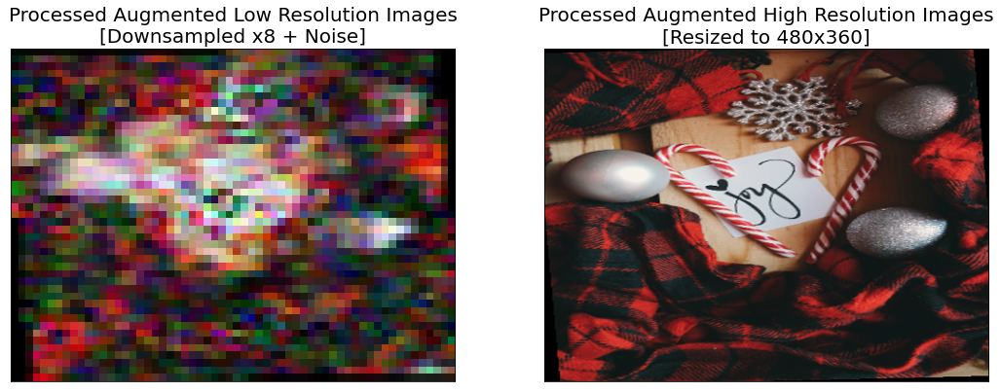

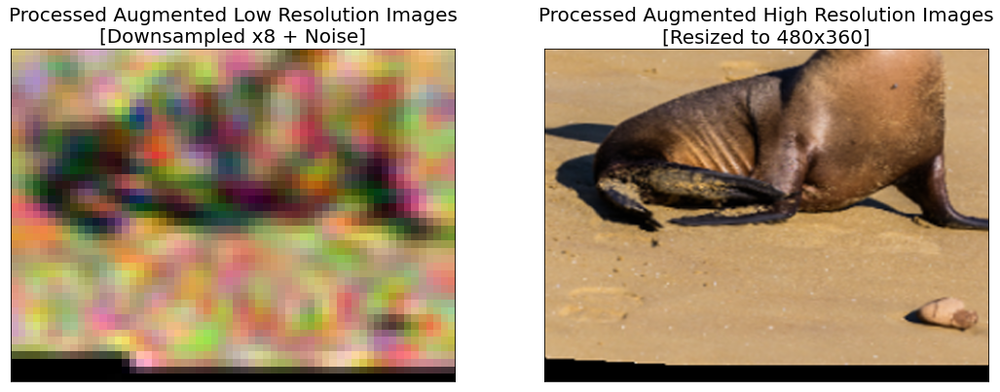

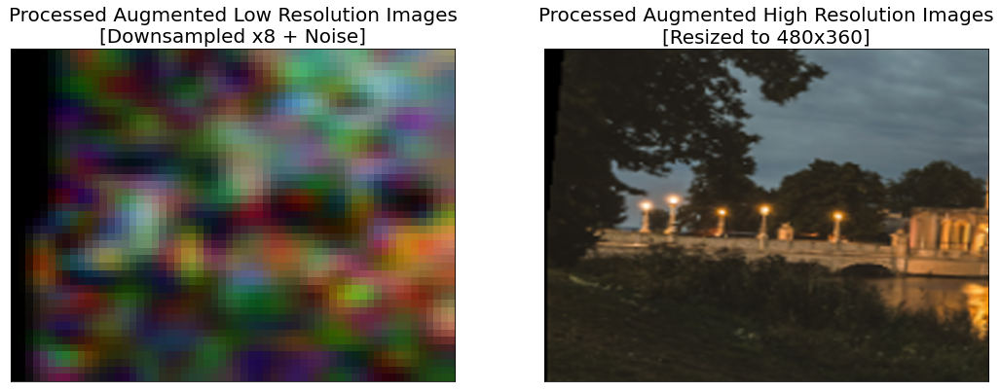

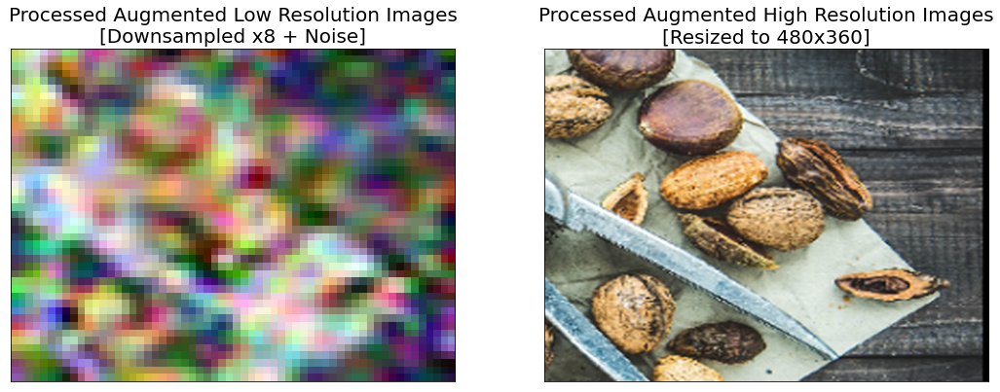

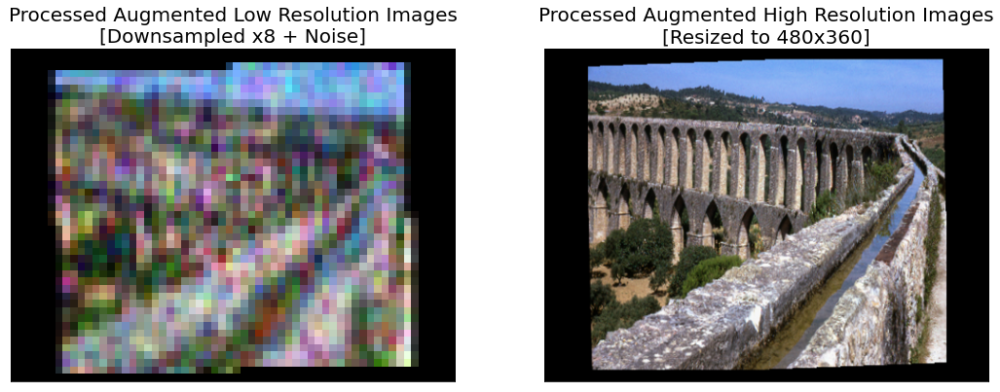

In [33]:
# Define path towards directory containing the processed images
input_path = "data/train/LR_Noise/down_factor_x32"
target_path = "data/train/LR/down_factor_x4"

# Generate dataset
train = ProcessedDataset(input_path, target_path, rotation=True, warping=True)

# Load dataset
train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

# Grab the first sample
for lr_imgs, hr_imgs in train_loader:
    break
    
# Print shape of the first batch
print(f'\033[1mLOW RESOLUTION First batch shape:\033[0m\t{lr_imgs.shape}')
print(f'\033[1mHIGH RESOLUTION First batch shape:\033[0m\t{hr_imgs.shape}')

# Display batch of images
#   Resize to a format that enables colors visualization and convert to numpy.ndarray 
lr_imgs_arr = lr_imgs.unsqueeze(1).permute(0,1,3,4,2).numpy()
hr_imgs_arr = hr_imgs.unsqueeze(1).permute(0,1,3,4,2).numpy()
#   Isolate the indices of 5 evenly distanced labeled frames and 
for i in range(batch_size):
    # Stack each new image along the x-axis to generate a grid of 5 stacked images
    lr = np.clip(lr_imgs_arr[i,0,:,:], 0, 1)
    hr = np.clip(hr_imgs_arr[i,0,:,:], 0, 1)
    
    # Display grids
    plt.figure(figsize=(18,8))

    plt.subplot(121)
    plt.imshow(lr, cmap='gray')
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    plt.title(f'Processed Augmented Low Resolution Images\n[Downsampled x{downsampling_factor} + Noise]', fontsize=20)

    plt.subplot(122)
    plt.imshow(hr, cmap='gray')
    plt.title(f'Processed Augmented High Resolution Images\n[Resized to {resize_height}x{resize_width}]', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

    plt.show()

## Augmentation verification
The concept of augmentation is that, for every epoch, the samples generate by the DataLoader will be slightly altered by the different augmentation strategies defined in the _ProcessedDataset_ class.

In other words, every time we enumerate through the _ProcessedDataset_ using PyTorch's DataLoader, the resulting samples will be loaded with a different set of random augmentation transformations. This process allows the network to better generalize, as a new set of images is used for every epoch instead of reusing the exact same set.

To better illustrate this, the cell below is only iterating through the DataLoader without generating a new _ProcessedDataset_ and should result in a different batch (i.e. shuffle images with different augmentation parameters) everytime the cell is run.

LOW RESOLUTION First batch shape:	torch.Size([5, 3, 45, 60])
HIGH RESOLUTION First batch shape:	torch.Size([5, 3, 360, 480])


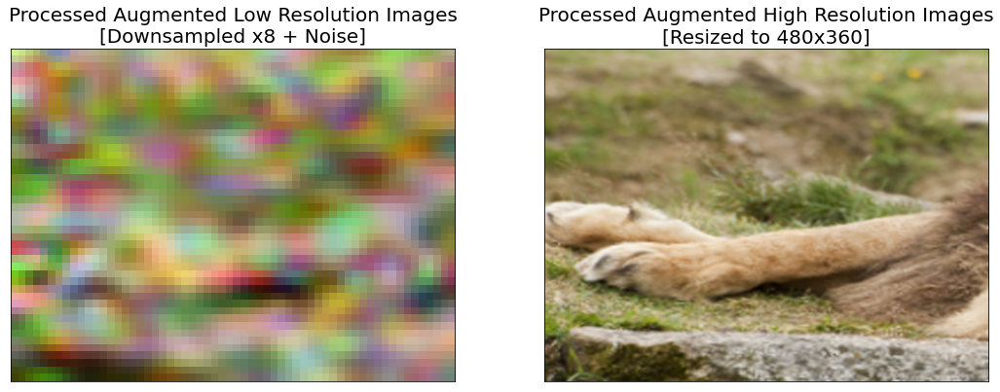

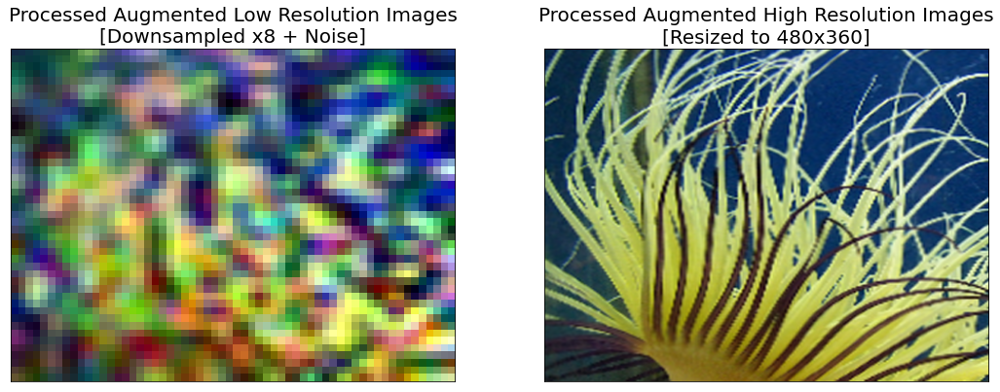

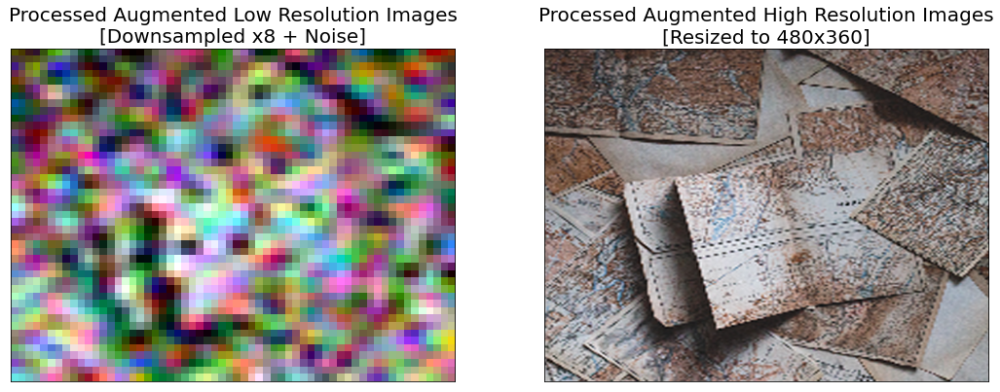

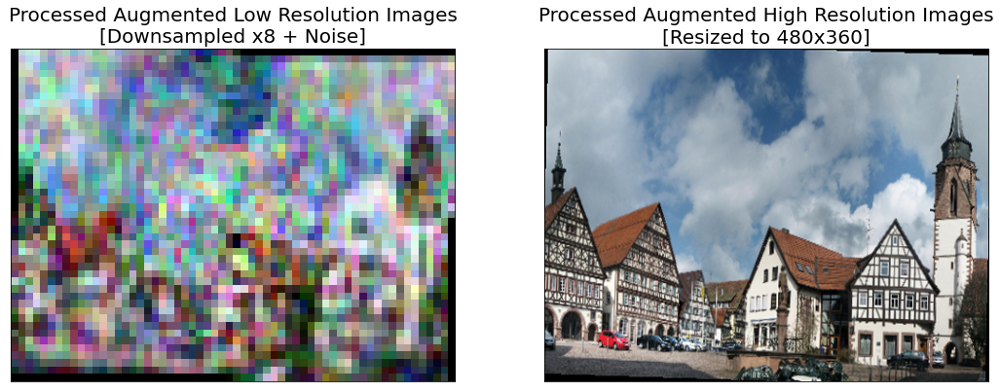

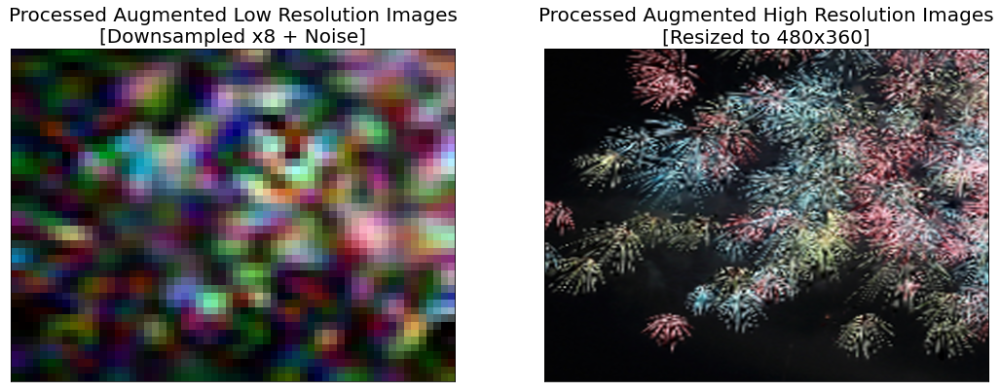

In [34]:
# Grab the first sample
for lr_imgs, hr_imgs in train_loader:
    break
    
# Print shape of the first batch
print(f'\033[1mLOW RESOLUTION First batch shape:\033[0m\t{lr_imgs.shape}')
print(f'\033[1mHIGH RESOLUTION First batch shape:\033[0m\t{hr_imgs.shape}')

# Display batch of images
#   Resize to a format that enables colors visualization and convert to numpy.ndarray 
lr_imgs_arr = lr_imgs.unsqueeze(1).permute(0,1,3,4,2).numpy()
hr_imgs_arr = hr_imgs.unsqueeze(1).permute(0,1,3,4,2).numpy()
#   Isolate the indices of 5 evenly distanced labeled frames and 
for i in range(batch_size):
    # Stack each new image along the x-axis to generate a grid of 5 stacked images
    lr = np.clip(lr_imgs_arr[i,0,:,:], 0, 1)
    hr = np.clip(hr_imgs_arr[i,0,:,:], 0, 1)
    
    # Display grids
    plt.figure(figsize=(18,8))

    plt.subplot(121)
    plt.imshow(lr, cmap='gray')
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    plt.title(f'Processed Augmented Low Resolution Images\n[Downsampled x{downsampling_factor} + Noise]', fontsize=20)

    plt.subplot(122)
    plt.imshow(hr, cmap='gray')
    plt.title(f'Processed Augmented High Resolution Images\n[Resized to {resize_height}x{resize_width}]', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

    plt.show()

___
# Model Implementation #1

This section provides details on:
- **General model architecture**
- **Model's blocks definition**
- **Super-Resolution Residual Neural Network definition**
- **Super-Resolution Generative Adversarial Residual Neural Network definition**
- **Loss function definition**

## General model architecture
The selected architecture was based off the work of Ledig et al. (2017) [1], who implemented a Deep Residual Neural Network (DRNN) that uses the concept of Generative Adversarial Network (GAN) to form a perceptual loss function for photo-realistic Single Image Super Resolution (SISR).

### Residual Neural Network (ResNet)
In order to increase the accuracy of a Neural Network, the first intuition is often to build a deeper architecture by adding more layers, therefore adding more parameters and allowing the model to adapt to more complex problems.

One very common issue with this approach is the vanishing gradient problem, which implies that when the Network is performing backpropagation (i.e. going through each layer one after the other to update their weights), the gradient becomes progressively smaller (i.e. vanishing) as it goes through more and more layers, which ultimately prevents certain deeper layers to be updated.

To prevent this, He et al. (2015) [2] introduced ResNet, a DRNN built on the concepts of residual blocks and skip connections, which allow the Network to skip certain blocks of layers. As a result, the Network is no longer suffering from the vanishing gradient, even when more layers are added.

_For more details, visit https://towardsdatascience.com/an-overview-of-resnet-and-its-variants-5281e2f56035_

### Generative Adversarial Network (GAN)
Introduced by Goodfellow et al. (2014) [3], GANs are composed of two main networks: the Generator and the Discriminator.

The purpose of the **Generator** is to generate data that will fool the Discriminator.

The purpose of the **Discriminator** is to classify the images generated by the Generator as Real or Fake data.

In the context of this work, the GAN architecture will be used not to discriminate between Real and Fake data, but between Low and High resolution images, which should dramatically help the Generator to better learn features from each image, until the Discriminator can no long find differences between the Super (model output) and High (target) resolution images.

### Architecture illustration, _from Ledig et al. (2017) [1]_

![png](img/GAN_architecture.png)

## Model's blocks definition
As seen in the illustration above, each network (Generator and Discriminator) consists of a series of blocks that have a similar architecture. As a result, to faciliate the definition and coding of the entire model, we will create a separate class for each block that composes the different networks. This will result in the definition of the following blocks:

- **Convolutional block**     
- **Sub-Pixel Convolutional block** 
- **Residual block** 

### Convolutional block
This block is the most repetitive block observed in both the Generator and Discriminator networks. This block will always start with a 2D Convolutional (Conv2D) layer and will also have the option to comprise (or not) a Batch Normalization (BN) layer as well as a defined Activation layer (i.e. PReLU or Leaky ReLU).

In [4]:
class ConvolutionalBlock(nn.Module):
    
    def __init__(self, input_channels, output_channels, kernel_size, stride=1, batch_norm=False, activation=None):
        '''
        ConvolutionalBlock(input_channels, output_channels, kernel_size, stride=1, batch_norm=False, activation=None)
            Convolutional block comprising a 2D Convolutional layer, as well as potential batch normalization (if True)
            and activation (if different from None) layers.
        Parameters:
            input_channels: specifies number of input channels
                (type: integer)
            output_channels: specifies number of output channels
                (type: integer)
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer)
            stride: specifies number of pixels by which the kernel moves during convolution
                (type: integer) (default=1)
            batch_norm: defines whether a Batch Normalization layer should be included
                (type: boolean - True for Yes, False for No)
            activation: define whether an Activation layer should be included, and if yes, what kind of activation
                (type: string - 'prelu' for PReLU, 'leakyrelu' for LeakyReLU, 'tanh' for 'Tanh')
        '''
        
        super(ConvolutionalBlock, self).__init__()
        
        # Initialize layers as a list (better for flexibility regarding the potential addition of BN or Activation layers)
        layers = []
        
        # Append 2D Convolutional layer to list of layers
        layers.append(nn.Conv2d(in_channels=input_channels, out_channels=output_channels,
                                     kernel_size=kernel_size, stride=stride, padding=kernel_size//2))
        
        # If set to True, append Batch Normalization layer to list of layers
        if batch_norm == True:
            layers.append(nn.BatchNorm2d(num_features=output_channels))
        
        # If different from None, append Activation layer to list of layers
        if activation == 'prelu':
            layers.append(nn.PReLU())
        elif activation == 'leakyrelu':
            layers.append(nn.LeakyReLU(0.2))
        elif activation == 'tanh':
            layers.append(nn.Tanh())
            
        # Combine layers into Sequential block
        self.conv_block = nn.Sequential(*layers)
    
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            output: ouput images (type: torch.FloatTensor
                                  shape: (number of samples, output_channels, width, height))
        '''
        
        output = self.conv_block(input)
        
        return output

### Residual block
This block is present in the Generator network and consists of two Convolutional Blocks and a residual connection (skip connection) that goes across them.

![jpg](img/residual_block.jpg)

In [5]:
class ResidualBlock(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64):
        '''
        ResidualBlock(kernel_size=3, num_channels=64)
            Residual block comprising two Convolutional blocks and a residual connection (skip connection)
            that goes across them.
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer) (default=3)
            num_channels: specifies number of channels
                (type: integer) (default=64)
        '''
        
        super(ResidualBlock, self).__init__()
        
        # Define first Convolutional block
        self.conv1 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=kernel_size, stride=1, batch_norm=True, activation='prelu')
        
        # Define second Convolutional block
        self.conv2 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=kernel_size, stride=1, batch_norm=True, activation=None)
        
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            ouput: output images (type: torch.FloatTensor,
                                  shape: (number of samples, input_channels, width, height))
        '''
        
        # Define residual (i.e. input images)
        residual = input
        
        # Pass input images through the two Convolutional blocks
        output = self.conv1(input)
        output = self.conv2(output)
        
        # Combine Convolutional output with residual
        output = output + residual
        
        return output

### Sub-Pixel Convolutional block
This block is present at the end of the Generator network and will always start with a 2D Convolutional (Conv2D) layer, followed by a Pixel Shuffler and an Activation layer (i.e. PReLU).

![jpg](img/sub-pixel_block.jpg)

In [6]:
class SubPixelConvolutionalBlock(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64, scaling_factor=2):
        '''
        SubPixelConvolutionalBlock(kernel_size=3, num_channels=64, scaling_factor=2)
            Sub-Pixel Convolutional block comprising a 2D Convolutional layer, as well as a Pixel Shuffle layer
            and a PReLU activation layer.
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer) (default=3)
            num_channels: specifies number of channels 
                (type: integer) (default=64)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=2) (range: can only be 2, 4 or 8)
        '''
        
        super(SubPixelConvolutionalBlock, self).__init__()
        
        # Define block within Sequential layer
        self.sub_pix_conv = nn.Sequential(nn.Conv2d(in_channels=num_channels, out_channels=num_channels*(scaling_factor**2),
                                                    kernel_size=kernel_size, padding=kernel_size//2),
                                          nn.PixelShuffle(upscale_factor=scaling_factor),
                                          nn.PReLU())
    
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            upscaled: upscaled images (type: torch.FloatTensor,
                                       shape: (number of samples, input_channels, width*scaling_factor, height*scaling_factor))
        '''
        
        upscaled = self.sub_pix_conv(input)
        
        return upscaled

## Super-Resolution Residual Neural Network definition
Now that the different building blocks have been defined, we can combine them and create a Super-Resolution Residual Neural Network (SRResNet) architecture, which will also be used as our Generator network.

This will give us the opportunity to compare a single SRResNet architecture with a Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet) architecture.

![jpg](img/SRResNet_architecture.jpg)

In [7]:
class SRResNet(nn.Module):
    
    def __init__(self, in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4):
        '''
        SRResNet(in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4)
            Super-Resolution Residual Neural Network (SRResNet) as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            in_out_kernel_size: specifies dimensions of convolutional kernels for first and last convolutions
                (i.e. input and output)
                (type: integer) (default=9)
            mid_kernel_size: specifies dimensions of convolutional kernels for all remaining convolutions
                (i.e. between input and output)
                (type: integer) (default=3)
            num_channels: specifies number of channels for the different blocks
                (type: integer) (default=64)
            num_blocks: specifies number of residual blocks
                (type: integer) (default=16)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=4) (range: can only be 2, 4 or 8)
        '''
        
        super(SRResNet, self).__init__()
        
        # Verify that scaling factor is either 2, 4 or 8, otherwise returns error
        assert scaling_factor in [2, 4, 8], 'Error: The scaling factor should be set to either 2, 4 or 8'
        
        # Define first Convolutional block
        self.conv1 = ConvolutionalBlock(input_channels=3, output_channels=num_channels,
                                       kernel_size=in_out_kernel_size, batch_norm=False, activation='prelu')
        
        # Define intermediate Residual blocks based on defined number of blocks
        self.residual = nn.Sequential(*[ResidualBlock(kernel_size=mid_kernel_size,
                                                      num_channels=num_channels) for i in range(num_blocks)])
        
        # Define intermediate Convolutional block
        self.conv2 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=in_out_kernel_size, batch_norm=True, activation=None)
        
        # Define Sub-Pixel Convolutional blocks, which enable the progressive increase in image resolution
        # (i.e. each Sub-Pixel Convolutional block is upscaling the image by a factor of two)
        #   Calculate number of Sub-Pixel Convolutional blocks based on SRRestNet scaling factor
        num_subpix_blocks = int(math.log2(scaling_factor))
        #   Define blocks
        self.subpix_conv = nn.Sequential(*[SubPixelConvolutionalBlock(kernel_size=mid_kernel_size,
                                                                      num_channels=num_channels,
                                                                      scaling_factor=2) for i in range(num_subpix_blocks)])
        
        # Define last Convolutional block
        self.conv3 = ConvolutionalBlock(input_channels=num_channels, output_channels=3,
                                        kernel_size=in_out_kernel_size, batch_norm=False, activation='tanh')
        
    def forward(self, lr_imgs):
        '''
        Enables forward propagation.
        Parameters:
            lr_imgs: low resolution images (type: torch.FloatTensor,
                                            shape: (number of samples, 3, width, height))
        Return:
            sr_imgs: super-resolution images (type: torch.FloatTensor,
                                              shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        '''
        
        # Pass low resolution images through first Convolutional block
        output = self.conv1(lr_imgs)
        
        # Define residual
        res = output
        
        # Pass output of first Convolutional block through Residual blocks
        output = self.residual(output)
        
        # Pass output of Residual blocks through intermediate Convolutional block
        output = self.conv2(output)
        
        # Combine output of intermediate Convolutional block with residual
        output = output + res
        
        # Pass combined output of intermediate Convolutional block and redisual through Sub-Pixel Convolutional blocks
        output = self.subpix_conv(output)
        
        # Pass output of Sub-Pixel Convolutional blocks through last Convolutional block
        sr_imgs = self.conv3(output)
        
        return sr_imgs

## Super-Resolution Generative Adversarial Residual Neural Network definition
### Generator definition
Here, the Generator that we intend to use in the SRGARestNet has the exact same architecture as the SRResNet defined above. As a result, the Generator network only requires to regenerate an instance of the SRResNet to be generated. We will also add the option to initialize the weights of this Generator using a pre-trained SRResNet for enhanced performance.

![jpg](img/generator_architecture.jpg)

In [8]:
class Generator(nn.Module):
    
    def __init__(self, in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4):
        '''
        Generator(in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4)
            Generator of the Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet)
            as defined by Ledig et al. (2017) (same architecture as SRRestNet).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            in_out_kernel_size: specifies dimensions of convolutional kernels for first and last convolutions
                (i.e. input and output)
                (type: integer) (default=9)
            mid_kernel_size: specifies dimensions of convolutional kernels for all remaining convolutions
                (i.e. between input and output)
                (type: integer) (default=3)
            num_channels: specifies number of channels for the different blocks
                (type: integer) (default=64)
            num_blocks: specifies number of residual blocks
                (type: integer) (default=16)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=4) (range: can only be 2, 4 or 8)
        '''
        
        super(Generator, self).__init__()
        
        # Generate Network by creating an instance of the SRResNet
        self.generator = SRResNet(in_out_kernel_size=in_out_kernel_size, mid_kernel_size=mid_kernel_size,
                                  num_channels=num_channels, num_blocks=num_blocks, scaling_factor=scaling_factor)
        
    def srresnet_init(self, srresnet_checkpoint_path):
        '''
        Initialize Generator's weights using the  pre-trained weights of the SRResNet.
        Parameters:
            srresnet_checkpoint_path: filepath to pre-trained srresnet checkpoint
        '''
        
        # Load pre-trained SRResNet weights
        srresnet = torch.load(srresnet_checkpoint_path)['model']
        
        # Initialize Generator's weights using pre-trained SRResNet weights
        self.generator.load_state_dict(srresnet.state_dict())
        
        # Display initialization statement
        print("\nGenerator's weights initialized using pre-trained SRResNet\n")
        
    def forward(self, lr_imgs):
        '''
        Enables forward propagation.
        Parameters:
            lr_imgs: low resolution images (type: torch.FloatTensor,
                                            shape: (number of samples, 3, width, height))
        Return:
            sr_imgs: super-resolution images (type: torch.FloatTensor,
                                              shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        '''
        
        # Pass low resolution images through Generator
        sr_imgs = self.generator(lr_imgs)
        
        return sr_imgs

### Discriminator definition
The architecture of the Discriminator network will follow the one defined by Ledig et al. (2017) [1].

![jpg](img/discriminator_architecture.jpg)

In [9]:
class Discriminator(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64, num_blocks=8, fc_size=1024):
        '''
        Discriminator(kernel_size=3, num_channels=64, num_blocks, fc_size=1024)
            Discriminator of the Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet)
            as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels for all convolutional blocks
                (type: integer) (default=3)
            num_channels: specifies number of output channels for the first convolutional block
                (doubles after every 2nd block)
                (type: integer) (default=64)
            num_blocks: specifies number of convolutional blocks
                (type: integer) (default=8)
            fc_size: defines number of units for first fully connected (dense) layer
                (type: integer) (default=1024)
        '''
        
        super(Discriminator, self).__init__()
        
        # Define initial number of input channels
        input_channels = 3
        
        # Initialize Convolutional blocks as a list
        conv_blocks = []
        
        # Append all intermediate Convolutional blocks
        #   For every even block (2nd, 4th, etc.), the number of channels is unchanged but the image size is halved
        #   For every odd block (3rd, 5th, etc.), the number of channels increases but the image size is unchanged
        for i in range(num_blocks):
            #   Update number of output channels, which is doubled every 2nd block and stride number
            output_channels = (num_channels if i == 0 else input_channels * 2) if i % 2 == 0 else input_channels
            
            #   Append intermediate Convolutional blocks
            conv_blocks.append(ConvolutionalBlock(input_channels=input_channels,
                                                  output_channels=output_channels,
                                                  kernel_size=kernel_size,
                                                  stride=1 if i%2 == 0 else 2,
                                                  batch_norm=i!=0,
                                                  activation='leakyrelu'))
            
            #   Update number of input channels based on previous block number of output channels
            input_channels = output_channels          
        
        # Combine Convolutional blocks into a Sequential block
        self.conv_blocks = nn.Sequential(*conv_blocks)
        
        # Define Adaptive Pooling layer, which which resize images to standard size
        # if input size is different from 96 and if there are more than 8 Convolutional blocks
        self.adaptive_pool = nn.AdaptiveAvgPool2d((6,6))
        
        # Define first Fully Connected (Dense) layer
        self.fc1 = nn.Linear(output_channels*6*6, fc_size)
        
        # Define Activation layer for first Fully Connnected (Dense) layer
        self.leaky = nn.LeakyReLU(0.2)
        
        # Define last Fully Connected (Dense) layer
        self.fc2 = nn.Linear(1024, 1)
        
    def forward(self, imgs):
        '''
        Enables forward propagation.
        Parameters:
            imgs: images to classify as either Super (model output) or High (target) Resolution  
                (type: torch.FloatTensor, shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        Return:
            score: classification score (type: float)
        '''
        
        # Identify batch size
        batch_size = imgs.size(0)
        
        # Pass images through the Convolutional blocks
        output = self.conv_blocks(imgs)
        
        # Pass output of Convolutional blocks through Adaptive Pooling layer
        output = self.adaptive_pool(output)
        
        # Pass output of Adaptive Pooling layer through first Fully Connected (Dense) layer
        output = self.fc1(output.view(batch_size, -1))
        
        # Pass output of first Fully Connected (Dense) layer through Activation layer
        output = self.leaky(output)
        
        # Pass output of Activation layer through last Fully Connected (Dense) layer
        score = self.fc2(output)
        
        return score

## Loss function definition
In many image transformation problems, the pixel-wise Mean Squared Error (MSE) (i.e. difference between the pixel value of the target and the model's output) is often used as a loss function. However, this kind of approach has shown to struggle with high-frequency details as it often leads the model to learn a pixel-wise average solution that can possibly smoothen/lose important image features.

As a result, based on the work of Johnson et al. (2016) [4] and Bruna et al. (2016) [5], Ledig et al. (2017) [1] proposed to use the concept of **Perceptual loss**.

### Perceptual loss definition
The main idea behind the concept of Perceptual loss is that we want the model to learn higher level image features (i.e. perceptual features) rather than focusing on pixel-wise differences. This becomes specifically important for applications such as Super Resolution or Style Transfer, where we want the model to retain higher frequency image features that can be critical when evaluating the quality and fidelity of the model's outcome.

A Perceptual loss can be divided into two sub-losses:
- **Content loss:** designed to help the model learn how to generate an image that is similar to the target;
- **Adversarial loss:** designed to help the model learn higher level features that will help fool the discriminator.

### Content loss
In the work of Ledig et al. (2017) [1], the Content loss was defined as a function that tries to minimize the euclidean distance between the feature maps of the Super (model output) and High (target) Resolution images. Those feature maps were extracted from a pre-trained VGG network (i.e. a well-known Convolutional Neural Network (CNN) architecture originally proposed by Simonyan et al. (2015) [6]), which was implemented with 19 layers (VGG19).

In terms of implementation, the Content loss will be defined as PyTorch's MSELoss function and applied to the output (i.e. feature maps) of a truncated pre-trained VGG network applied to the Super (model output) and High (target) Resolution images.

### Adversarial loss
In the work of Ledig et al. (2017) [1], the Adversarial loss was defined based on the probability generated by the Discriminator.

In terms of implementation, the Adversarial loss will be defined as PyTorch's BCEWithLogitsLoss function (with BCE standing for Binary Cross-Entropy) and applied to the output of the Discriminator network.

### Truncated VGG19 definition
As mentioned above, a truncated VGG19 network needs to be defined as its output will be used when calculating the Content loss. The reason why the network has to be truncated is because we want to extract _the feature map obtained by the j-th convolution (after activation) before the i-th maxpooling layer_ [1], which can then be used to calculate the euclidean distance between the resulting VGG feature spaces of the Super (model output) and High (target) Resolution images.

In [10]:
class TruncatedVGG19(nn.Module):
    
    def __init__(self, i, j):
        '''
        TruncatedVGG19(i, j)
            Truncated VGG19 network used to extract the feature map obtained by the j-th convolution (after activation)
            before the i-th maxpooling layer, as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            i: specifies the index of the i-th maxpooling layer
                (type: integer)
            j: specifies the index of the j-th convolution layer
                (type: integer)
        '''
        
        super(TruncatedVGG19, self).__init__()
        
        # Load pre-trained VGG19 network (available in the torchvision library)
        vgg19 = torchvision.models.vgg19(pretrained=True)
        
        # Initialize indices for convolution and maxpooling layers
        conv_count = 0
        maxpool_count = 0
        
        # Iterate through all layers of the pre-trained VGG19 network until the truncation conditions have been reached
        for layer_idx, layer in enumerate(vgg19.features.children(), start=1):
            
            # Update truncation index
            truncation_idx = layer_idx
            
            # Keep count of convolution and maxpooling layers
            if isinstance(layer, nn.Conv2d):
                conv_count += 1
            if isinstance(layer, nn.MaxPool2d):
                maxpool_count += 1
                conv_count = 0
                
            # Break out of the for loop when the j-th convolution and the (i-1)-th maxpooling layer have been reached
            if conv_count == j and maxpool_count == i-1:
                break

        # Ensure that the truncation conditions are satisfied
        assert conv_count == j and maxpool_count == i-1, 'Truncation conditions for VGG19 invalid! Check values of i and j.'
        
        # Define new truncated VGG19 network
        self.truncated_vgg19 = nn.Sequential(*list(vgg19.features.children())[:truncation_idx+1])
        
    def forward(self, imgs):
        '''
        Enables forward propagation.
        Parameters:
            imgs: images to classify as either Super (model output) or High (target) Resolution 
                (type: torch.FloatTensor, shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        Return:
            feature_map: the resulting VGG19 feature map
                (type: torch.FloatTensor,
                shape: (number of samples, feature map number of channels, feature map width, feature map height))
        '''
        
        # Pass images through the Truncated VGG19 network
        feature_map = self.truncated_vgg19(imgs)
        
        return feature_map

## Implementation #1: Training

We will start by using the following images as low (model input) and high (model target) resolution samples for the training of each network:

- **Input images:** Downsampled images with resolution of 64x64 and with added noise
- **Target images:** Original 512x512 images
- **Resulting scaling factor:** 8 (-> 512/64)

### SRResNet training
Before training the SRGAResNet, we will start by training the SRResNet, which outcome will be used for 1) comparison, and 2) to enable the SRGAResNet to start its own training using the pre-trained weights of the SResNet.

Completed epochs:    1/500 | Content loss: 2.71e-02 | Time elapsed:  0 hrs  1 mins  2 secs
Completed epochs:   10/500 | Content loss: 1.60e-02 | Time elapsed:  0 hrs 11 mins  3 secs
Completed epochs:   20/500 | Content loss: 2.02e-02 | Time elapsed:  0 hrs 22 mins 15 secs
Completed epochs:   30/500 | Content loss: 1.78e-02 | Time elapsed:  0 hrs 34 mins  9 secs
Completed epochs:   40/500 | Content loss: 1.25e-02 | Time elapsed:  0 hrs 45 mins 28 secs
Completed epochs:   50/500 | Content loss: 1.63e-02 | Time elapsed:  0 hrs 57 mins 31 secs

	Checkpoint -> Model saved at   50/500 epochs

Completed epochs:   60/500 | Content loss: 1.68e-02 | Time elapsed:  1 hrs  9 mins 30 secs
Completed epochs:   70/500 | Content loss: 1.83e-02 | Time elapsed:  1 hrs 21 mins 20 secs
Completed epochs:   80/500 | Content loss: 1.04e-02 | Time elapsed:  1 hrs 32 mins 24 secs
Completed epochs:   90/500 | Content loss: 9.18e-03 | Time elapsed:  1 hrs 43 mins 20 secs
Completed epochs:  100/500 | Content loss:

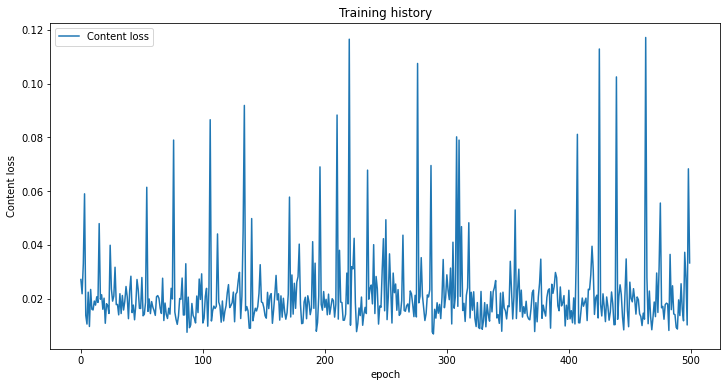


Total computing time:  9 hrs  7 mins 38 secs


In [6]:
# Define path towards directory containing the processed images
input_path = "data/train/LR/down_factor_x32"
target_path = "data/train/LR/down_factor_x4"

# Define number of epochs
epochs = 500

# Define DataLoader parameters
batch_size = 3
num_workers = 0
pin_memory = False

# Define model parameters
in_out_kernel_size = 9
mid_kernel_size = 3
num_channels = 64
num_blocks = 16

# Define path to previously trained model
pre_trained_path = None

# Define frequency of print statements (i.e. every how many epochs to print training progress)
print_checkpoint = 10

# Define checkpoint (i.e. number of epochs after which the model will be saved)
checkpoint = 50

# Define learning rate
lr = 0.0001

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True
    
# Generate dataset
train = ProcessedDataset(input_path, target_path, rotation=True, warping=True)

# Load dataset
train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

# Calculate scaling factor based on input and target images shapes
#   Grab the first sample to extract LR and HR images dimensions 
for lr_imgs, hr_imgs in train_loader:
    break
#   Calculate corresponding scaling factor
scaling_factor = int(hr_imgs.shape[2]/lr_imgs.shape[2])

# Initialize model and optimizer or load pre-trained model (if pre_trained_path different from None)
if pre_trained_path == None:
    # Create instance of SRRestNet
    model = SRResNet(in_out_kernel_size=in_out_kernel_size,
                     mid_kernel_size=mid_kernel_size,
                     num_channels=num_channels,
                     num_blocks=num_blocks,
                     scaling_factor=scaling_factor)
    # Initialize SRResNet optimizer
    optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
    # Define starting epoch number
    start_epoch = 1
else:
    # Load pre-trained model information
    pre_trained = torch.load(pre_trained_path)
    # Load pre-trained model
    model = pre_trained['model']
    # Load optimizer
    optimizer = pre_trained['optimizer']
    # Define starting epoch number based on last trained epoch of loaded model
    start_epoch = pre_trained['epoch'] + 1
    
# Assign model to available device ('cuda' or 'cpu')
model = model.to(device)

# Define loss function (for SRResNet, only need to specify the Content loss, which is usually PyTorch's MSELoss function)
criterion = nn.MSELoss().to(device)

# Initialize mean epoch loss tracker (-> one mean loss value per epoch)
mean_epoch_loss = []

# Initialize time tracker
start_time = time()

# Start training
for epoch in range(start_epoch, epochs+1):
    
    # Set model to training mode
    model.train()
    
    # Initialize mean sample loss tracker (-> one mean loss value per sample)
    mean_sample_loss = []
    
    # Loop through training samples
    for lr_imgs, hr_imgs in train_loader:
        
        # Assign images to available device ('cuda' or 'cpu')
        lr_imgs = lr_imgs.to(device)
        hr_imgs = hr_imgs.to(device)
        
        # Pass low resolution images through model
        sr_imgs = model(lr_imgs)
        
        # Calculate batch loss
        loss = criterion(sr_imgs, hr_imgs)
        
        # Append loss to mean sample loss tracker
        mean_sample_loss.append(loss.item())
        
        # Update model parameters
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Delete current samples to save memory
        del lr_imgs, hr_imgs, sr_imgs
        
    # Append loss to mean epoch loss tracker
    mean_epoch_loss.append(loss.item())    
    
    # Print update statement for tracking
    if epoch == 1  or epoch%print_checkpoint == 0:
        current_time = time() - start_time
        print(f'\033[1mCompleted epochs:\033[0m {epoch:4.0f}/{epochs} | '
              f'\033[1mContent loss:\033[0m {loss.item():.2e} | '
              f'\033[1mTime elapsed:\033[0m {current_time//3600:2.0f} hrs '
              f'{(current_time - current_time//3600*3600)//60:2.0f} mins '
              f'{current_time%60:2.0f} secs')

    # Save model every checkpoint
    if epoch%checkpoint == 0:
        #   Define current model state using dictionary
        model_state = {'epoch': epoch, 'model': model, 'optimizer': optimizer}
        #   Save current model
        torch.save(model_state, 'models/SRResNet/SRResNet_' + str(epoch) + '.pt')
        # Generate loss history DataFrame
        loss_history = pd.DataFrame(mean_epoch_loss, columns=['Content loss'])
        # Save loss history
        loss_history.to_csv('history/SRResNet/SRResNet_' + str(epoch) + '.csv')
        #   Print save statement
        print(f'\n\tCheckpoint -> Model saved at {epoch:4.0f}/{epochs} epochs\n')

# Save final model
#   Define current model state using dictionary
model_state = {'epoch': epoch, 'model': model, 'optimizer': optimizer}
#   Save current model
torch.save(model_state, 'models/SRResNet/SRResNet_' + str(epoch) + '.pt')

# Generate loss history DataFrame
loss_history = pd.DataFrame(mean_epoch_loss, columns=['Content loss'])

# Save loss history
loss_history.to_csv('history/SRResNet/SRResNet_' + str(epoch) + '.csv')

# Plot training history
loss_history.plot(figsize=(12,6))
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Content loss')
plt.title('Training history')
plt.show()

# Print total computing time
total_time = time() - start_time
print(f'\033[1m\nTotal computing time:\033[0m {total_time//3600:2.0f} hrs '
      f'{(total_time - total_time//3600*3600)//60:2.0f} mins '
      f'{total_time%60:2.0f} secs')

### SRGAResNet training
Here, the model will be initialized using the weights of the pre-trained SRResNet (trained above). In addition, the Content loss will be calculated on the feature maps extracted from the Truncated VGG19 network.


Generator's weights initialized using pre-trained SRResNet

Completed epochs:    1/200 | Generator loss: 1.12e-01 | Discriminator loss: 1.05e-05 | Time elapsed:  0 hrs  2 mins 19 secs
Completed epochs:   10/200 | Generator loss: 1.13e-01 | Discriminator loss: 2.38e-07 | Time elapsed:  0 hrs 23 mins 30 secs
Completed epochs:   20/200 | Generator loss: 2.24e-01 | Discriminator loss: 0.00e+00 | Time elapsed:  0 hrs 50 mins 19 secs
Completed epochs:   30/200 | Generator loss: 1.37e-01 | Discriminator loss: 0.00e+00 | Time elapsed:  1 hrs 16 mins 23 secs
Completed epochs:   40/200 | Generator loss: 2.74e-01 | Discriminator loss: 0.00e+00 | Time elapsed:  1 hrs 38 mins 39 secs
Completed epochs:   50/200 | Generator loss: 1.38e-01 | Discriminator loss: 0.00e+00 | Time elapsed:  2 hrs  0 mins 54 secs

	Checkpoint -> Model saved at   50/200 epochs

Completed epochs:   60/200 | Generator loss: 8.40e-02 | Discriminator loss: 0.00e+00 | Time elapsed:  2 hrs 24 mins  2 secs
Completed epochs:   70/

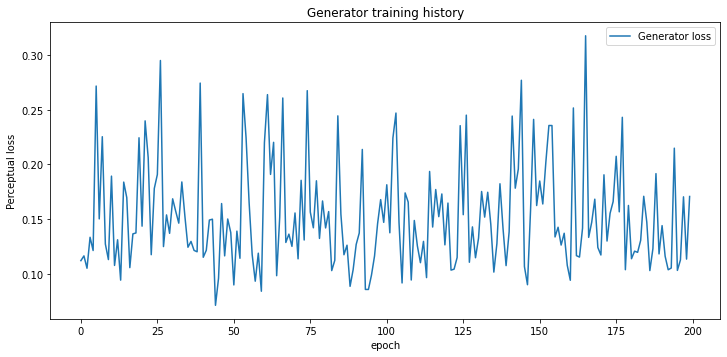

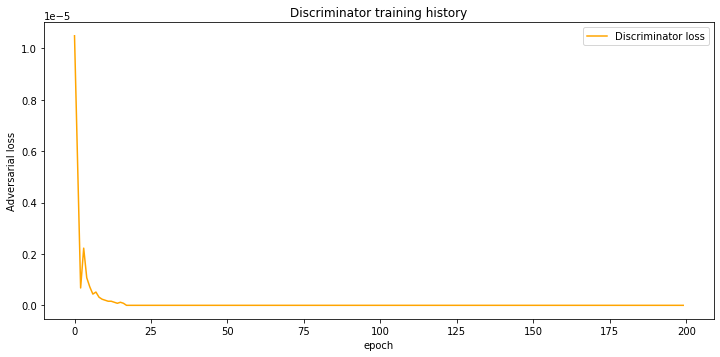


Total computing time:  7 hrs 52 mins 10 secs


In [12]:
# Define path towards directory containing the processed images
input_path = "data/train/LR/down_factor_x32"
target_path = "data/train/LR/down_factor_x4"

# Define number of epochs
epochs = 200

# Define starting epoch number
start_epoch = 1

# Define DataLoader parameters
batch_size = 3
num_workers = 0
pin_memory = False

# Define Generator parameters
in_out_kernel_size = 9
mid_kernel_size = 3
num_channels_g = 64
num_blocks_g = 16

# Use pre-trained Generator? (using the trained SRResNet)
pretrained_generator = True
srresnet_checkpoint_path = 'models/SRResNet/SRResNet_500.pt'

# Define Discriminator parameters
kernel_size = 3
num_channels_d = 64
num_blocks_d = 8
fc_size = 1024
beta = 0.001

# Define Truncated VGG19 parameters
vgg19_i = 5
vgg19_j = 4

# Define frequency of print statements (i.e. every how many epochs to print training progress)
print_checkpoint = 10

# Define checkpoint (i.e. number of epochs after which the model will be saved)
checkpoint = 50

# Define learning rate
lr = 0.0001

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True
    
# Generate dataset
train = ProcessedDataset(input_path, target_path, rotation=True, warping=True)

# Load dataset
train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

# Calculate scaling factor based on input and target images shapes
#   Grab the first sample to extract LR and HR images dimensions 
for lr_imgs, hr_imgs in train_loader:
    break
#   Calculate corresponding scaling factor
scaling_factor = int(hr_imgs.shape[2]/lr_imgs.shape[2])
   
# Initialize Generator
#   Create instance of Generator
generator = Generator(in_out_kernel_size=in_out_kernel_size,
                      mid_kernel_size=mid_kernel_size,
                      num_channels=num_channels_g,
                      num_blocks=num_blocks_g,
                      scaling_factor=scaling_factor)
#   Initialize Generator using weights from pre-trained SRResNet
if pretrained_generator:
    generator.srresnet_init(srresnet_checkpoint_path=srresnet_checkpoint_path)

# Initialize Discriminator
#   Create instance of Discriminator
discriminator = Discriminator(kernel_size=kernel_size,
                              num_channels=num_channels_d,
                              num_blocks=num_blocks_d,
                              fc_size=fc_size)

# Truncated VGG19 (needed to calculate the Content loss)
#   Create instance of TruncatedVGG19
truncated_vgg19 = TruncatedVGG19(i=vgg19_i, j=vgg19_j)
#   Specify that the TruncatedVGG19 network is only used in evaluation mode (no additional training)
truncated_vgg19.eval()

# Loss functions
#   Define Content loss
content_loss_criterion = nn.MSELoss().to(device)
#   Define Adversarial loss
adversarial_loss_criterion = nn.BCEWithLogitsLoss().to(device)
#   Initialize mean epoch losses tracker
mean_epoch_generator_loss = []
mean_epoch_discriminator_loss = []

# Iniatialize optimizers
optimizer_g = torch.optim.Adam(params=filter(lambda p: p.requires_grad, generator.parameters()), lr=lr)
optimizer_d = torch.optim.Adam(params=filter(lambda p: p.requires_grad, discriminator.parameters()), lr=lr)

# Assign models to available device ('cuda' or 'cpu')
generator = generator.to(device)
discriminator = discriminator.to(device)
truncated_vgg19 = truncated_vgg19.to(device)

# Initialize time tracker
start_time = time()

# Start training
for epoch in range(start_epoch, epochs+1):
    
    # Set models to training mode
    generator.train()
    discriminator.train()
    
    # Initialize mean sample losses tracker
    mean_sample_generator_loss = []
    mean_sample_discriminator_loss = []
    
    # Loop through training samples
    for lr_imgs, hr_imgs in train_loader:
        
        # Assign images to available device ('cuda' or 'cpu')
        lr_imgs = lr_imgs.to(device)
        hr_imgs = hr_imgs.to(device)
        
        # GENERATOR UPDATE
        
        #   Pass low resolution images through Generator
        sr_imgs = generator(lr_imgs)
        
        #   Generate VGG19 feature maps for both low and high resolution images
        sr_imgs_feature_map = truncated_vgg19(sr_imgs)
        hr_imgs_feature_map = truncated_vgg19(hr_imgs).detach()
        
        #   Discriminate super resolution images
        sr_discriminated = discriminator(sr_imgs)
        
        #   Calculate Perceptual loss
        content_loss = content_loss_criterion(sr_imgs_feature_map, hr_imgs_feature_map)
        adversarial_loss = adversarial_loss_criterion(sr_discriminated, torch.ones_like(sr_discriminated))
        perceptual_loss = content_loss + beta*adversarial_loss
        
        # Append loss to mean sample loss tracker
        mean_sample_generator_loss.append(perceptual_loss.item())
        
        # Update Generator parameters
        optimizer_g.zero_grad()
        perceptual_loss.backward()
        optimizer_g.step()
        
        # DISCRIMINATOR UPDATE
        
        #   Discriminate both super and high resolution images
        #      Note: while we already applied the discriminator to the super resolution images above,
        #      we still need to re-apply it here as using the same sr_discriminated as define above
        #      would lead to impact the backpropagation process of the Generator, while we are only
        #      looking at updating the Discriminator.        
        hr_discriminated = discriminator(hr_imgs)
        sr_discriminated = discriminator(sr_imgs.detach())
        
        #   Calculate Adversarial loss
        adversarial_loss_sr = adversarial_loss_criterion(sr_discriminated, torch.zeros_like(sr_discriminated))
        adversarial_loss_hr = adversarial_loss_criterion(hr_discriminated, torch.zeros_like(hr_discriminated))
        adversarial_loss = adversarial_loss_sr + adversarial_loss_hr
        
        # Append loss to mean sample loss tracker
        mean_sample_discriminator_loss.append(adversarial_loss.item())
        
        # Update Generator parameters
        optimizer_d.zero_grad()
        adversarial_loss.backward()
        optimizer_d.step()
        
        # Delete current samples to save memory
        del lr_imgs, hr_imgs, sr_imgs, sr_imgs_feature_map, hr_imgs_feature_map, sr_discriminated, hr_discriminated
        
    # Append losses to mean epoch losses tracker
    mean_epoch_generator_loss.append(perceptual_loss.item())
    mean_epoch_discriminator_loss.append(adversarial_loss.item())   
    
    # Print update statement for tracking
    if epoch == 1 or epoch%print_checkpoint == 0:
        current_time = time() - start_time
        print(f'\033[1mCompleted epochs:\033[0m {epoch:4.0f}/{epochs} | '
              f'\033[1mGenerator loss:\033[0m {perceptual_loss.item():.2e} | '
              f'\033[1mDiscriminator loss:\033[0m {adversarial_loss.item():.2e} | '
              f'\033[1mTime elapsed:\033[0m {current_time//3600:2.0f} hrs '
              f'{(current_time - current_time//3600*3600)//60:2.0f} mins '
              f'{current_time%60:2.0f} secs')

    # Save model every checkpoint
    if  epoch%checkpoint == 0:
        #   Define current model state using dictionary
        model_state = {'epoch': epoch,
                       'generator': generator,
                       'discriminator': discriminator,
                       'optimizer_g': optimizer_g,
                       'optimizer_d': optimizer_d}
        #   Save current model
        torch.save(model_state, 'models/SRGAResNet/Implementation 1/SRGAResNet_' + str(epoch) + '.pt')
        # Generate losses history DataFrame
        losses_history = pd.DataFrame(np.transpose([mean_epoch_generator_loss,
                                      mean_epoch_discriminator_loss]),
                                      columns=['Generator loss', 'Discriminator loss'])
        # Save loss history
        losses_history.to_csv('history/SRGAResNet/Implementation 1/SRGAResNet_' + str(epoch) + '.csv')
        #   Print save statement
        print(f'\n\tCheckpoint -> Model saved at {epoch:4.0f}/{epochs} epochs\n')

# Save final model
#   Define current model state using dictionary
model_state = {'epoch': epoch,
               'generator': generator,
               'discriminator': discriminator,
               'optimizer_g': optimizer_g,
               'optimizer_d': optimizer_d}
#   Save current model
torch.save(model_state, 'models/SRGAResNet/Implementation 1/SRGAResNet_' + str(epoch) + '.pt')

# Generate losses history DataFrame
losses_history = pd.DataFrame(np.transpose([mean_epoch_generator_loss,
                              mean_epoch_discriminator_loss]),
                              columns=['Generator loss', 'Discriminator loss'])

# Save loss history
losses_history.to_csv('history/SRGAResNet/Implementation 1/SRGAResNet_' + str(epoch) + '.csv')

# Plot training history
#   Generator
plt.subplot(211)
losses_history['Generator loss'].plot(figsize=(12,12))
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Perceptual loss')
plt.legend()
plt.title('Generator training history')
plt.show()
#   Discriminator
plt.subplot(212)
losses_history['Discriminator loss'].plot(figsize=(12,12), c='orange')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Adversarial loss')
plt.legend()
plt.title('Discriminator training history')
plt.show()

# Print total computing time
total_time = time() - start_time
print(f'\033[1m\nTotal computing time:\033[0m {total_time//3600:2.0f} hrs '
      f'{(total_time - total_time//3600*3600)//60:2.0f} mins '
      f'{total_time%60:2.0f} secs')

## Implementation #1: Evaluation

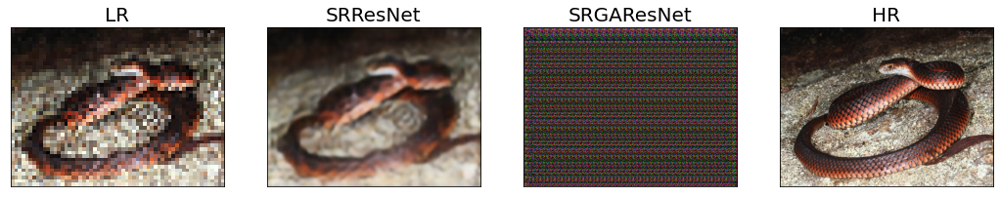

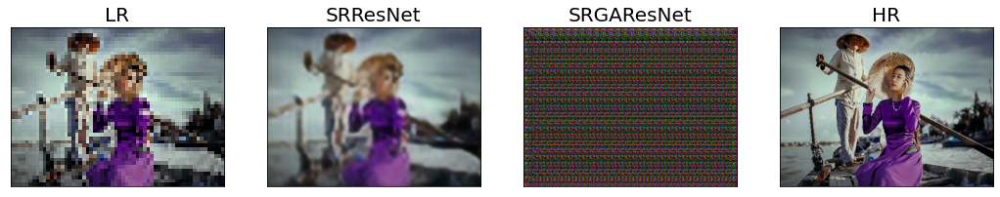

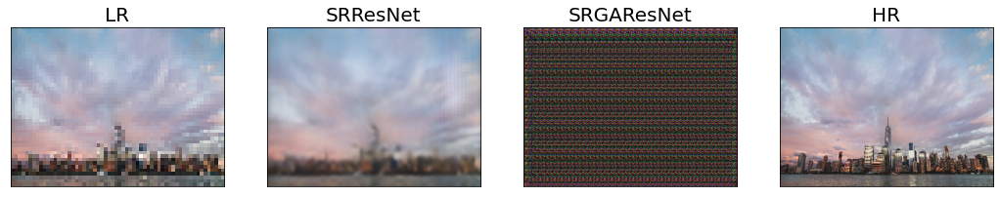

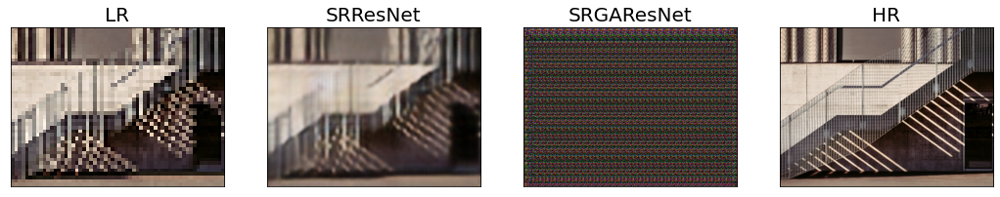

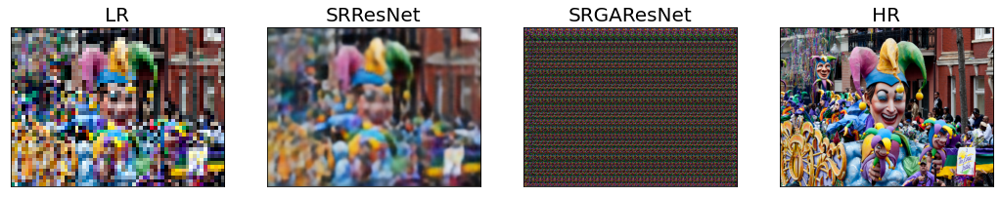

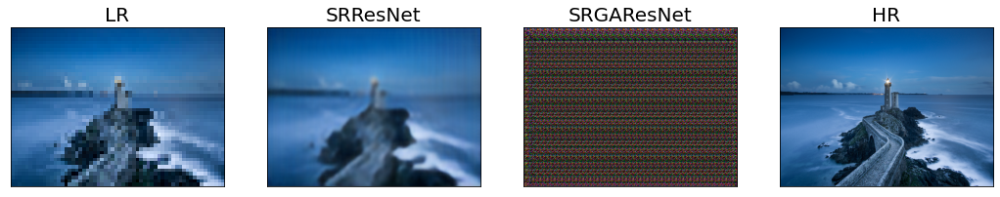

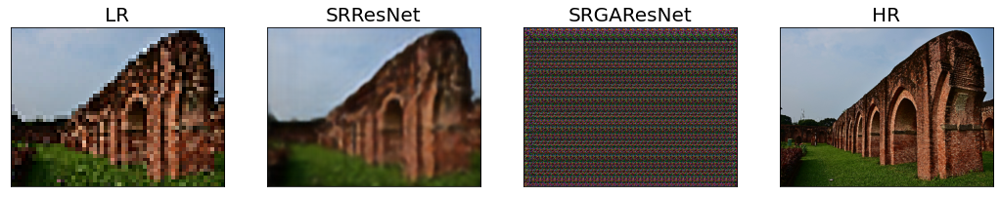

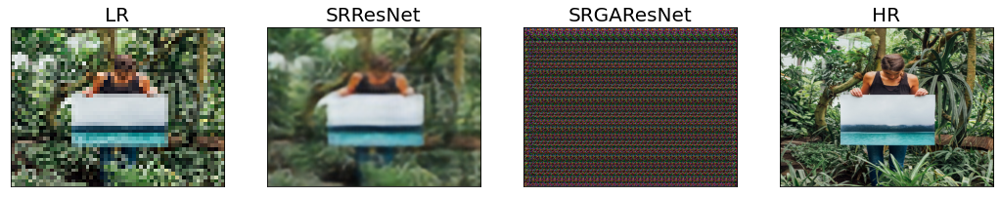

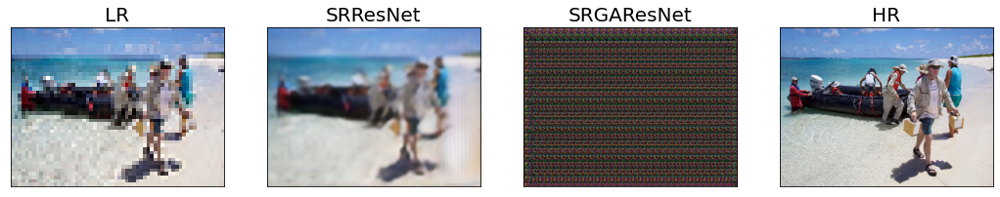

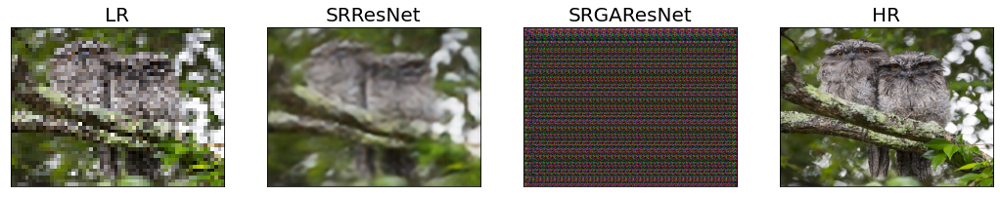

In [18]:
# Define paths towards low (input) and high (target) resolution images
lr_path = "data/train/LR/down_factor_x32"
hr_path = "data/train/LR/down_factor_x4"

# Define paths to models
srresnet_path = "models/SRResNet/SRResNet_500.pt"
srgaresnet_path = "models/SRGAResNet/Implementation 1/SRGAResNet_200.pt"

# Define number of images to test
test_size = 10

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True

# Generate lists of filenames for all images and labels contained within corresponding directories (with full path)
lr_files = list(map(lambda lr_file: os.path.join(lr_path, lr_file), sorted(os.listdir(lr_path))))
hr_files = list(map(lambda hr_file: os.path.join(hr_path, hr_file), sorted(os.listdir(hr_path))))

# Define indices of random samples based on number of testing images
idx_list = np.random.randint(0, len(lr_files), test_size)

# Load models
srresnet = torch.load(srresnet_path)['model'].to(device)
srgaresnet = torch.load(srgaresnet_path)['generator'].to(device)

# Set models to evaluation mode
srresnet.eval()
srgaresnet.eval()

# Loop through testing images
for lr_file, hr_file in np.transpose([lr_files, hr_files])[idx_list]:
    
    # Read low (input) and high (target) resolution images
    lr_img = io.imread(lr_file)/255.0
    hr_img = io.imread(hr_file)/255.0
    
    # Resize to defined fixed shapes
    lr_img = cv2.resize(lr_img,
                        dsize=(int(resize_height/downsampling_factor), int(resize_width/downsampling_factor)),
                        interpolation=cv2.INTER_CUBIC) 
    hr_img = cv2.resize(hr_img,
                        dsize=(resize_height, resize_width),
                        interpolation=cv2.INTER_CUBIC) 

    # Convert low (input) and high (target) resolution images from numpy.ndarray to torch.FloatTensor format
    lr_img_tensor = torch.FloatTensor(lr_img).permute(2,0,1)[:3,:,:].unsqueeze(0).to(device)
    hr_img_tensor = torch.FloatTensor(hr_img).permute(2,0,1)[:3,:,:].unsqueeze(0).to(device)
    
    # Apply models to low resolution image
    sr_srresnet = srresnet(lr_img_tensor)
    sr_srgaresnet = srgaresnet(lr_img_tensor)

    # Convert super resolution images to image format
    sr_srresnet = sr_srresnet.squeeze(0).cpu().detach().permute(1,2,0)
    sr_srgaresnet = sr_srgaresnet.squeeze(0).cpu().detach().permute(1,2,0)
    
    # Normalize pixel values between 0 and 1
    lr_img = np.clip(lr_img, 0, 1)
    hr_img = np.clip(hr_img, 0, 1)
    sr_srresnet = np.clip(sr_srresnet, 0, 1)
    sr_srgaresnet = np.clip(sr_srgaresnet, 0, 1)
    
    # Display low, super (SRResNet and SRGAResNet) and high resolution images
    plt.figure(figsize=(18,8))
    
    plt.subplot(141)
    plt.imshow(lr_img, cmap='gray')
    plt.title('LR', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(142)
    plt.imshow(sr_srresnet, cmap='gray')
    plt.title('SRResNet', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(143)
    plt.imshow(sr_srgaresnet, cmap='gray')
    plt.title('SRGAResNet', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(144)
    plt.imshow(hr_img, cmap='gray')
    plt.title('HR', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

## Implementation 1: Conclusions
### SRResNet

**Training**

The content loss progressively decreased during training, which shows that the model was able to learn how to generate super-resolution images that were getting more and more similar to the original high-resolution images on the pixel-wise level.

**Evaluation**

When tested on new images, the model showed promissing results. The resulting super-resolution images remain slightly blurry, and not all vascular features were retained, but it did a great job at reconstructing lung volume.

### SRGAResNet

**Training**

No clear learning was observed for the Generator. The Discriminator seemed to be learning at first, as the corresponding loss started to decrease, but the fact that the loss reached a perfect 0 after a certain number of epochs was surprising and probably the result of an implementation error.

**Evaluation**

Compared to the SRResNet, the testing of the SRGAResNet clearly showed that something went wrong during training. Knowing that the Generator of the SRGAResNet is basically a copy of the SRResNet, this indicates that the implementation of tha GAN architecture, or the definition of the Discriminator was not done properly.

___
# Model Implementation #2

Based on the results from the last implementation, we concluded that either the Discriminator or the GAN architecture (or both) was wrongly implemented. As a result, we will copy the implementation of every step from Implementation #1, beside for the implementation of the Discriminator and the training cell.

## Dataset parameters and definition

In [2]:
# Define data augmentation probability
#   e.g. if set to 0.5, each image has a 50% chance to be transformed
augmentation_probability = 0.5

# Define rotation angle range for data augmentation
#   e.g. if set to 5, each transformed image is randomly rotated by an angle comprised between -5 and +5 degrees
rotation_range = 5

# Define warping range for data augmentation
#   e.g. if set to 0.6, each transformed image is randomly resized along the x- and y-axes by a factor
#   comprised between 60% and 100% of the original image shape (with different factors for each direction).
#   The resize image is then re-resize to the original image shape by filling the cropped pixels with black pixels
#   (giving the impression of warping)
warping_range = 0.8

# Define cropping ratio range for data augmentation
#   e.g. if crop_lower_range = 0.5 and crop_upper_range = 0.8, each transformed image is randomly cropped
#   along the x- and y-axes by a factor comprised between 50% and 80% of the original image dimensions
crop_lower_range = 0.5
crop_upper_range = 0.8
cropping_ratio = np.random.uniform(crop_lower_range, crop_upper_range)

# Define resizing shapes
#   since not all images have the same shape, we need to define unique width and height that will be used
#   to reshape all images to the same unique size (necessary for the neural network)
#   these values were based on the mean width and height calculated over the entire dataset
resize_width = 360
resize_height = 480

# Define downsampling factor
downsampling_factor = 8

class ProcessedDataset(Dataset):
    
    def __init__(self, input_path, target_path, rotation=True, warping=True, cropping=True):
        '''
        ProcessedDataset(path, rotation=True, warping=True, cropping=True)
            Class enabling the definition of a dataset of 3D images with embedded augmentation strategies 
        Parameters:
            input_path: full path to input data (i.e. low resolution data)
                (type: string)
            target_path: full path to target data (i.e. high resolution data)
                (type: string)
            rotation: specifies whether rotation augmentation should be applied
                (type: boolean - True to apply rotation augmentation, False NOT to apply rotation augmentation)
                (default=True)
            warping: specifies whether warping augmentation should be applied
                (type: boolean - True to apply warping augmentation, False NOT to apply warping augmentation)
                (default=True)
            cropping: specifies whether cropping augmentation should be applied
                (type: boolean - True to apply cropping augmentation, False NOT to apply cropping augmentation)
                (default=True)
        '''
        
        # Generate paths towards low (input) and high (target) resolution images
        self.lr_path = input_path
        self.hr_path = target_path
        
        # Generate lists of filenames for all images and labels contained within corresponding directories (with full path)
        self.lr_files = list(map(lambda lr_file: os.path.join(self.lr_path, lr_file), sorted(os.listdir(self.lr_path))))
        self.hr_files = list(map(lambda hr_file: os.path.join(self.hr_path, hr_file), sorted(os.listdir(self.hr_path))))
        
        # Specify which augmentation strategies to apply
        self.rotation = rotation
        self.warping = warping
        self.cropping = cropping
        
    def __getitem__(self, index):
        
        # Get full paths to selected low (input) and high (target) resolution images
        lr_path = self.lr_files[index]
        hr_path = self.hr_files[index]

        # Read low (input) and high (target) resolution images
        lr_img = io.imread(lr_path)/255.0
        hr_img = io.imread(hr_path)/255.0
        
        # Data augmentation 1: apply random rotation to image (based on defined probability and range)
        if self.rotation:
            if np.random.uniform(0,1) >= augmentation_probability:
                angle = np.random.uniform(-rotation_range,rotation_range)
                lr_img = ndimage.rotate(lr_img, angle, axes=(0,1), reshape=False, order=1, cval=0)
                hr_img = ndimage.rotate(hr_img, angle, axes=(0,1), reshape=False, order=1, cval=0)
        
        # Data augmentation 2: apply random warping to image (based on defined probability and range)
        if self.warping:
            if np.random.uniform(0,1) >= augmentation_probability: 
                #   Generate random warping factors along x- and y-axes
                warping_x = np.random.uniform(warping_range,1)
                warping_y = np.random.uniform(warping_range,1)
                #   Save original shapes
                lr_x_shape, lr_y_shape = lr_img.shape[0], lr_img.shape[1]
                hr_x_shape, hr_y_shape = hr_img.shape[0], hr_img.shape[1]                
                #   Warp images and labels
                lr_img = ndimage.zoom(lr_img, (warping_x,warping_y,1), order=1, cval=0)
                hr_img = ndimage.zoom(hr_img, (warping_x,warping_y,1), order=1, cval=0)
                #   Calculate number of rows and columns to add shape
                lr_n_rows, lr_n_cols = lr_x_shape - lr_img.shape[0], lr_y_shape - lr_img.shape[1]
                hr_n_rows, hr_n_cols = hr_x_shape - hr_img.shape[0], hr_y_shape - hr_img.shape[1]
                #   Calculate padding shape
                #      LR
                if lr_n_rows%2 == 0 and lr_n_cols%2 == 0:
                    lr_pad_shape = ((int(lr_n_rows/2), int(lr_n_rows/2)),
                                    (int(lr_n_cols/2), int(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 != 0 and lr_n_cols%2 == 0:
                    lr_pad_shape = ((math.ceil(lr_n_rows/2), math.floor(lr_n_rows/2)),
                                    (int(lr_n_cols/2), int(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 == 0 and lr_n_cols%2 != 0:
                    lr_pad_shape = ((int(lr_n_rows/2), int(lr_n_rows/2)),
                                    (math.ceil(lr_n_cols/2), math.floor(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 != 0 and lr_n_cols%2 != 0:
                    lr_pad_shape = ((math.ceil(lr_n_rows/2), math.floor(lr_n_rows/2)),
                                    (math.ceil(lr_n_cols/2), math.floor(lr_n_cols/2)),
                                    (0,0))
                #      HR
                if hr_n_rows%2 == 0 and hr_n_cols%2 == 0:
                    hr_pad_shape = ((int(hr_n_rows/2), int(hr_n_rows/2)),
                                    (int(hr_n_cols/2), int(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 != 0 and hr_n_cols%2 == 0:
                    hr_pad_shape = ((math.ceil(hr_n_rows/2), math.floor(hr_n_rows/2)),
                                    (int(hr_n_cols/2), int(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 == 0 and hr_n_cols%2 != 0:
                    hr_pad_shape = ((int(hr_n_rows/2), int(hr_n_rows/2)),
                                    (math.ceil(hr_n_cols/2), math.floor(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 != 0 and hr_n_cols%2 != 0:
                    hr_pad_shape = ((math.ceil(hr_n_rows/2), math.floor(hr_n_rows/2)),
                                    (math.ceil(hr_n_cols/2), math.floor(hr_n_cols/2)),
                                    (0,0))
                #   Pad images and labels to match original shape
                lr_img = np.pad(lr_img, lr_pad_shape, 'constant', constant_values=0)
                hr_img = np.pad(hr_img, hr_pad_shape, 'constant', constant_values=0)
                
        # Data augmentation 3: apply random cropping to image (based on defined probability and range)
        if self.cropping:
            if np.random.uniform(0,1) >= augmentation_probability:
                #   Save original dimensions
                lr_dim = lr_img.shape
                hr_dim = hr_img.shape
                #   Define cropped images length
                cropped_length_lr = int(lr_dim[0] * cropping_ratio)
                cropped_length_hr = int(hr_dim[0] * cropping_ratio)
                #   Define random coordinates for bottom left corner of the cropping areas for high resolution images
                x1 = int(np.random.uniform(0, hr_dim[0]-1 - cropped_length_hr))
                y1 = int(np.random.uniform(0, hr_dim[1]-1 - cropped_length_hr))
                #   Define x1 and y1 ratios to high resolution images shape,
                #   so the equivalent x1 and y1 can be defined for the low resolution images
                x1_ratio = x1/hr_dim[0]
                y1_ratio = y1/hr_dim[1]
                #   Define random coordinates for bottom left corner of the cropping areas for
                #   low and high resolution images
                x1_lr = int(lr_dim[0]*x1_ratio)
                y1_lr = int(lr_dim[1]*y1_ratio)
                x1_hr = int(hr_dim[0]*x1_ratio)
                y1_hr = int(hr_dim[1]*y1_ratio)
                #   Define random coordinates for top right corner of the cropping area for low and high resolution images
                x2_lr = x1_lr + cropped_length_lr
                y2_lr = y1_lr + cropped_length_lr
                x2_hr = x1_hr + cropped_length_hr
                y2_hr = y1_hr + cropped_length_hr
                #   Crop images and labels
                lr_img = lr_img[x1_lr:x2_lr+1, y1_lr:y2_lr+1]
                hr_img = hr_img[x1_hr:x2_hr+1, y1_hr:y2_hr+1]
                #   Upsample cropped images and labels to match with original image size
                lr_img = cv2.resize(lr_img, dsize=(lr_dim[0], lr_dim[0]), interpolation=cv2.INTER_CUBIC) 
                hr_img = cv2.resize(hr_img, dsize=(hr_dim[0], hr_dim[0]), interpolation=cv2.INTER_CUBIC)   
        
        # Resize to defined fixed shapes
        lr_img = cv2.resize(lr_img,
                            dsize=(int(resize_height/downsampling_factor), int(resize_width/downsampling_factor)),
                            interpolation=cv2.INTER_CUBIC) 
        hr_img = cv2.resize(hr_img,
                            dsize=(resize_height, resize_width),
                            interpolation=cv2.INTER_CUBIC) 
        
        # Convert low (input) and high (target) resolution images from numpy.ndarray to torch.FloatTensor format
        lr_img_tensor = torch.FloatTensor(lr_img).permute(2,0,1)[:3,:,:]
        hr_img_tensor = torch.FloatTensor(hr_img).permute(2,0,1)[:3,:,:]
               
        return lr_img_tensor, hr_img_tensor
        
    def __len__(self):
        
        return len(self.lr_files)

## Model blocks and Generator definition

In [3]:
class ConvolutionalBlock(nn.Module):
    
    def __init__(self, input_channels, output_channels, kernel_size, stride=1, batch_norm=False, activation=None):
        '''
        ConvolutionalBlock(input_channels, output_channels, kernel_size, stride=1, batch_norm=False, activation=None)
            Convolutional block comprising a 2D Convolutional layer, as well as potential batch normalization (if True)
            and activation (if different from None) layers.
        Parameters:
            input_channels: specifies number of input channels
                (type: integer)
            output_channels: specifies number of output channels
                (type: integer)
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer)
            stride: specifies number of pixels by which the kernel moves during convolution
                (type: integer) (default=1)
            batch_norm: defines whether a Batch Normalization layer should be included
                (type: boolean - True for Yes, False for No)
            activation: define whether an Activation layer should be included, and if yes, what kind of activation
                (type: string - 'prelu' for PReLU, 'leakyrelu' for LeakyReLU, 'tanh' for 'Tanh')
        '''
        
        super(ConvolutionalBlock, self).__init__()
        
        # Initialize layers as a list (better for flexibility regarding the potential addition of BN or Activation layers)
        layers = []
        
        # Append 2D Convolutional layer to list of layers
        layers.append(nn.Conv2d(in_channels=input_channels, out_channels=output_channels,
                                     kernel_size=kernel_size, stride=stride, padding=kernel_size//2))
        
        # If set to True, append Batch Normalization layer to list of layers
        if batch_norm == True:
            layers.append(nn.BatchNorm2d(num_features=output_channels))
        
        # If different from None, append Activation layer to list of layers
        if activation == 'prelu':
            layers.append(nn.PReLU())
        elif activation == 'leakyrelu':
            layers.append(nn.LeakyReLU(0.2))
        elif activation == 'tanh':
            layers.append(nn.Tanh())
            
        # Combine layers into Sequential block
        self.conv_block = nn.Sequential(*layers)
    
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            output: ouput images (type: torch.FloatTensor
                                  shape: (number of samples, output_channels, width, height))
        '''
        
        output = self.conv_block(input)
        
        return output

class ResidualBlock(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64):
        '''
        ResidualBlock(kernel_size=3, num_channels=64)
            Residual block comprising two Convolutional blocks and a residual connection (skip connection)
            that goes across them.
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer) (default=3)
            num_channels: specifies number of channels
                (type: integer) (default=64)
        '''
        
        super(ResidualBlock, self).__init__()
        
        # Define first Convolutional block
        self.conv1 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=kernel_size, stride=1, batch_norm=True, activation='prelu')
        
        # Define second Convolutional block
        self.conv2 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=kernel_size, stride=1, batch_norm=True, activation=None)
        
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            ouput: output images (type: torch.FloatTensor,
                                  shape: (number of samples, input_channels, width, height))
        '''
        
        # Define residual (i.e. input images)
        residual = input
        
        # Pass input images through the two Convolutional blocks
        output = self.conv1(input)
        output = self.conv2(output)
        
        # Combine Convolutional output with residual
        output = output + residual
        
        return output
    
class SubPixelConvolutionalBlock(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64, scaling_factor=2):
        '''
        SubPixelConvolutionalBlock(kernel_size=3, num_channels=64, scaling_factor=2)
            Sub-Pixel Convolutional block comprising a 2D Convolutional layer, as well as a Pixel Shuffle layer
            and a PReLU activation layer.
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer) (default=3)
            num_channels: specifies number of channels 
                (type: integer) (default=64)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=2) (range: can only be 2, 4 or 8)
        '''
        
        super(SubPixelConvolutionalBlock, self).__init__()
        
        # Define block within Sequential layer
        self.sub_pix_conv = nn.Sequential(nn.Conv2d(in_channels=num_channels, out_channels=num_channels*(scaling_factor**2),
                                                    kernel_size=kernel_size, padding=kernel_size//2),
                                          nn.PixelShuffle(upscale_factor=scaling_factor),
                                          nn.PReLU())
    
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            upscaled: upscaled images (type: torch.FloatTensor,
                                       shape: (number of samples, input_channels, width*scaling_factor, height*scaling_factor))
        '''
        
        upscaled = self.sub_pix_conv(input)
        
        return upscaled

class SRResNet(nn.Module):
    
    def __init__(self, in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4):
        '''
        SRResNet(in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4)
            Super-Resolution Residual Neural Network (SRResNet) as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            in_out_kernel_size: specifies dimensions of convolutional kernels for first and last convolutions
                (i.e. input and output)
                (type: integer) (default=9)
            mid_kernel_size: specifies dimensions of convolutional kernels for all remaining convolutions
                (i.e. between input and output)
                (type: integer) (default=3)
            num_channels: specifies number of channels for the different blocks
                (type: integer) (default=64)
            num_blocks: specifies number of residual blocks
                (type: integer) (default=16)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=4) (range: can only be 2, 4 or 8)
        '''
        
        super(SRResNet, self).__init__()
        
        # Verify that scaling factor is either 2, 4 or 8, otherwise returns error
        assert scaling_factor in [2, 4, 8], 'Error: The scaling factor should be set to either 2, 4 or 8'
        
        # Define first Convolutional block
        self.conv1 = ConvolutionalBlock(input_channels=3, output_channels=num_channels,
                                       kernel_size=in_out_kernel_size, batch_norm=False, activation='prelu')
        
        # Define intermediate Residual blocks based on defined number of blocks
        self.residual = nn.Sequential(*[ResidualBlock(kernel_size=mid_kernel_size,
                                                      num_channels=num_channels) for i in range(num_blocks)])
        
        # Define intermediate Convolutional block
        self.conv2 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=in_out_kernel_size, batch_norm=True, activation=None)
        
        # Define Sub-Pixel Convolutional blocks, which enable the progressive increase in image resolution
        # (i.e. each Sub-Pixel Convolutional block is upscaling the image by a factor of two)
        #   Calculate number of Sub-Pixel Convolutional blocks based on SRRestNet scaling factor
        num_subpix_blocks = int(math.log2(scaling_factor))
        #   Define blocks
        self.subpix_conv = nn.Sequential(*[SubPixelConvolutionalBlock(kernel_size=mid_kernel_size,
                                                                      num_channels=num_channels,
                                                                      scaling_factor=2) for i in range(num_subpix_blocks)])
        
        # Define last Convolutional block
        self.conv3 = ConvolutionalBlock(input_channels=num_channels, output_channels=3,
                                        kernel_size=in_out_kernel_size, batch_norm=False, activation='tanh')
        
    def forward(self, lr_imgs):
        '''
        Enables forward propagation.
        Parameters:
            lr_imgs: low resolution images (type: torch.FloatTensor,
                                            shape: (number of samples, 3, width, height))
        Return:
            sr_imgs: super-resolution images (type: torch.FloatTensor,
                                              shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        '''
        
        # Pass low resolution images through first Convolutional block
        output = self.conv1(lr_imgs)
        
        # Define residual
        res = output
        
        # Pass output of first Convolutional block through Residual blocks
        output = self.residual(output)
        
        # Pass output of Residual blocks through intermediate Convolutional block
        output = self.conv2(output)
        
        # Combine output of intermediate Convolutional block with residual
        output = output + res
        
        # Pass combined output of intermediate Convolutional block and redisual through Sub-Pixel Convolutional blocks
        output = self.subpix_conv(output)
        
        # Pass output of Sub-Pixel Convolutional blocks through last Convolutional block
        sr_imgs = self.conv3(output)
        
        return sr_imgs
    
class Generator(nn.Module):
    
    def __init__(self, in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4):
        '''
        Generator(in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4)
            Generator of the Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet)
            as defined by Ledig et al. (2017) (same architecture as SRRestNet).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            in_out_kernel_size: specifies dimensions of convolutional kernels for first and last convolutions
                (i.e. input and output)
                (type: integer) (default=9)
            mid_kernel_size: specifies dimensions of convolutional kernels for all remaining convolutions
                (i.e. between input and output)
                (type: integer) (default=3)
            num_channels: specifies number of channels for the different blocks
                (type: integer) (default=64)
            num_blocks: specifies number of residual blocks
                (type: integer) (default=16)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=4) (range: can only be 2, 4 or 8)
        '''
        
        super(Generator, self).__init__()
        
        # Generate Network by creating an instance of the SRResNet
        self.generator = SRResNet(in_out_kernel_size=in_out_kernel_size, mid_kernel_size=mid_kernel_size,
                                  num_channels=num_channels, num_blocks=num_blocks, scaling_factor=scaling_factor)
        
    def srresnet_init(self, srresnet_checkpoint_path):
        '''
        Initialize Generator's weights using the  pre-trained weights of the SRResNet.
        Parameters:
            srresnet_checkpoint_path: filepath to pre-trained srresnet checkpoint
        '''
        
        # Load pre-trained SRResNet weights
        srresnet = torch.load(srresnet_checkpoint_path)['model']
        
        # Initialize Generator's weights using pre-trained SRResNet weights
        self.generator.load_state_dict(srresnet.state_dict())
        
        # Display initialization statement
        print("\nGenerator's weights initialized using pre-trained SRResNet\n")
        
    def forward(self, lr_imgs):
        '''
        Enables forward propagation.
        Parameters:
            lr_imgs: low resolution images (type: torch.FloatTensor,
                                            shape: (number of samples, 3, width, height))
        Return:
            sr_imgs: super-resolution images (type: torch.FloatTensor,
                                              shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        '''
        
        # Pass low resolution images through Generator
        sr_imgs = self.generator(lr_imgs)
        
        return sr_imgs

## Discriminator definition (#2)

In [4]:
class Discriminator(nn.Module):
    
    def __init__(self):
        
        '''
        Discriminator()
            Discriminator of the Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet)
            as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            None
        '''
        
        super(Discriminator, self).__init__()
        
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        
        self.conv4 = nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1)
        self.batch_norm4 = nn.BatchNorm2d(128)
        
        self.conv5 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.batch_norm5 = nn.BatchNorm2d(256)
        
        self.conv6 = nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1)
        self.batch_norm6 = nn.BatchNorm2d(256)
        
        self.conv7 = nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1)
        self.batch_norm7 = nn.BatchNorm2d(512)
        
        self.conv8 = nn.Conv2d(512, 512, kernel_size=3, stride=2, padding=1)
        self.batch_norm8 = nn.BatchNorm2d(512)
        
        self.conv9 = nn.Conv2d(512, 1, kernel_size=1, stride=1, padding=1)
        
        
    def forward(self, x):
        '''
        Enables forward propagation.
        Parameters:
            x: images to classify as either Super (model output) or High (target) Resolution  
                (type: torch.FloatTensor, shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        Return:
            score: classification score (type: float)
        '''
        
        x = self.conv1(x)
        x = x * F.sigmoid(x)
        
        x = self.conv2(x)
        x = self.batch_norm2(x)
        x = x * F.sigmoid(x)
        
        x = self.conv3(x)
        x = self.batch_norm3(x)
        x = x * F.sigmoid(x)
        
        x = self.conv4(x)
        x = self.batch_norm4(x)
        x = x * F.sigmoid(x)
        
        x = self.conv5(x)
        x = self.batch_norm5(x)
        x = x * F.sigmoid(x)
        
        x = self.conv6(x)
        x = self.batch_norm6(x)
        x = x * F.sigmoid(x)
        
        x = self.conv7(x)
        x = self.batch_norm7(x)
        x = x * F.sigmoid(x)
        
        x = self.conv8(x)
        x = self.batch_norm8(x)
        x = x * F.sigmoid(x)
        
        x = self.conv9(x)
        
        return F.sigmoid(F.avg_pool2d(x, x.size()[2:])).view(x.size()[0], -1)

## Feature extractor definition
To enable the extraction of features (as mentioned under the definition of the Content loss), we will define a new class that will allow a different implementation of a truncated version of the VGG19 network, from which we will be able to extract features maps from selected batches of images.

In [5]:
class FeatureExtractor(nn.Module):
    
    def __init__(self, network, feature_layer=11):
        '''
        FeatureExtractor(network, feature_layer=11)
            Implementation of a truncated network architecture (to be defined) for the extraction of feature maps.
        Parameters:
            network: neural network architecture to import
                (type: torchvision.models, e.g. torchvision.models.vgg19(pretrained=True))
            feature_layer: index of the layer where truncation will occur
                (type: integer) (default=11)
        '''
        
        super(FeatureExtractor, self).__init__()
        self.features = nn.Sequential(*list(network.features.children())[:(feature_layer+1)])
        
    def forward(self, x):
        '''
        Enables forward propagation.
        Parameters:
            x: images to extract feature maps from  
                (type: torch.FloatTensor, shape: (number of samples, 3, width, height))
        Return:
            feature maps: feature maps in selected network space
        '''
        
        return self.features(x)

## Implementation #2: Training


Generator's weights initialized using pre-trained SRResNet

Generator pre-training in progress
Pre-training epochs:    1/10 | Pre-training content loss: 2.22e-02 | Time elapsed:  0 hrs  1 mins  2 secs
Pre-training epochs:    2/10 | Pre-training content loss: 1.78e-02 | Time elapsed:  0 hrs  2 mins  4 secs
Pre-training epochs:    3/10 | Pre-training content loss: 1.50e-02 | Time elapsed:  0 hrs  3 mins  6 secs
Pre-training epochs:    4/10 | Pre-training content loss: 1.63e-02 | Time elapsed:  0 hrs  4 mins  9 secs
Pre-training epochs:    5/10 | Pre-training content loss: 2.10e-02 | Time elapsed:  0 hrs  5 mins 14 secs
Pre-training epochs:    6/10 | Pre-training content loss: 2.24e-02 | Time elapsed:  0 hrs  6 mins 26 secs
Pre-training epochs:    7/10 | Pre-training content loss: 1.26e-02 | Time elapsed:  0 hrs  7 mins 36 secs
Pre-training epochs:    8/10 | Pre-training content loss: 2.27e-02 | Time elapsed:  0 hrs  8 mins 47 secs
Pre-training epochs:    9/10 | Pre-training content loss

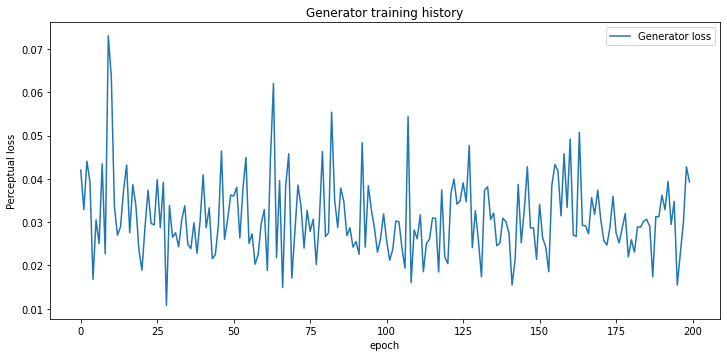

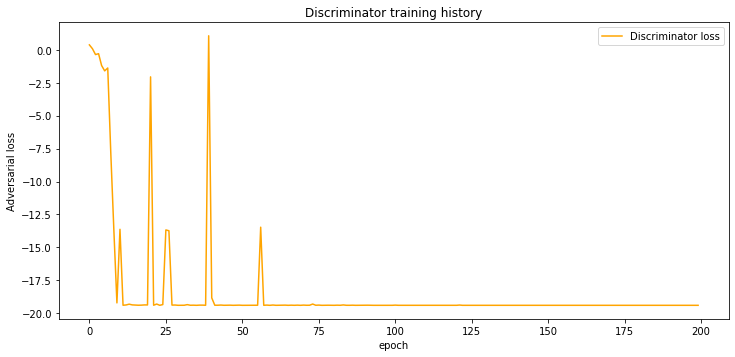


Total computing time:  8 hrs 48 mins  2 secs


In [6]:
# Define path towards directory containing the processed images
input_path = "data/train/LR/down_factor_x32"
target_path = "data/train/LR/down_factor_x4"

# Define number of epochs
pretrain_epochs = 10
epochs = 200

# Define starting epoch number
start_epoch = 1

# Define DataLoader parameters
batch_size = 3
num_workers = 0
pin_memory = False

# Define frequency of print statements (i.e. every how many epochs to print training progress)
print_checkpoint = 10

# Define checkpoint (i.e. number of epochs after which the model will be saved)
checkpoint = 50

# Define Generator parameters
in_out_kernel_size = 9
mid_kernel_size = 3
num_channels_g = 64
num_blocks_g = 16

# Use pre-trained Generator? (using the trained SRResNet)
pretrained_generator = True
srresnet_checkpoint_path = 'models/SRResNet/SRResNet_500.pt'

# Define learning rate
lr = 0.0001

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True
    
# Generate dataset
train = ProcessedDataset(input_path, target_path, rotation=True, warping=True)

# Load dataset
train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

# Calculate scaling factor based on input and target images shapes
#   Grab the first sample to extract LR and HR images dimensions 
for lr_imgs, hr_imgs in train_loader:
    break
#   Calculate corresponding scaling factor
scaling_factor = int(hr_imgs.shape[2]/lr_imgs.shape[2])
  
# Initialize Generator
#   Create instance of Generator
generator = Generator(in_out_kernel_size=in_out_kernel_size,
                      mid_kernel_size=mid_kernel_size,
                      num_channels=num_channels_g,
                      num_blocks=num_blocks_g,
                      scaling_factor=scaling_factor).to(device)
#   Initialize Generator using weights from pre-trained SRResNet
if pretrained_generator:    
    generator.srresnet_init(srresnet_checkpoint_path=srresnet_checkpoint_path)

# Initialize Discriminator
discriminator = Discriminator().to(device)

# Loss functions
feature_extractor = FeatureExtractor(torchvision.models.vgg19(pretrained=True)).to(device)
#   Define Content loss
content_criterion = nn.MSELoss().to(device)
#   Define Adversarial loss
adversarial_criterion = nn.BCELoss().to(device)
#   Initialize mean epoch losses tracker
mean_epoch_generator_loss = []
mean_epoch_discriminator_loss = []

# Iniatialize optimizers
optimizer_g = torch.optim.Adam(generator.parameters(), lr=lr)
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=lr)

# Initialize time tracker
start_time = time()

# Pre-train Generator using pixel-wise MSE loss
print('Generator pre-training in progress')
for epoch in range(start_epoch, pretrain_epochs+1):
    
    # Loop through training samples
    for lr_imgs, hr_imgs in train_loader:
                
        # Assign images to available device ('cuda' or 'cpu')
        hr_imgs = Variable(hr_imgs).to(device)
        lr_imgs = Variable(lr_imgs).to(device)        
        
        # Pass low resolution images through Generator
        sr_imgs = generator(lr_imgs)
        
        # GENERATOR UPDATE
        generator.zero_grad()
        #   Calculate Content loss
        content_loss = content_criterion(sr_imgs, hr_imgs)        
        #   Update parameters
        content_loss.backward()
        optimizer_g.step()
        
        # Delete current samples to save memory
        del lr_imgs, hr_imgs, sr_imgs
    
    # Print pre-training completion status
    current_time = time() - start_time
    print(f'\033[1mPre-training epochs:\033[0m {epoch:4.0f}/{pretrain_epochs} | '
          f'\033[1mPre-training content loss:\033[0m {content_loss.item():.2e} | '
          f'\033[1mTime elapsed:\033[0m {current_time//3600:2.0f} hrs '
          f'{(current_time - current_time//3600*3600)//60:2.0f} mins '
          f'{current_time%60:2.0f} secs')

    # Save pre-trained generator every checkpoint
    if epoch == pretrain_epochs:
        #   Define current model state using dictionary
        model_state = {'epoch': epoch,
                       'generator': generator,
                       'optimizer_g': optimizer_g}
        #   Save current model
        torch.save(model_state, 'models/SRGAResNet/Implementation 2/pretrained_generator_' + str(epoch) + '.pt')
print('Generator pre-training completed')

# Train SRGAResNet model
print('\nSRGAResNet training in progress')
for epoch in range(start_epoch, epochs+1):
    
    # Initialize mean sample losses tracker
    mean_sample_generator_loss = []
    mean_sample_discriminator_loss = []
    
    # Loop through training samples
    for lr_imgs, hr_imgs in train_loader:
                
        # Assign images to available device ('cuda' or 'cpu')
        hr_imgs = Variable(hr_imgs).to(device)
        lr_imgs = Variable(lr_imgs).to(device)        
        
        # Pass low resolution images through Generator
        sr_imgs = generator(lr_imgs)
        
        # Pass images through discriminator
        hr_labels = discriminator(hr_imgs)
        sr_labels = discriminator(Variable(sr_imgs.data))
        
        # Generate targets
        hr_target = Variable(torch.ones_like(hr_labels)*0.5+0.7).to(device)
        sr_target = Variable(torch.ones_like(sr_labels)*0.3).to(device)
        
        # DISCRIMINATOR UPDATE
        discriminator.zero_grad()
        #   Calculate adversarial loss
        hr_discriminator_loss = adversarial_criterion(hr_labels, hr_target)
        sr_discriminator_loss = adversarial_criterion(sr_labels, sr_target)
        discriminator_loss = hr_discriminator_loss + sr_discriminator_loss
        #   Append loss to mean sample loss tracker
        mean_sample_discriminator_loss.append(discriminator_loss.item())
        #   Update parameters
        discriminator_loss.backward()
        optimizer_d.step()
        
        # GENERATOR UPDATE
        generator.zero_grad()
        #   Define feature maps
        hr_features = Variable(feature_extractor(hr_imgs).data)
        sr_features = feature_extractor(sr_imgs)
        #   Calculate content loss
        generator_content_loss = content_criterion(sr_imgs, hr_imgs) + 0.006*content_criterion(sr_features, hr_features)
        #   Calculate generator adversarial loss
        generator_adversarial_loss = adversarial_criterion(discriminator(sr_imgs),
                                                           Variable(torch.ones_like(discriminator(sr_imgs))).to(device))
        #   Calculate perceptual loss
        generator_loss = generator_content_loss + 1e-3*generator_adversarial_loss
        #   Append loss to mean sample loss tracker
        mean_sample_generator_loss.append(generator_loss.item())
        #   Update parameters
        generator_loss.backward()
        optimizer_g.step()
        
        # Delete current samples to save memory
        del lr_imgs, hr_imgs, sr_imgs, hr_labels, sr_labels, hr_target, sr_target
        
    # Append losses to mean epoch losses tracker
    mean_epoch_generator_loss.append(generator_loss.item())
    mean_epoch_discriminator_loss.append(discriminator_loss.item())   
    
    # Print update statement for tracking
    if epoch == 1 or epoch%print_checkpoint == 0:
        current_time = time() - start_time
        print(f'\033[1mCompleted epochs:\033[0m {epoch:4.0f}/{epochs} | '
              f'\033[1mGenerator loss:\033[0m {generator_loss.item():.2e} | '
              f'\033[1mDiscriminator loss:\033[0m {discriminator_loss.item():.2e} | '
              f'\033[1mTime elapsed:\033[0m {current_time//3600:2.0f} hrs '
              f'{(current_time - current_time//3600*3600)//60:2.0f} mins '
              f'{current_time%60:2.0f} secs')

    # Save model every checkpoint
    if  epoch%checkpoint == 0:
        #   Define current model state using dictionary
        model_state = {'epoch': epoch,
                       'generator': generator,
                       'discriminator': discriminator,
                       'optimizer_g': optimizer_g,
                       'optimizer_d': optimizer_d}
        #   Save current model
        torch.save(model_state, 'models/SRGAResNet/Implementation 2/SRGAResNet_' + str(epoch) + '.pt')
        # Generate losses history DataFrame
        losses_history = pd.DataFrame(np.transpose([mean_epoch_generator_loss,
                                      mean_epoch_discriminator_loss]),
                                      columns=['Generator loss', 'Discriminator loss'])
        # Save loss history
        losses_history.to_csv('history/SRGAResNet/Implementation 2/SRGAResNet_' + str(epoch) + '.csv')
        #   Print save statement
        print(f'\n\tCheckpoint -> Model saved at {epoch:4.0f}/{epochs} epochs\n')

# Save final model
#   Define current model state using dictionary
model_state = {'epoch': epoch,
               'generator': generator,
               'discriminator': discriminator,
               'optimizer_g': optimizer_g,
               'optimizer_d': optimizer_d}
#   Save current model
torch.save(model_state, 'models/SRGAResNet/Implementation 2/SRGAResNet_' + str(epoch) + '.pt')

# Generate losses history DataFrame
losses_history = pd.DataFrame(np.transpose([mean_epoch_generator_loss,
                              mean_epoch_discriminator_loss]),
                              columns=['Generator loss', 'Discriminator loss'])

# Save loss history
losses_history.to_csv('history/SRGAResNet/Implementation 2/SRGAResNet_' + str(epoch) + '.csv')

# Plot training history
#   Generator
plt.subplot(211)
losses_history['Generator loss'].plot(figsize=(12,12))
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Perceptual loss')
plt.legend()
plt.title('Generator training history')
plt.show()
#   Discriminator
plt.subplot(212)
losses_history['Discriminator loss'].plot(figsize=(12,12), c='orange')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Adversarial loss')
plt.legend()
plt.title('Discriminator training history')
plt.show()

# Print total computing time
total_time = time() - start_time
print(f'\033[1m\nTotal computing time:\033[0m {total_time//3600:2.0f} hrs '
      f'{(total_time - total_time//3600*3600)//60:2.0f} mins '
      f'{total_time%60:2.0f} secs')

## Implementation #2: Evaluation

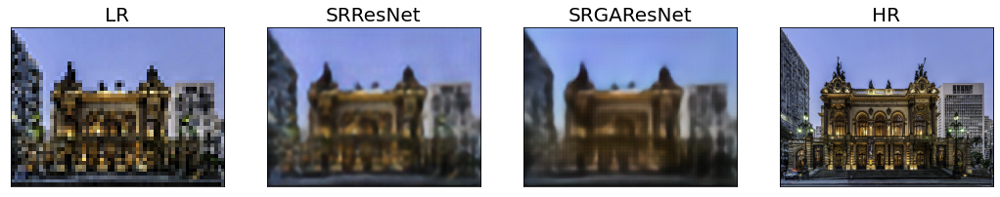

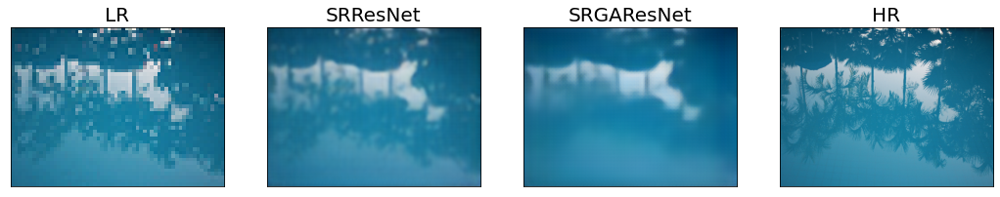

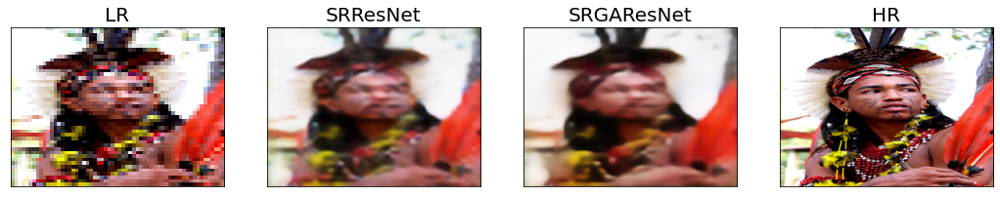

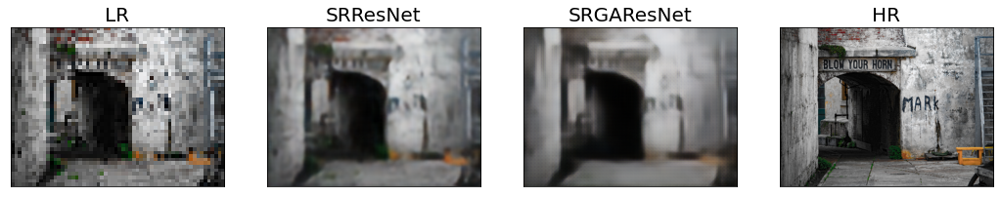

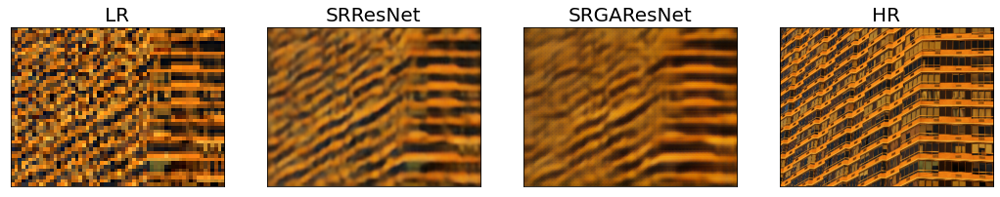

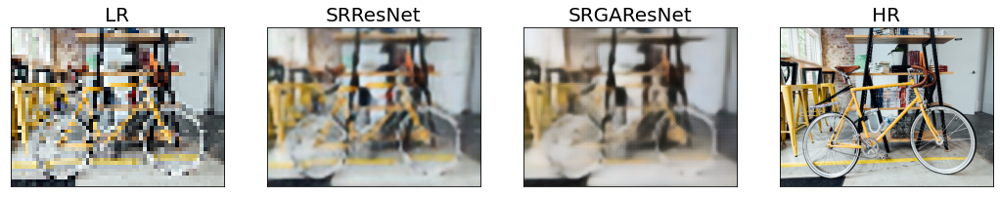

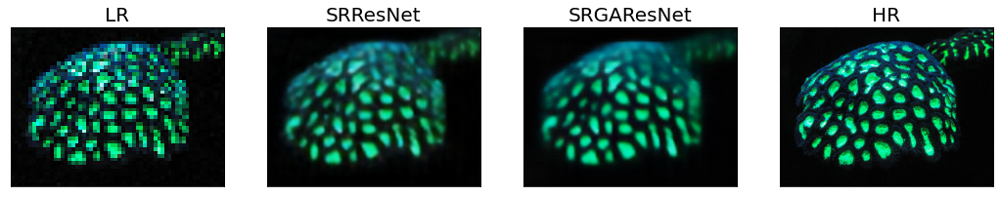

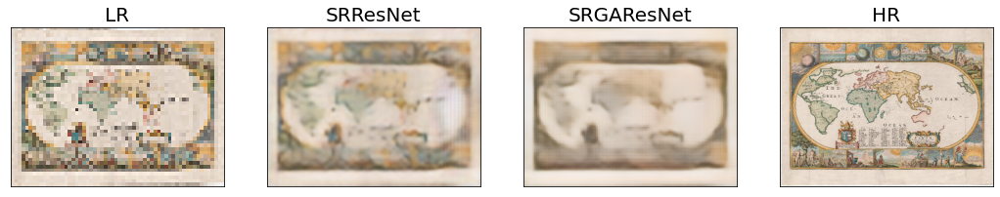

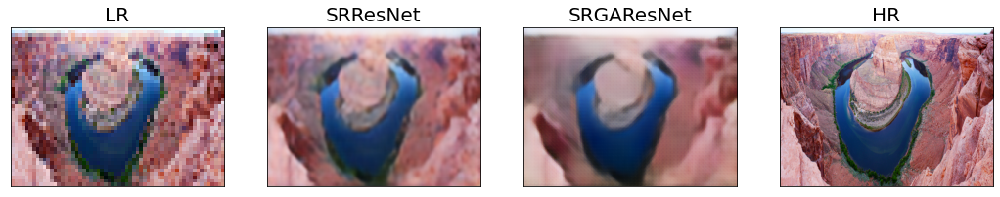

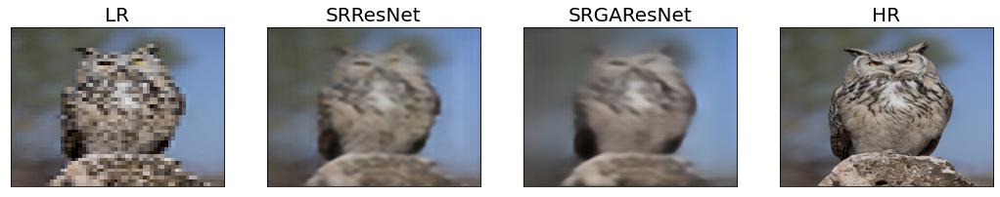

In [19]:
# Define paths towards low (input) and high (target) resolution images
lr_path = "data/train/LR/down_factor_x32"
hr_path = "data/train/LR/down_factor_x4"

# Define paths to models
srresnet_path = "models/SRResNet/SRResNet_500.pt"
srgaresnet_path = "models/SRGAResNet/Implementation 2/SRGAResNet_200.pt"

# Define number of images to test
test_size = 10

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True

# Generate lists of filenames for all images and labels contained within corresponding directories (with full path)
lr_files = list(map(lambda lr_file: os.path.join(lr_path, lr_file), sorted(os.listdir(lr_path))))
hr_files = list(map(lambda hr_file: os.path.join(hr_path, hr_file), sorted(os.listdir(hr_path))))

# Define indices of random samples based on number of testing images
idx_list = np.random.randint(0, len(lr_files), test_size)

# Load models
srresnet = torch.load(srresnet_path)['model'].to(device)
srgaresnet = torch.load(srgaresnet_path)['generator'].to(device)

# Set models to evaluation mode
srresnet.eval()
srgaresnet.eval()

# Loop through testing images
for lr_file, hr_file in np.transpose([lr_files, hr_files])[idx_list]:
    
    # Read low (input) and high (target) resolution images
    lr_img = io.imread(lr_file)/255.0
    hr_img = io.imread(hr_file)/255.0
    
    # Resize to defined fixed shapes
    lr_img = cv2.resize(lr_img,
                        dsize=(int(resize_height/downsampling_factor), int(resize_width/downsampling_factor)),
                        interpolation=cv2.INTER_CUBIC) 
    hr_img = cv2.resize(hr_img,
                        dsize=(resize_height, resize_width),
                        interpolation=cv2.INTER_CUBIC) 

    # Convert low (input) and high (target) resolution images from numpy.ndarray to torch.FloatTensor format
    lr_img_tensor = torch.FloatTensor(lr_img).permute(2,0,1)[:3,:,:].unsqueeze(0).to(device)
    hr_img_tensor = torch.FloatTensor(hr_img).permute(2,0,1)[:3,:,:].unsqueeze(0).to(device)
    
    # Apply models to low resolution image
    sr_srresnet = srresnet(lr_img_tensor)
    sr_srgaresnet = srgaresnet(lr_img_tensor)

    # Convert super resolution images to image format
    sr_srresnet = sr_srresnet.squeeze(0).cpu().detach().permute(1,2,0)
    sr_srgaresnet = sr_srgaresnet.squeeze(0).cpu().detach().permute(1,2,0)
    
    # Normalize pixel values between 0 and 1
    lr_img = np.clip(lr_img, 0, 1)
    hr_img = np.clip(hr_img, 0, 1)
    sr_srresnet = np.clip(sr_srresnet, 0, 1)
    sr_srgaresnet = np.clip(sr_srgaresnet, 0, 1)
    
    # Display low, super (SRResNet and SRGAResNet) and high resolution images
    plt.figure(figsize=(18,8))
    
    plt.subplot(141)
    plt.imshow(lr_img, cmap='gray')
    plt.title('LR', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(142)
    plt.imshow(sr_srresnet, cmap='gray')
    plt.title('SRResNet', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(143)
    plt.imshow(sr_srgaresnet, cmap='gray')
    plt.title('SRGAResNet', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(144)
    plt.imshow(hr_img, cmap='gray')
    plt.title('HR', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

## Implementation 2: Conclusions

### SRGAResNet

**Training**

The Generator of the SRGAResNet was loaded with the pre-trained weights of the SRResNet. No clear additional learning was observed as the resulting loss did not show any sign of progressive decrease. Similarly, the Discriminator did not seem to learn over time.

**Evaluation**

Compared to the previous implementation, the super-resolution images generated by this new SRGAResNet were closer to the expected outcome. However, no clear improvements were observed when compared to the single SRResNet.

___
# Model Implementation #3

Compared to implementation #1, implementation #2 was able to generate super-resolution images that were comparable to the SRResNet. However, the fact that the Discriminator was not able to learn nor improve the performance of the model means either that the definition/implementation of the Discriminator is wrong, or that we have reached the optimal performance of this architecture for this dataset.

To verify this, we will try one more and last method where the Discriminator is coded and implementated differently in the model training.

## Dataset parameters and definition

In [3]:
# Define data augmentation probability
#   e.g. if set to 0.5, each image has a 50% chance to be transformed
augmentation_probability = 0.5

# Define rotation angle range for data augmentation
#   e.g. if set to 5, each transformed image is randomly rotated by an angle comprised between -5 and +5 degrees
rotation_range = 5

# Define warping range for data augmentation
#   e.g. if set to 0.6, each transformed image is randomly resized along the x- and y-axes by a factor
#   comprised between 60% and 100% of the original image shape (with different factors for each direction).
#   The resize image is then re-resize to the original image shape by filling the cropped pixels with black pixels
#   (giving the impression of warping)
warping_range = 0.8

# Define cropping ratio range for data augmentation
#   e.g. if crop_lower_range = 0.5 and crop_upper_range = 0.8, each transformed image is randomly cropped
#   along the x- and y-axes by a factor comprised between 50% and 80% of the original image dimensions
crop_lower_range = 0.5
crop_upper_range = 0.8
cropping_ratio = np.random.uniform(crop_lower_range, crop_upper_range)

# Define resizing shapes
#   since not all images have the same shape, we need to define unique width and height that will be used
#   to reshape all images to the same unique size (necessary for the neural network)
#   these values were based on the mean width and height calculated over the entire dataset
resize_width = 360
resize_height = 480

# Define downsampling factor
downsampling_factor = 8

class ProcessedDataset(Dataset):
    
    def __init__(self, input_path, target_path, rotation=True, warping=True, cropping=True):
        '''
        ProcessedDataset(path, rotation=True, warping=True, cropping=True)
            Class enabling the definition of a dataset of 3D images with embedded augmentation strategies 
        Parameters:
            input_path: full path to input data (i.e. low resolution data)
                (type: string)
            target_path: full path to target data (i.e. high resolution data)
                (type: string)
            rotation: specifies whether rotation augmentation should be applied
                (type: boolean - True to apply rotation augmentation, False NOT to apply rotation augmentation)
                (default=True)
            warping: specifies whether warping augmentation should be applied
                (type: boolean - True to apply warping augmentation, False NOT to apply warping augmentation)
                (default=True)
            cropping: specifies whether cropping augmentation should be applied
                (type: boolean - True to apply cropping augmentation, False NOT to apply cropping augmentation)
                (default=True)
        '''
        
        # Generate paths towards low (input) and high (target) resolution images
        self.lr_path = input_path
        self.hr_path = target_path
        
        # Generate lists of filenames for all images and labels contained within corresponding directories (with full path)
        self.lr_files = list(map(lambda lr_file: os.path.join(self.lr_path, lr_file), sorted(os.listdir(self.lr_path))))
        self.hr_files = list(map(lambda hr_file: os.path.join(self.hr_path, hr_file), sorted(os.listdir(self.hr_path))))
        
        # Specify which augmentation strategies to apply
        self.rotation = rotation
        self.warping = warping
        self.cropping = cropping
        
    def __getitem__(self, index):
        
        # Get full paths to selected low (input) and high (target) resolution images
        lr_path = self.lr_files[index]
        hr_path = self.hr_files[index]

        # Read low (input) and high (target) resolution images
        lr_img = io.imread(lr_path)/255.0
        hr_img = io.imread(hr_path)/255.0
        
        # Data augmentation 1: apply random rotation to image (based on defined probability and range)
        if self.rotation:
            if np.random.uniform(0,1) >= augmentation_probability:
                angle = np.random.uniform(-rotation_range,rotation_range)
                lr_img = ndimage.rotate(lr_img, angle, axes=(0,1), reshape=False, order=1, cval=0)
                hr_img = ndimage.rotate(hr_img, angle, axes=(0,1), reshape=False, order=1, cval=0)
        
        # Data augmentation 2: apply random warping to image (based on defined probability and range)
        if self.warping:
            if np.random.uniform(0,1) >= augmentation_probability: 
                #   Generate random warping factors along x- and y-axes
                warping_x = np.random.uniform(warping_range,1)
                warping_y = np.random.uniform(warping_range,1)
                #   Save original shapes
                lr_x_shape, lr_y_shape = lr_img.shape[0], lr_img.shape[1]
                hr_x_shape, hr_y_shape = hr_img.shape[0], hr_img.shape[1]                
                #   Warp images and labels
                lr_img = ndimage.zoom(lr_img, (warping_x,warping_y,1), order=1, cval=0)
                hr_img = ndimage.zoom(hr_img, (warping_x,warping_y,1), order=1, cval=0)
                #   Calculate number of rows and columns to add shape
                lr_n_rows, lr_n_cols = lr_x_shape - lr_img.shape[0], lr_y_shape - lr_img.shape[1]
                hr_n_rows, hr_n_cols = hr_x_shape - hr_img.shape[0], hr_y_shape - hr_img.shape[1]
                #   Calculate padding shape
                #      LR
                if lr_n_rows%2 == 0 and lr_n_cols%2 == 0:
                    lr_pad_shape = ((int(lr_n_rows/2), int(lr_n_rows/2)),
                                    (int(lr_n_cols/2), int(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 != 0 and lr_n_cols%2 == 0:
                    lr_pad_shape = ((math.ceil(lr_n_rows/2), math.floor(lr_n_rows/2)),
                                    (int(lr_n_cols/2), int(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 == 0 and lr_n_cols%2 != 0:
                    lr_pad_shape = ((int(lr_n_rows/2), int(lr_n_rows/2)),
                                    (math.ceil(lr_n_cols/2), math.floor(lr_n_cols/2)),
                                    (0,0))
                elif lr_n_rows%2 != 0 and lr_n_cols%2 != 0:
                    lr_pad_shape = ((math.ceil(lr_n_rows/2), math.floor(lr_n_rows/2)),
                                    (math.ceil(lr_n_cols/2), math.floor(lr_n_cols/2)),
                                    (0,0))
                #      HR
                if hr_n_rows%2 == 0 and hr_n_cols%2 == 0:
                    hr_pad_shape = ((int(hr_n_rows/2), int(hr_n_rows/2)),
                                    (int(hr_n_cols/2), int(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 != 0 and hr_n_cols%2 == 0:
                    hr_pad_shape = ((math.ceil(hr_n_rows/2), math.floor(hr_n_rows/2)),
                                    (int(hr_n_cols/2), int(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 == 0 and hr_n_cols%2 != 0:
                    hr_pad_shape = ((int(hr_n_rows/2), int(hr_n_rows/2)),
                                    (math.ceil(hr_n_cols/2), math.floor(hr_n_cols/2)),
                                    (0,0))
                elif hr_n_rows%2 != 0 and hr_n_cols%2 != 0:
                    hr_pad_shape = ((math.ceil(hr_n_rows/2), math.floor(hr_n_rows/2)),
                                    (math.ceil(hr_n_cols/2), math.floor(hr_n_cols/2)),
                                    (0,0))
                #   Pad images and labels to match original shape
                lr_img = np.pad(lr_img, lr_pad_shape, 'constant', constant_values=0)
                hr_img = np.pad(hr_img, hr_pad_shape, 'constant', constant_values=0)
                
        # Data augmentation 3: apply random cropping to image (based on defined probability and range)
        if self.cropping:
            if np.random.uniform(0,1) >= augmentation_probability:
                #   Save original dimensions
                lr_dim = lr_img.shape
                hr_dim = hr_img.shape
                #   Define cropped images length
                cropped_length_lr = int(lr_dim[0] * cropping_ratio)
                cropped_length_hr = int(hr_dim[0] * cropping_ratio)
                #   Define random coordinates for bottom left corner of the cropping areas for high resolution images
                x1 = int(np.random.uniform(0, hr_dim[0]-1 - cropped_length_hr))
                y1 = int(np.random.uniform(0, hr_dim[1]-1 - cropped_length_hr))
                #   Define x1 and y1 ratios to high resolution images shape,
                #   so the equivalent x1 and y1 can be defined for the low resolution images
                x1_ratio = x1/hr_dim[0]
                y1_ratio = y1/hr_dim[1]
                #   Define random coordinates for bottom left corner of the cropping areas for
                #   low and high resolution images
                x1_lr = int(lr_dim[0]*x1_ratio)
                y1_lr = int(lr_dim[1]*y1_ratio)
                x1_hr = int(hr_dim[0]*x1_ratio)
                y1_hr = int(hr_dim[1]*y1_ratio)
                #   Define random coordinates for top right corner of the cropping area for low and high resolution images
                x2_lr = x1_lr + cropped_length_lr
                y2_lr = y1_lr + cropped_length_lr
                x2_hr = x1_hr + cropped_length_hr
                y2_hr = y1_hr + cropped_length_hr
                #   Crop images and labels
                lr_img = lr_img[x1_lr:x2_lr+1, y1_lr:y2_lr+1]
                hr_img = hr_img[x1_hr:x2_hr+1, y1_hr:y2_hr+1]
                #   Upsample cropped images and labels to match with original image size
                lr_img = cv2.resize(lr_img, dsize=(lr_dim[0], lr_dim[0]), interpolation=cv2.INTER_CUBIC) 
                hr_img = cv2.resize(hr_img, dsize=(hr_dim[0], hr_dim[0]), interpolation=cv2.INTER_CUBIC)   
        
        # Resize to defined fixed shapes
        lr_img = cv2.resize(lr_img,
                            dsize=(int(resize_height/downsampling_factor), int(resize_width/downsampling_factor)),
                            interpolation=cv2.INTER_CUBIC) 
        hr_img = cv2.resize(hr_img,
                            dsize=(resize_height, resize_width),
                            interpolation=cv2.INTER_CUBIC) 
        
        # Convert low (input) and high (target) resolution images from numpy.ndarray to torch.FloatTensor format
        lr_img_tensor = torch.FloatTensor(lr_img).permute(2,0,1)[:3,:,:]
        hr_img_tensor = torch.FloatTensor(hr_img).permute(2,0,1)[:3,:,:]
                              
        return lr_img_tensor, hr_img_tensor
        
    def __len__(self):
        
        return len(self.lr_files)

## Model blocks and Generator definition

In [4]:
class ConvolutionalBlock(nn.Module):
    
    def __init__(self, input_channels, output_channels, kernel_size, stride=1, batch_norm=False, activation=None):
        '''
        ConvolutionalBlock(input_channels, output_channels, kernel_size, stride=1, batch_norm=False, activation=None)
            Convolutional block comprising a 2D Convolutional layer, as well as potential batch normalization (if True)
            and activation (if different from None) layers.
        Parameters:
            input_channels: specifies number of input channels
                (type: integer)
            output_channels: specifies number of output channels
                (type: integer)
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer)
            stride: specifies number of pixels by which the kernel moves during convolution
                (type: integer) (default=1)
            batch_norm: defines whether a Batch Normalization layer should be included
                (type: boolean - True for Yes, False for No)
            activation: define whether an Activation layer should be included, and if yes, what kind of activation
                (type: string - 'prelu' for PReLU, 'leakyrelu' for LeakyReLU, 'tanh' for 'Tanh')
        '''
        
        super(ConvolutionalBlock, self).__init__()
        
        # Initialize layers as a list (better for flexibility regarding the potential addition of BN or Activation layers)
        layers = []
        
        # Append 2D Convolutional layer to list of layers
        layers.append(nn.Conv2d(in_channels=input_channels, out_channels=output_channels,
                                     kernel_size=kernel_size, stride=stride, padding=kernel_size//2))
        
        # If set to True, append Batch Normalization layer to list of layers
        if batch_norm == True:
            layers.append(nn.BatchNorm2d(num_features=output_channels))
        
        # If different from None, append Activation layer to list of layers
        if activation == 'prelu':
            layers.append(nn.PReLU())
        elif activation == 'leakyrelu':
            layers.append(nn.LeakyReLU(0.2))
        elif activation == 'tanh':
            layers.append(nn.Tanh())
            
        # Combine layers into Sequential block
        self.conv_block = nn.Sequential(*layers)
    
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            output: ouput images (type: torch.FloatTensor
                                  shape: (number of samples, output_channels, width, height))
        '''
        
        output = self.conv_block(input)
        
        return output

class ResidualBlock(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64):
        '''
        ResidualBlock(kernel_size=3, num_channels=64)
            Residual block comprising two Convolutional blocks and a residual connection (skip connection)
            that goes across them.
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer) (default=3)
            num_channels: specifies number of channels
                (type: integer) (default=64)
        '''
        
        super(ResidualBlock, self).__init__()
        
        # Define first Convolutional block
        self.conv1 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=kernel_size, stride=1, batch_norm=True, activation='prelu')
        
        # Define second Convolutional block
        self.conv2 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=kernel_size, stride=1, batch_norm=True, activation=None)
        
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            ouput: output images (type: torch.FloatTensor,
                                  shape: (number of samples, input_channels, width, height))
        '''
        
        # Define residual (i.e. input images)
        residual = input
        
        # Pass input images through the two Convolutional blocks
        output = self.conv1(input)
        output = self.conv2(output)
        
        # Combine Convolutional output with residual
        output = output + residual
        
        return output
    
class SubPixelConvolutionalBlock(nn.Module):
    
    def __init__(self, kernel_size=3, num_channels=64, scaling_factor=2):
        '''
        SubPixelConvolutionalBlock(kernel_size=3, num_channels=64, scaling_factor=2)
            Sub-Pixel Convolutional block comprising a 2D Convolutional layer, as well as a Pixel Shuffle layer
            and a PReLU activation layer.
        Parameters:
            kernel_size: specifies dimensions of convolutional kernels (e.g. if kernel_size=3, the kernel will be 3x3)
                (type: integer) (default=3)
            num_channels: specifies number of channels 
                (type: integer) (default=64)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=2) (range: can only be 2, 4 or 8)
        '''
        
        super(SubPixelConvolutionalBlock, self).__init__()
        
        # Define block within Sequential layer
        self.sub_pix_conv = nn.Sequential(nn.Conv2d(in_channels=num_channels, out_channels=num_channels*(scaling_factor**2),
                                                    kernel_size=kernel_size, padding=kernel_size//2),
                                          nn.PixelShuffle(upscale_factor=scaling_factor),
                                          nn.PReLU())
    
    def forward(self, input):
        '''
        Enables forward propagation.
        Parameters:
            input: input images (type: torch.FloatTensor,
                                 shape: (number of samples, input_channels, width, height))
        Return:
            upscaled: upscaled images (type: torch.FloatTensor,
                                       shape: (number of samples, input_channels, width*scaling_factor, height*scaling_factor))
        '''
        
        upscaled = self.sub_pix_conv(input)
        
        return upscaled

class SRResNet(nn.Module):
    
    def __init__(self, in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4):
        '''
        SRResNet(in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4)
            Super-Resolution Residual Neural Network (SRResNet) as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            in_out_kernel_size: specifies dimensions of convolutional kernels for first and last convolutions
                (i.e. input and output)
                (type: integer) (default=9)
            mid_kernel_size: specifies dimensions of convolutional kernels for all remaining convolutions
                (i.e. between input and output)
                (type: integer) (default=3)
            num_channels: specifies number of channels for the different blocks
                (type: integer) (default=64)
            num_blocks: specifies number of residual blocks
                (type: integer) (default=16)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=4) (range: can only be 2, 4 or 8)
        '''
        
        super(SRResNet, self).__init__()
        
        # Verify that scaling factor is either 2, 4 or 8, otherwise returns error
        assert scaling_factor in [2, 4, 8], 'Error: The scaling factor should be set to either 2, 4 or 8'
        
        # Define first Convolutional block
        self.conv1 = ConvolutionalBlock(input_channels=3, output_channels=num_channels,
                                       kernel_size=in_out_kernel_size, batch_norm=False, activation='prelu')
        
        # Define intermediate Residual blocks based on defined number of blocks
        self.residual = nn.Sequential(*[ResidualBlock(kernel_size=mid_kernel_size,
                                                      num_channels=num_channels) for i in range(num_blocks)])
        
        # Define intermediate Convolutional block
        self.conv2 = ConvolutionalBlock(input_channels=num_channels, output_channels=num_channels,
                                        kernel_size=in_out_kernel_size, batch_norm=True, activation=None)
        
        # Define Sub-Pixel Convolutional blocks, which enable the progressive increase in image resolution
        # (i.e. each Sub-Pixel Convolutional block is upscaling the image by a factor of two)
        #   Calculate number of Sub-Pixel Convolutional blocks based on SRRestNet scaling factor
        num_subpix_blocks = int(math.log2(scaling_factor))
        #   Define blocks
        self.subpix_conv = nn.Sequential(*[SubPixelConvolutionalBlock(kernel_size=mid_kernel_size,
                                                                      num_channels=num_channels,
                                                                      scaling_factor=2) for i in range(num_subpix_blocks)])
        
        # Define last Convolutional block
        self.conv3 = ConvolutionalBlock(input_channels=num_channels, output_channels=3,
                                        kernel_size=in_out_kernel_size, batch_norm=False, activation='tanh')
        
    def forward(self, lr_imgs):
        '''
        Enables forward propagation.
        Parameters:
            lr_imgs: low resolution images (type: torch.FloatTensor,
                                            shape: (number of samples, 3, width, height))
        Return:
            sr_imgs: super-resolution images (type: torch.FloatTensor,
                                              shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        '''
        
        # Pass low resolution images through first Convolutional block
        output = self.conv1(lr_imgs)
        
        # Define residual
        res = output
        
        # Pass output of first Convolutional block through Residual blocks
        output = self.residual(output)
        
        # Pass output of Residual blocks through intermediate Convolutional block
        output = self.conv2(output)
        
        # Combine output of intermediate Convolutional block with residual
        output = output + res
        
        # Pass combined output of intermediate Convolutional block and redisual through Sub-Pixel Convolutional blocks
        output = self.subpix_conv(output)
        
        # Pass output of Sub-Pixel Convolutional blocks through last Convolutional block
        sr_imgs = self.conv3(output)
        
        return sr_imgs
    
class Generator(nn.Module):
    
    def __init__(self, in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4):
        '''
        Generator(in_out_kernel_size=9, mid_kernel_size=3, num_channels=64, num_blocks=16, scaling_factor=4)
            Generator of the Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet)
            as defined by Ledig et al. (2017) (same architecture as SRRestNet).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            in_out_kernel_size: specifies dimensions of convolutional kernels for first and last convolutions
                (i.e. input and output)
                (type: integer) (default=9)
            mid_kernel_size: specifies dimensions of convolutional kernels for all remaining convolutions
                (i.e. between input and output)
                (type: integer) (default=3)
            num_channels: specifies number of channels for the different blocks
                (type: integer) (default=64)
            num_blocks: specifies number of residual blocks
                (type: integer) (default=16)
            scaling_factor: defines the factor by which to upscale the images (e.g. if scaling_factor=2,
                the images resolution will be increase by a factor of 2)
                (type: integer) (default=4) (range: can only be 2, 4 or 8)
        '''
        
        super(Generator, self).__init__()
        
        # Generate Network by creating an instance of the SRResNet
        self.generator = SRResNet(in_out_kernel_size=in_out_kernel_size, mid_kernel_size=mid_kernel_size,
                                  num_channels=num_channels, num_blocks=num_blocks, scaling_factor=scaling_factor)
        
    def srresnet_init(self, srresnet_checkpoint_path):
        '''
        Initialize Generator's weights using the  pre-trained weights of the SRResNet.
        Parameters:
            srresnet_checkpoint_path: filepath to pre-trained srresnet checkpoint
        '''
        
        # Load pre-trained SRResNet weights
        srresnet = torch.load(srresnet_checkpoint_path)['model']
        
        # Initialize Generator's weights using pre-trained SRResNet weights
        self.generator.load_state_dict(srresnet.state_dict())
        
        # Display initialization statement
        print("\nGenerator's weights initialized using pre-trained SRResNet\n")
        
    def forward(self, lr_imgs):
        '''
        Enables forward propagation.
        Parameters:
            lr_imgs: low resolution images (type: torch.FloatTensor,
                                            shape: (number of samples, 3, width, height))
        Return:
            sr_imgs: super-resolution images (type: torch.FloatTensor,
                                              shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        '''
        
        # Pass low resolution images through Generator
        sr_imgs = self.generator(lr_imgs)
        
        return sr_imgs

## Discriminator definition (#3)

In [5]:
class Discriminator(nn.Module):
    
    def __init__(self):
        
        '''
        Discriminator()
            Discriminator of the Super-Resolution Generative Adversarial Residual Neural Network (SRGAResNet)
            as defined by Ledig et al. (2017).
            [1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W.
            Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network.
            arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802).
        Parameters:
            None
        '''
        
        super(Discriminator, self).__init__()
        
        self.discriminator = nn.Sequential(nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1),
                                           nn.LeakyReLU(0.2),
                                          
                                           nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
                                           nn.BatchNorm2d(64),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
                                           nn.BatchNorm2d(128),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),
                                           nn.BatchNorm2d(128),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
                                           nn.BatchNorm2d(256),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1),
                                           nn.BatchNorm2d(256),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1),
                                           nn.BatchNorm2d(512),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(512, 512, kernel_size=3, stride=2, padding=1),
                                           nn.BatchNorm2d(512),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.AdaptiveAvgPool2d(1),
                                           nn.Conv2d(512, 1024, kernel_size=1),
                                           nn.LeakyReLU(0.2),
                                           
                                           nn.Conv2d(1024, 1, kernel_size=1))
        
        
    def forward(self, x):
        '''
        Enables forward propagation.
        Parameters:
            x: images to classify as either Super (model output) or High (target) Resolution  
                (type: torch.FloatTensor, shape: (number of samples, 3, width*scaling_factor, height*scaling_factor))
        Return:
            score: classification score (type: float)
        '''

        return torch.sigmoid(self.discriminator(x).view(x.size(0)))

## Feature extractor definition
To enable the extraction of features (as mentioned under the definition of the Content loss), we will define a new class that will allow a different implementation of a truncated version of the VGG19 network, from which we will be able to extract features maps from selected batches of images.

In [6]:
class FeatureExtractor(nn.Module):
    
    def __init__(self, network, feature_layer=11):
        '''
        FeatureExtractor(network, feature_layer=11)
            Implementation of a truncated network architecture (to be defined) for the extraction of feature maps.
        Parameters:
            network: neural network architecture to import
                (type: torchvision.models, e.g. torchvision.models.vgg19(pretrained=True))
            feature_layer: index of the layer where truncation will occur
                (type: integer) (default=11)
        '''
        
        super(FeatureExtractor, self).__init__()
        self.features = nn.Sequential(*list(network.features.children())[:(feature_layer+1)])
        
    def forward(self, x):
        '''
        Enables forward propagation.
        Parameters:
            x: images to extract feature maps from  
                (type: torch.FloatTensor, shape: (number of samples, 3, width, height))
        Return:
            feature maps: feature maps in selected network space
        '''
        
        return self.features(x)

## Implementation #3: Training


Generator's weights initialized using pre-trained SRResNet

SRGAResNet training in progress
Completed epochs:    1/200 | Generator loss: 3.44e-02 | Discriminator loss: -6.78e-01 | Time elapsed:  0 hrs  2 mins 18 secs
Completed epochs:   10/200 | Generator loss: 3.16e-02 | Discriminator loss: -1.93e+01 | Time elapsed:  0 hrs 22 mins 28 secs
Completed epochs:   20/200 | Generator loss: 2.56e-02 | Discriminator loss: -1.94e+01 | Time elapsed:  0 hrs 44 mins 57 secs
Completed epochs:   30/200 | Generator loss: 2.77e-02 | Discriminator loss: -1.94e+01 | Time elapsed:  1 hrs  6 mins 26 secs
Completed epochs:   40/200 | Generator loss: 2.59e-02 | Discriminator loss: -1.94e+01 | Time elapsed:  1 hrs 29 mins 43 secs
Completed epochs:   50/200 | Generator loss: 2.46e-02 | Discriminator loss: -1.94e+01 | Time elapsed:  1 hrs 51 mins 53 secs

	Checkpoint -> Model saved at   50/200 epochs

Completed epochs:   60/200 | Generator loss: 2.09e-02 | Discriminator loss: -1.94e+01 | Time elapsed:  2 hrs 

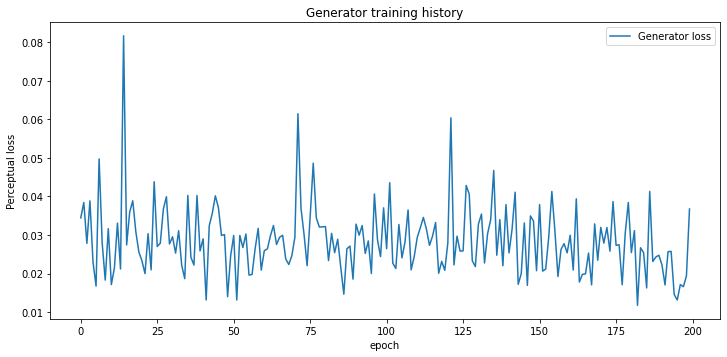

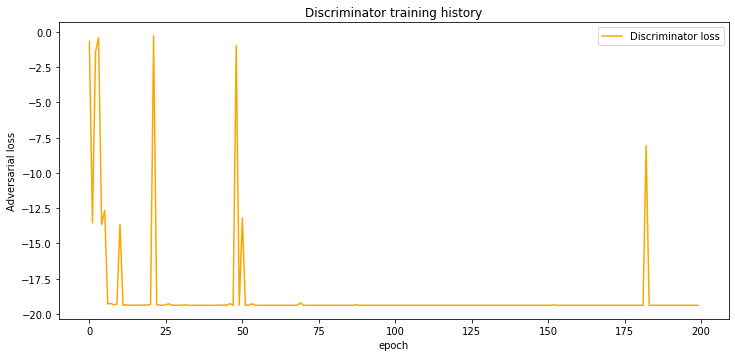


Total computing time:  7 hrs 41 mins 55 secs


In [7]:
# Define path towards directory containing the processed images
input_path = "data/train/LR/down_factor_x32"
target_path = "data/train/LR/down_factor_x4"

# Define number of epochs
epochs = 200

# Define starting epoch number
start_epoch = 1

# Define DataLoader parameters
batch_size = 3
num_workers = 0
pin_memory = False

# Define frequency of print statements (i.e. every how many epochs to print training progress)
print_checkpoint = 10

# Define checkpoint (i.e. number of epochs after which the model will be saved)
checkpoint = 50

# Define Generator parameters
in_out_kernel_size = 9
mid_kernel_size = 3
num_channels_g = 64
num_blocks_g = 16

# Use pre-trained Generator? (using the trained SRResNet)
pretrained_generator = True
srresnet_checkpoint_path = 'models/SRResNet/SRResNet_500.pt'

# Define learning rate
lr = 0.0001

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True
    
# Generate dataset
train = ProcessedDataset(input_path, target_path, rotation=True, warping=True)

# Load dataset
train_loader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

# Calculate scaling factor based on input and target images shapes
#   Grab the first sample to extract LR and HR images dimensions 
for lr_imgs, hr_imgs in train_loader:
    break
#   Calculate corresponding scaling factor
scaling_factor = int(hr_imgs.shape[2]/lr_imgs.shape[2])
  
# Initialize Generator
#   Create instance of Generator
generator = Generator(in_out_kernel_size=in_out_kernel_size,
                      mid_kernel_size=mid_kernel_size,
                      num_channels=num_channels_g,
                      num_blocks=num_blocks_g,
                      scaling_factor=scaling_factor).to(device)
#   Initialize Generator using weights from pre-trained SRResNet
if pretrained_generator:    
    generator.srresnet_init(srresnet_checkpoint_path=srresnet_checkpoint_path)

# Initialize Discriminator
discriminator = Discriminator().to(device)

# Loss functions
feature_extractor = FeatureExtractor(torchvision.models.vgg19(pretrained=True)).to(device)
#   Define Content loss
content_criterion = nn.MSELoss().to(device)
#   Define Adversarial loss
adversarial_criterion = nn.BCELoss().to(device)
#   Initialize mean epoch losses tracker
mean_epoch_generator_loss = []
mean_epoch_discriminator_loss = []

# Iniatialize optimizers
optimizer_g = torch.optim.Adam(generator.parameters(), lr=lr)
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=lr)

# Initialize time tracker
start_time = time()

# Train SRGAResNet model
print('SRGAResNet training in progress')
for epoch in range(start_epoch, epochs+1):
    
    # Initialize mean sample losses tracker
    mean_sample_generator_loss = []
    mean_sample_discriminator_loss = []
    
    # Loop through training samples
    for lr_imgs, hr_imgs in train_loader:
                
        # Assign images to available device ('cuda' or 'cpu')
        hr_imgs = Variable(hr_imgs).to(device)
        lr_imgs = Variable(lr_imgs).to(device)        
        
        # Pass low resolution images through Generator
        sr_imgs = generator(lr_imgs)
        
        # Pass images through discriminator
        hr_labels = discriminator(hr_imgs)
        sr_labels = discriminator(Variable(sr_imgs.data))
        
        # Generate targets
        hr_target = Variable(torch.ones_like(hr_labels)*0.5+0.7).to(device)
        sr_target = Variable(torch.ones_like(sr_labels)*0.3).to(device)
        
        # DISCRIMINATOR UPDATE
        discriminator.zero_grad()
        #   Calculate adversarial loss
        hr_discriminator_loss = adversarial_criterion(hr_labels, hr_target)
        sr_discriminator_loss = adversarial_criterion(sr_labels, sr_target)
        discriminator_loss = hr_discriminator_loss + sr_discriminator_loss
        #   Append loss to mean sample loss tracker
        mean_sample_discriminator_loss.append(discriminator_loss.item())
        #   Update parameters
        discriminator_loss.backward()
        optimizer_d.step()
        
        # GENERATOR UPDATE
        generator.zero_grad()
        #   Define feature maps
        hr_features = Variable(feature_extractor(hr_imgs).data)
        sr_features = feature_extractor(sr_imgs)
        #   Calculate content loss
        generator_content_loss = content_criterion(sr_imgs, hr_imgs) + 0.006*content_criterion(sr_features, hr_features)
        #   Calculate generator adversarial loss
        generator_adversarial_loss = adversarial_criterion(discriminator(sr_imgs),
                                                           Variable(torch.ones_like(discriminator(sr_imgs))).to(device))
        #   Calculate perceptual loss
        generator_loss = generator_content_loss + 1e-3*generator_adversarial_loss
        #   Append loss to mean sample loss tracker
        mean_sample_generator_loss.append(generator_loss.item())
        #   Update parameters
        generator_loss.backward()
        optimizer_g.step()
        
        # Delete current samples to save memory
        del lr_imgs, hr_imgs, sr_imgs, hr_labels, sr_labels, hr_target, sr_target
        
    # Append losses to mean epoch losses tracker
    mean_epoch_generator_loss.append(generator_loss.item())
    mean_epoch_discriminator_loss.append(discriminator_loss.item())   
    
    # Print update statement for tracking
    if epoch == 1 or epoch%print_checkpoint == 0:
        current_time = time() - start_time
        print(f'\033[1mCompleted epochs:\033[0m {epoch:4.0f}/{epochs} | '
              f'\033[1mGenerator loss:\033[0m {generator_loss.item():.2e} | '
              f'\033[1mDiscriminator loss:\033[0m {discriminator_loss.item():.2e} | '
              f'\033[1mTime elapsed:\033[0m {current_time//3600:2.0f} hrs '
              f'{(current_time - current_time//3600*3600)//60:2.0f} mins '
              f'{current_time%60:2.0f} secs')

    # Save model every checkpoint
    if  epoch%checkpoint == 0:
        #   Define current model state using dictionary
        model_state = {'epoch': epoch,
                       'generator': generator,
                       'discriminator': discriminator,
                       'optimizer_g': optimizer_g,
                       'optimizer_d': optimizer_d}
        #   Save current model
        torch.save(model_state, 'models/SRGAResNet/Implementation 3/SRGAResNet_' + str(epoch) + '.pt')
        # Generate losses history DataFrame
        losses_history = pd.DataFrame(np.transpose([mean_epoch_generator_loss,
                                      mean_epoch_discriminator_loss]),
                                      columns=['Generator loss', 'Discriminator loss'])
        # Save loss history
        losses_history.to_csv('history/SRGAResNet/Implementation 3/SRGAResNet_' + str(epoch) + '.csv')
        #   Print save statement
        print(f'\n\tCheckpoint -> Model saved at {epoch:4.0f}/{epochs} epochs\n')

# Save final model
#   Define current model state using dictionary
model_state = {'epoch': epoch,
               'generator': generator,
               'discriminator': discriminator,
               'optimizer_g': optimizer_g,
               'optimizer_d': optimizer_d}
#   Save current model
torch.save(model_state, 'models/SRGAResNet/Implementation 3/SRGAResNet_' + str(epoch) + '.pt')

# Generate losses history DataFrame
losses_history = pd.DataFrame(np.transpose([mean_epoch_generator_loss,
                              mean_epoch_discriminator_loss]),
                              columns=['Generator loss', 'Discriminator loss'])

# Save loss history
losses_history.to_csv('history/SRGAResNet/Implementation 3/SRGAResNet_' + str(epoch) + '.csv')

# Plot training history
#   Generator
plt.subplot(211)
losses_history['Generator loss'].plot(figsize=(12,12))
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Perceptual loss')
plt.legend()
plt.title('Generator training history')
plt.show()
#   Discriminator
plt.subplot(212)
losses_history['Discriminator loss'].plot(figsize=(12,12), c='orange')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('Adversarial loss')
plt.legend()
plt.title('Discriminator training history')
plt.show()

# Print total computing time
total_time = time() - start_time
print(f'\033[1m\nTotal computing time:\033[0m {total_time//3600:2.0f} hrs '
      f'{(total_time - total_time//3600*3600)//60:2.0f} mins '
      f'{total_time%60:2.0f} secs')

## Implementation #3: Evaluation

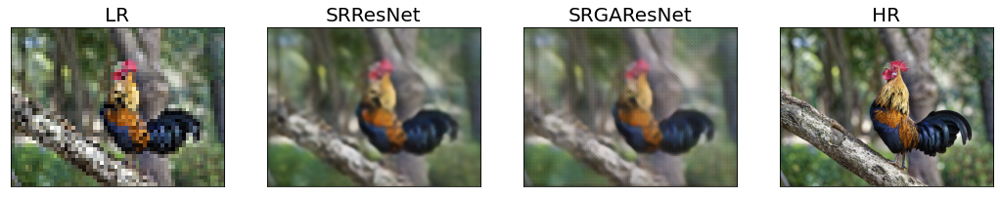

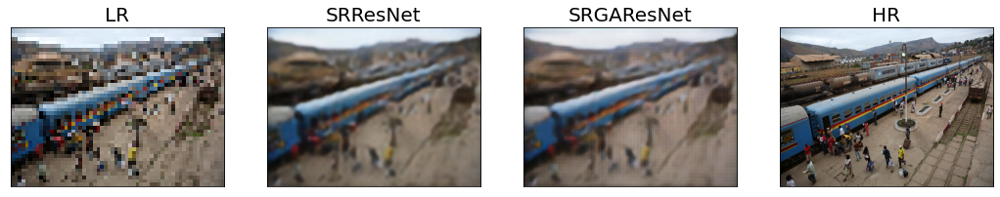

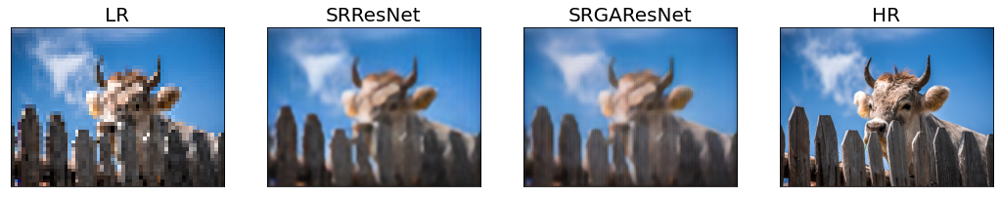

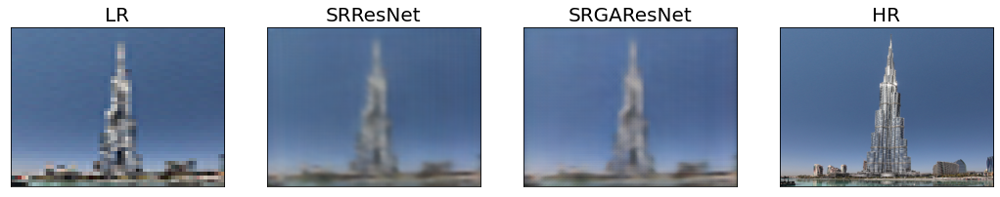

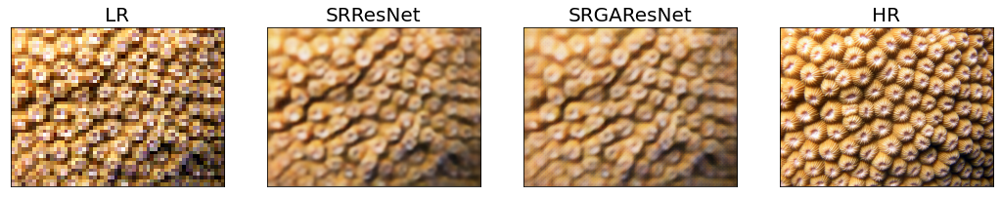

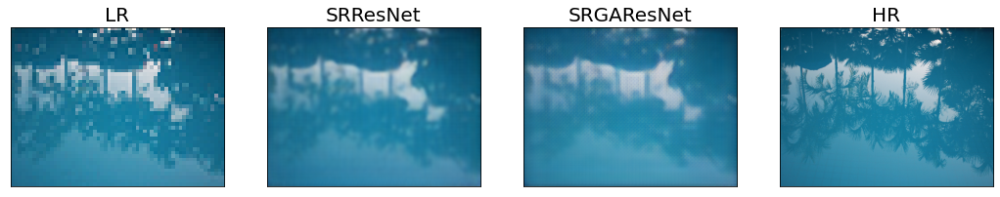

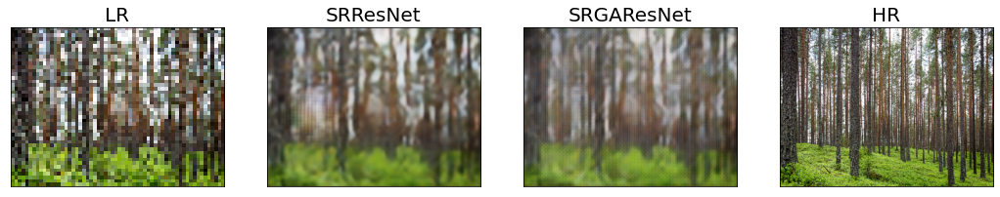

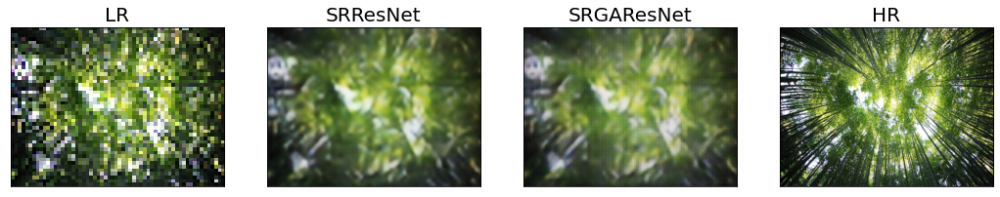

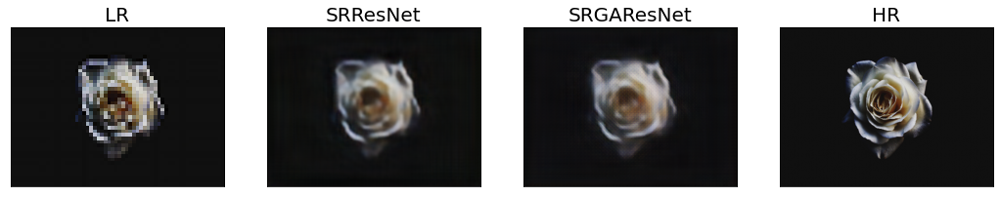

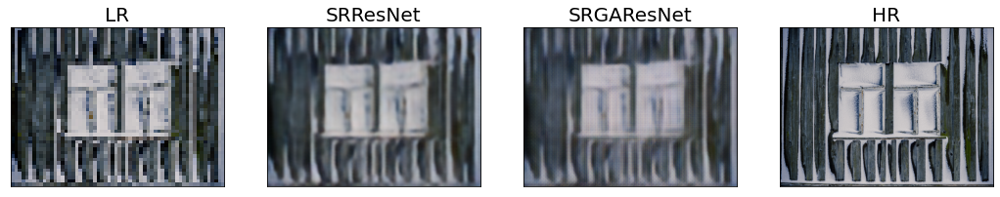

In [8]:
# Define paths towards low (input) and high (target) resolution images
lr_path = "data/train/LR/down_factor_x32"
hr_path = "data/train/LR/down_factor_x4"

# Define paths to models
srresnet_path = "models/SRResNet/SRResNet_500.pt"
srgaresnet_path = "models/SRGAResNet/Implementation 3/SRGAResNet_200.pt"

# Define number of images to test
test_size = 10

# Assign device to 'cuda' if available, or to 'cpu' otherwise
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Enable cudnn benchmark, which allows cudnn to look for the optimal set of algorithms for the current device configuration
cudnn.benchmark = True

# Generate lists of filenames for all images and labels contained within corresponding directories (with full path)
lr_files = list(map(lambda lr_file: os.path.join(lr_path, lr_file), sorted(os.listdir(lr_path))))
hr_files = list(map(lambda hr_file: os.path.join(hr_path, hr_file), sorted(os.listdir(hr_path))))

# Define indices of random samples based on number of testing images
idx_list = np.random.randint(0, len(lr_files), test_size)

# Load models
srresnet = torch.load(srresnet_path)['model'].to(device)
srgaresnet = torch.load(srgaresnet_path)['generator'].to(device)

# Set models to evaluation mode
srresnet.eval()
srgaresnet.eval()

# Loop through testing images
for lr_file, hr_file in np.transpose([lr_files, hr_files])[idx_list]:
    
    # Read low (input) and high (target) resolution images
    lr_img = io.imread(lr_file)/255.0
    hr_img = io.imread(hr_file)/255.0
    
    # Resize to defined fixed shapes
    lr_img = cv2.resize(lr_img,
                        dsize=(int(resize_height/downsampling_factor), int(resize_width/downsampling_factor)),
                        interpolation=cv2.INTER_CUBIC) 
    hr_img = cv2.resize(hr_img,
                        dsize=(resize_height, resize_width),
                        interpolation=cv2.INTER_CUBIC) 

    # Convert low (input) and high (target) resolution images from numpy.ndarray to torch.FloatTensor format
    lr_img_tensor = torch.FloatTensor(lr_img).permute(2,0,1)[:3,:,:].unsqueeze(0).to(device)
    hr_img_tensor = torch.FloatTensor(hr_img).permute(2,0,1)[:3,:,:].unsqueeze(0).to(device)
    
    # Apply models to low resolution image
    sr_srresnet = srresnet(lr_img_tensor)
    sr_srgaresnet = srgaresnet(lr_img_tensor)

    # Convert super resolution images to image format
    sr_srresnet = sr_srresnet.squeeze(0).cpu().detach().permute(1,2,0)
    sr_srgaresnet = sr_srgaresnet.squeeze(0).cpu().detach().permute(1,2,0)
    
    # Normalize pixel values between 0 and 1
    lr_img = np.clip(lr_img, 0, 1)
    hr_img = np.clip(hr_img, 0, 1)
    sr_srresnet = np.clip(sr_srresnet, 0, 1)
    sr_srgaresnet = np.clip(sr_srgaresnet, 0, 1)
    
    # Display low, super (SRResNet and SRGAResNet) and high resolution images
    plt.figure(figsize=(18,8))
    
    plt.subplot(141)
    plt.imshow(lr_img, cmap='gray')
    plt.title('LR', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(142)
    plt.imshow(sr_srresnet, cmap='gray')
    plt.title('SRResNet', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(143)
    plt.imshow(sr_srgaresnet, cmap='gray')
    plt.title('SRGAResNet', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    
    plt.subplot(144)
    plt.imshow(hr_img, cmap='gray')
    plt.title('HR', fontsize=20)
    ax = plt.gca()
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

## Implementation 3: Conclusions

### SRGAResNet

**Training**

The Generator of the SRGAResNet was loaded with the pre-trained weights of the SRResNet. Similarly to Implementation #2, no clear additional learning was observed as the resulting losses (Generator and Discriminator) did not show any sign of progressive decrease.

**Evaluation**

Similarly to Implementation #2, the super-resolution images generated by this new SRGAResNet were closer to the expected outcome. However, no clear improvements were observed when compared to the single SRResNet.

___
# References

[1] Ledig C, Theis L, Huszar F, Caballero J, Cunningham A, Acosta A, Aitken A, Tejani A, Totz J, Wang Z, Shi W. Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network. arXiv:1609.04802, 2017 (https://arxiv.org/abs/1609.04802)

[2] He K, Zhang X, Ren S, Sun J.Deep Residual Learning for Image Recognition. arXiv:1512.03385v1, 2015 (https://arxiv.org/abs/1512.03385)

[3] Goodfellow IJ, Pouget-Abadie J, Mirza M, Xu B, Warde-Farley D, Ozair S, Courville A, Bengio Y. Generative Adversarial Nets. arXiv:1406.2661v1, 2014 (https://arxiv.org/abs/1406.2661)

[4] Johnson J, Alahi A, Fei-Fei L. Perceptual Losses for Real-Time Style Transfer and Super-Resolution. arXiv:1603.08155v1, 2016 (https://arxiv.org/abs/1603.08155)

[5] Bruna J, Sprechmann P, LeCun Y. Super-Resolution with Deep Convolutional Sufficient Statistics. arXiv:1511.05666v4, 2016 (https://arxiv.org/abs/1511.05666)

[6] Simonyan K, Zisserman A. Very Deep Convolutional Networks for Large-Scale Image Recognition. arXiv:1409.1556v6, 2015 (https://arxiv.org/abs/1409.1556)